### Final Project : Deep Reinforcement Learning Extended

### Stanley Chou RUID:193005065 , Anis Chihoub, Sunny Chen
### Due: 12/16/2022

#1 Imports and Making sure the Environment Works

In [14]:
import gym

# Import retro to play Street Fighter using a ROM
import retro
# Import time to slow down game
import time
import torch
#import google drive from colab in order to avoid reuploading


# See the different retro games
#retro.data.list_games()

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [15]:
print(device)

cuda


In [16]:
#General Imports

import math
import random
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
from IPython import display as ipythondisplay
from collections import namedtuple, deque
from itertools import count
from PIL import Image
from gym.wrappers import Monitor
from gym.wrappers.monitoring.video_recorder import VideoRecorder
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
import torchvision.transforms as T

import math
import glob
import io
import base64
from IPython.display import HTML

In [17]:
#load our environment
env = retro.make(game= 'StreetFighterIISpecialChampionEdition-Genesis')



In [18]:
"""
Utility functions to enable video recording of gym environment and displaying it
To enable video, just do "env = wrap_env(env)""
"""

def show_video():
  mp4list = glob.glob('video/*.mp4')
  if len(mp4list) > 0:
    mp4 = mp4list[0]
    video = io.open(mp4, 'r+b').read()
    encoded = base64.b64encode(video)
    ipythondisplay.display(HTML(data='''<video alt="test" autoplay 
                loop controls style="height: 400px;">
                <source src="data:video/mp4;base64,{0}" type="video/mp4" />
             </video>'''.format(encoded.decode('ascii'))))
  else: 
    print("Could not find video")
    

def wrap_env(env):
  env = Monitor(env, './video', force=True)
  return env

In [19]:
#let's us see the dimension of the screen
env.observation_space.sample()

array([[[243, 184,  70],
        [127,  37, 163],
        [ 42,  99, 204],
        ...,
        [ 52, 204, 146],
        [132,  61, 137],
        [128, 199, 145]],

       [[ 57, 245,  94],
        [199, 116, 178],
        [189,  89, 247],
        ...,
        [ 34, 170, 141],
        [ 29, 224, 247],
        [152,  32, 179]],

       [[204, 163,  50],
        [ 22, 254, 187],
        [  5,  96, 232],
        ...,
        [ 24, 183, 227],
        [140,  68, 110],
        [187,  33,  42]],

       ...,

       [[ 99, 233, 121],
        [201, 130, 239],
        [194, 149, 137],
        ...,
        [205,  41, 141],
        [ 61, 253, 222],
        [  6, 236,  95]],

       [[ 47, 197, 109],
        [110,  17,  43],
        [ 30, 236, 194],
        ...,
        [210, 194, 213],
        [102, 230,  65],
        [209, 216, 230]],

       [[208,  40,  98],
        [ 38, 146,  70],
        [140,  92, 179],
        ...,
        [215, 177, 156],
        [223, 157, 242],
        [182,  20,  73]]

In [20]:
env.observation_space

Box([[[0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 ...

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]]], [[[255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  ...
 

In [21]:
#view the actions that we are working with
#12 actions correspond to the 12 buttons we can press while playing street fighter
env.action_space.sample()



array([0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0], dtype=int8)

In [22]:
env.close()
env = wrap_env(retro.make(game= 'StreetFighterIISpecialChampionEdition-Genesis'))

C:\Users\stanl\anaconda3\envs\downgrade\lib\site-packages\gym\wrappers\monitor.py:86: UserWarning: WARN: Trying to monitor an environment which has no 'spec' set. This usually means you did not create it via 'gym.make', and is recommended only for advanced users.
  logger.warn(


In [23]:
#Testing to see if the environment is correct, this demo just has the Agent randomly moving
# Reset game to starting state
obs = env.reset()
# Set flag to flase
done = False
for game in range(1): 
    while not done: 
        if done: 
            obs = env.reset()
        screen = env.render(mode='rgb_array')
        obs, reward, done, info = env.step(env.action_space.sample())
        time.sleep(0.01)
        #print(reward)



env.close()
show_video()     


In [24]:
#what the info for this game is, from this we can see that we can take score and health and enemy health to create a reward function
info

{'enemy_matches_won': 2,
 'score': 9000,
 'matches_won': 0,
 'continuetimer': 10,
 'enemy_health': 0,
 'health': 0}

#2 Preprocessing and Making the Model

# Need to add preprocessing - grey scale the screen, get the frame differences currentscreen -last screen, possibly downsize the data
#adjust the reward function to make it less sparse - and make it equal to the score of the game + the health you take away from the opponent, and minus the health you lose

In [25]:


# Import the space shapes for the environment
from gym import spaces
from gym.spaces import MultiBinary, Box
# Import numpy to calculate frame delta 
import numpy as np
# Import opencv for grayscaling
import cv2




     


In [26]:
##Snippet of code for testing preprocessing image values, allows us to see what the image is that we are creating from altering it
gray = cv2.cvtColor(obs, cv2.COLOR_BGR2GRAY)
resize = cv2.resize(gray, (128,128), interpolation=cv2.INTER_CUBIC)
channels = np.reshape(resize, (128,128,1))

In [27]:
channels.shape

(128, 128, 1)

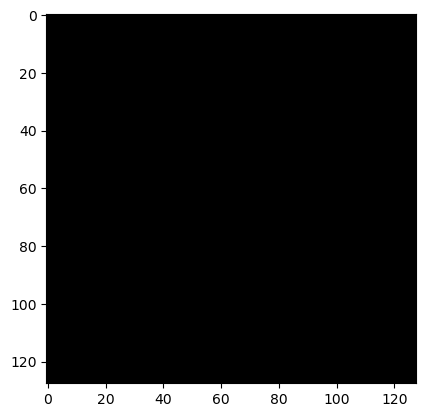

In [28]:
plt.imshow(cv2.cvtColor(channels, cv2.COLOR_BGR2RGB))

In [29]:
#The custom environment is necessarry for us to implement our own loss functions

# Create custom environment 
class StreetFighter(gym.Env): 
    def __init__(self):
        super().__init__()
        # Specify action space and observation space 
        #The dimensions for the game environment itself is this in gray scale)
        self.observation_space = Box(low=0, high=255, shape=(64, 64, 1), dtype=np.uint8)
        #12 possible button presses on the fighting controller hence multibinary 12
        self.action_space = MultiBinary(12)
        # Startup and instance of the game 
        #the filter parameter forces the agent to only use valid button combinations e.g no passing [1,1,1,1,1,1,1,1,1,1,1,1] as the action vector and getting something 
        # (this example vector is equivalent to a person holding all the buttons on the arcade box controller and inputting all 4 directions at the same time which is impossible and does nothing so don't do it)
        self.game = retro.make(game='StreetFighterIISpecialChampionEdition-Genesis', use_restricted_actions = retro.Actions.FILTERED)
    
    def reset(self):
        # Return the first frame 
        obs = self.game.reset()
        obs = self.preprocess(obs) 
        #reset state so the previous frame in this case is the initial frame
        self.previous_frame = obs 
        
        # Create a attribute to hold the score delta 
        self.score = 0 
        # Create a attribute to hold the Player Health delta
        self.health = 176 
        # Create a attribute to hold the Enemy Health delta The default health for characters at each round is 176
        self.enemy_health = 176
        self.matches_won = 0
        self.enemy_matches_won = 0
        return obs
    
    #Grayscaling and resizing the image to improve training time since we are poor and need computations to be easy
    #Original image is 200x256x3 so we are turning it into a grayscale image of half the y dimension 128x128x1 (originally we did 100x128x1 but for some reason square images looked and did better)
    def preprocess(self, observation): 
        # Grayscaling the frame
        gray = cv2.cvtColor(observation, cv2.COLOR_BGR2GRAY)
        # Resize (128x128)
        resize = cv2.resize(gray, (64,64), interpolation=cv2.INTER_CUBIC)
        # Add the channels value (128x128z1)
        channels = np.reshape(resize, (64,64,1))
        #print(channels.shape)
        return channels
    
    def step(self, action): 
        # Take a step 
        obs, reward, done, info = self.game.step(action)
        #preprocess the new game frame
        obs = self.preprocess(obs) 
        
        # Frame delta newframe - old frame
        frame_delta = obs - self.previous_frame
        #print(frame_delta.shape)
        self.previous_frame = obs 
        
        # Reshape the reward function ################################################################## This is where we adjust the game reward
        score_delta = info['score'] - self.score 
        health_delta = info['health'] - self.health
        enemy_health_delta = info['enemy_health'] - self.enemy_health
        reward = score_delta + 50*health_delta - 50*enemy_health_delta
        # add 500 for win - 500 for loss 
        if (self.matches_won != info['matches_won'] and info['matches_won'] != 0):
            reward = reward + 500
        if (self.enemy_matches_won != info['enemy_matches_won'] and info['enemy_matches_won'] != 0):
            reward = reward - 500
        
        #reward function losing health is bad hurting the enemy is good, getting points is good
        self.score = info['score'] 
        self.health = info['health']
        self.enemy_health = info['enemy_health']
        self.matches_won = info['matches_won']
        self.enemy_matches_won = info['enemy_matches_won']
        return frame_delta, reward, done, info
    
    #functions for rendering the game as an mp4 and for closing the game
    def render(self, *args, **kwargs):
        self.game.render()
        
    def close(self):
        self.game.close()



     


#Testing Custom Environment space

In [30]:
#path to save test recording to
before_training = "before_training.mp4"
#close the old environment before making a new one
env.close()
env = StreetFighter()
#set up video recording on the game, monitor did not work for our custom environment so for the custom implementation we use video recorder instead
#function takes the game environment to record and the file path as the second input


In [31]:
env.observation_space.shape

(64, 64, 1)

In [32]:
env.action_space.shape

(12,)

In [149]:
#Testing to see if the environment is correct, this demo just has the Agent randomly moving
# Reset game to starting state
obs = env.reset()
# Set flag to flase
done = False
for game in range(1): 
    while not done: 
        if done: 
            obs = env.reset()
        env.render(mode='rgb_array')
        #capture frame

        obs, reward, done, info = env.step(env.action_space.sample())
        time.sleep(0.01)
        #print(reward)
        if reward != 0:
          print(reward)

#end video recording

env.close()


1680
300
1260
100
-1920
-1840
2160
500
2160
500
-1840
-2400
1000
2100
500
1140
400
120
1500
100
100
100
100
100
100
100
100
100
1000
1000
1000
10000
-6140
3520
-1840
1000
1740
500
-1920
420
-1920
1680
300
360
100
360
100
1740
500
-800
1740
500
600
-2000
1000
360
-1920
900
100
-2880
120
600
3000
100
100
100
100
100
100
100
100
100
100
100
100
100
-860
3520
2220
500
2160
500
-2080
1080
100
2100
500
-2000
-2160
-2080
-2800
-1760
-1280
3080
3520
960
100
-1920
-2000
-3920
1440
300
1560
100
1440
100
1000
-2000
-2080
-2240
5240


In [21]:
#code to display results

from base64 import b64encode
def render_mp4(videopath: str) -> str:
  mp4 = open(videopath, 'rb').read()
  base64_encoded_mp4 = b64encode(mp4).decode()

In [22]:

from IPython.display import HTML
html = render_mp4(before_training)
HTML(html)

<IPython.core.display.HTML object>

In [23]:
from IPython.display import HTML
from base64 import b64encode
mp4 = open(before_training,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

#Creating Model


### 2.5 Automated Hyper Parameter Tuning



In [33]:
#!pip install stable-baselines3[extra] optuna

In [34]:

# Importing the optimzation frame - HPO
import optuna
# PPO algo for RL. Proximal Policy Optimization shown to work better 
from stable_baselines3 import PPO

# Bring in the eval policy method for metric calculation
from stable_baselines3.common.evaluation import evaluate_policy
# Import the sb3 monitor for logging 
from stable_baselines3.common.monitor import Monitor
# Import the vec wrappers to vectorize and frame stack
from stable_baselines3.common.vec_env import DummyVecEnv, VecFrameStack
# Import os to deal with filepaths
import os

In [35]:
#directories to store models so that we can save each increment model
LOG_DIR = './logs2/'
OPT_DIR = './opt2/'

In [161]:
# Function to return test hyperparameters - define the object function
#Optuna as a library allows us to suggest hyper parameters we would like to train our model with
# these 5 hyper parameters are the parameters needed for the PPO (Proximal Policy Optimization Algorithm)
# Through some research we read the DQN provided unstable results, and this was shown in what we got from it
# PPO is also less memory intensive and should train afaster
def optimize_ppo(trial): 
    return {
        #ppo wants steps to be a multiple of 64 to work well
        'n_steps':trial.suggest_int('n_steps', 2048, 8192),
        'gamma':trial.suggest_loguniform('gamma', 0.8, 0.9999),
        'learning_rate':trial.suggest_loguniform('learning_rate', 1e-5, 1e-4),
        'clip_range':trial.suggest_uniform('clip_range', 0.1, 0.4),
        'gae_lambda':trial.suggest_uniform('gae_lambda', 0.8, 0.99)
    }

In [37]:
SAVE_PATH = os.path.join(OPT_DIR, 'trial_{}_best_modelv2.1'.format(1))

In [168]:
env.close()




In [169]:
def optimize_agent(trial):
    #env.close()
    #try:
    model_params = optimize_ppo(trial) 

    # Create environment 
    env = StreetFighter()
    #Monitor allows us to extract reward and other information from the game in a vectorized form
    env = Monitor(env, LOG_DIR)
    env = DummyVecEnv([lambda: env])
    #frame stack of size 4 is the standard for atari games helps you consider velocity of objects and other things that 
    # 1 frame difference cannot observe like we did in our DQN implementation
    env = VecFrameStack(env, 4, channels_order='last')

    # Create algo 
    #PPO using CNNs , takes the game environment, logs information to the LOG_DIR , lot's of trials so we don't want prints, and it takes the  generated model params
    model = PPO('CnnPolicy', env, tensorboard_log=LOG_DIR, verbose=0, **model_params)
    #short training time because we need results fast
    model.learn(total_timesteps = 75000)
    #model.learn(total_timesteps=100000)

    # Evaluate model 
    # evaluate the model on 5 games of Street Fighter
    mean_reward, _ = evaluate_policy(model, env, n_eval_episodes=10)
    env.close()

    #Saves the best hyper parameters the ones that created the best model for full training later
    SAVE_PATH = os.path.join(OPT_DIR, 'trial_{}_best_model'.format(trial.number))
    model.save(SAVE_PATH)

    return mean_reward
    #Any errors we don't want the hyper parameters to crash and waste training time so -1000 just let's us skip parameters that
    #are generated by Optuna that cause errors
    #except Exception as e:
        #return -1000

In [170]:
# Creating the experiment 
# creates the optuna automated hyper parameter testing experiment
study = optuna.create_study(direction='maximize')
# n_trials means we are only trying 10 sets of values in that range, realistically we would try more sets and train longer
#but we simply lack the time to do that currently
study.optimize(optimize_agent, n_trials = 50, n_jobs=1)

#for when we have time to train it faster
#study.optimize(optimize_agent, n_trials=100, n_jobs=1)

[I 2022-12-14 18:34:49,397] A new study created in memory with name: no-name-5e8edd8c-d659-4f8d-b02f-1fccf64edfa9
C:\Users\stanl\AppData\Local\Temp\ipykernel_11228\2078727934.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'gamma':trial.suggest_loguniform('gamma', 0.8, 0.9999),
C:\Users\stanl\AppData\Local\Temp\ipykernel_11228\2078727934.py:11: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :func:`~optuna.trial.Trial.suggest_float` instead.
  'learning_rate':trial.suggest_loguniform('learning_rate', 1e-5, 1e-4),
C:\Users\stanl\AppData\Local\Temp\ipykernel_11228\2078727934.py:12: FutureWarning: suggest_uniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://g

C:\Users\stanl\anaconda3\envs\downgrade\lib\site-packages\stable_baselines3\ppo\ppo.py:151: UserWarning: You have specified a mini-batch size of 64, but because the `RolloutBuffer` is of size `n_steps * n_envs = 3311`, after every 51 untruncated mini-batches, there will be a truncated mini-batch of size 47
We recommend using a `batch_size` that is a factor of `n_steps * n_envs`.
Info: (n_steps=3311 and n_envs=1)
  warnings.warn(
[I 2022-12-14 19:42:24,397] Trial 9 finished with value: -700.0 and parameters: {'n_steps': 3311, 'gamma': 0.9391282848114967, 'learning_rate': 4.6191141530385765e-05, 'clip_range': 0.33946304643691394, 'gae_lambda': 0.804965558713063}. Best is trial 5 with value: 2500.0.
C:\Users\stanl\anaconda3\envs\downgrade\lib\site-packages\stable_baselines3\ppo\ppo.py:151: UserWarning: You have specified a mini-batch size of 64, but because the `RolloutBuffer` is of size `n_steps * n_envs = 6631`, after every 103 untruncated mini-batches, there will be a truncated mini-ba

[I 2022-12-14 20:59:37,786] Trial 20 finished with value: 1500.0 and parameters: {'n_steps': 7196, 'gamma': 0.846225041509972, 'learning_rate': 2.608878231959919e-05, 'clip_range': 0.3967750781861148, 'gae_lambda': 0.9891395883140651}. Best is trial 18 with value: 3200.0.
C:\Users\stanl\anaconda3\envs\downgrade\lib\site-packages\stable_baselines3\ppo\ppo.py:151: UserWarning: You have specified a mini-batch size of 64, but because the `RolloutBuffer` is of size `n_steps * n_envs = 7321`, after every 114 untruncated mini-batches, there will be a truncated mini-batch of size 25
We recommend using a `batch_size` that is a factor of `n_steps * n_envs`.
Info: (n_steps=7321 and n_envs=1)
  warnings.warn(
[I 2022-12-14 21:07:14,109] Trial 21 finished with value: -1000.0 and parameters: {'n_steps': 7321, 'gamma': 0.8901866415668753, 'learning_rate': 2.283534707382395e-05, 'clip_range': 0.1991889030328022, 'gae_lambda': 0.95816993419541}. Best is trial 18 with value: 3200.0.
C:\Users\stanl\anaco

C:\Users\stanl\anaconda3\envs\downgrade\lib\site-packages\stable_baselines3\ppo\ppo.py:151: UserWarning: You have specified a mini-batch size of 64, but because the `RolloutBuffer` is of size `n_steps * n_envs = 4148`, after every 64 untruncated mini-batches, there will be a truncated mini-batch of size 52
We recommend using a `batch_size` that is a factor of `n_steps * n_envs`.
Info: (n_steps=4148 and n_envs=1)
  warnings.warn(
[I 2022-12-14 22:21:00,174] Trial 32 finished with value: -1000.0 and parameters: {'n_steps': 4148, 'gamma': 0.9819925515391749, 'learning_rate': 7.80383265608944e-05, 'clip_range': 0.31315681964761444, 'gae_lambda': 0.8668562382314097}. Best is trial 18 with value: 3200.0.
C:\Users\stanl\anaconda3\envs\downgrade\lib\site-packages\stable_baselines3\ppo\ppo.py:151: UserWarning: You have specified a mini-batch size of 64, but because the `RolloutBuffer` is of size `n_steps * n_envs = 4927`, after every 76 untruncated mini-batches, there will be a truncated mini-b

[I 2022-12-14 23:35:47,780] Trial 43 finished with value: 1700.0 and parameters: {'n_steps': 7816, 'gamma': 0.9027577959856818, 'learning_rate': 2.0872764858314345e-05, 'clip_range': 0.3301174673113333, 'gae_lambda': 0.9215985223031484}. Best is trial 18 with value: 3200.0.
C:\Users\stanl\anaconda3\envs\downgrade\lib\site-packages\stable_baselines3\ppo\ppo.py:151: UserWarning: You have specified a mini-batch size of 64, but because the `RolloutBuffer` is of size `n_steps * n_envs = 7124`, after every 111 untruncated mini-batches, there will be a truncated mini-batch of size 20
We recommend using a `batch_size` that is a factor of `n_steps * n_envs`.
Info: (n_steps=7124 and n_envs=1)
  warnings.warn(
[I 2022-12-14 23:43:52,597] Trial 44 finished with value: 10500.0 and parameters: {'n_steps': 7124, 'gamma': 0.9893909492616225, 'learning_rate': 3.30789596371927e-05, 'clip_range': 0.3808649577780686, 'gae_lambda': 0.8863852538528693}. Best is trial 44 with value: 10500.0.
C:\Users\stanl\a

In [171]:
study.best_params

{'n_steps': 8186,
 'gamma': 0.9753191725012723,
 'learning_rate': 2.753486549734521e-05,
 'clip_range': 0.35428362345062175,
 'gae_lambda': 0.8614386816315859}

In [172]:
study.best_trial

FrozenTrial(number=46, values=[13500.0], datetime_start=datetime.datetime(2022, 12, 14, 23, 50, 13, 692497), datetime_complete=datetime.datetime(2022, 12, 14, 23, 59, 19, 418110), params={'n_steps': 8186, 'gamma': 0.9753191725012723, 'learning_rate': 2.753486549734521e-05, 'clip_range': 0.35428362345062175, 'gae_lambda': 0.8614386816315859}, distributions={'n_steps': IntDistribution(high=8192, log=False, low=2048, step=1), 'gamma': FloatDistribution(high=0.9999, log=True, low=0.8, step=None), 'learning_rate': FloatDistribution(high=0.0001, log=True, low=1e-05, step=None), 'clip_range': FloatDistribution(high=0.4, log=False, low=0.1, step=None), 'gae_lambda': FloatDistribution(high=0.99, log=False, low=0.8, step=None)}, user_attrs={}, system_attrs={}, intermediate_values={}, trial_id=46, state=TrialState.COMPLETE, value=None)

In [173]:
model = PPO.load(os.path.join(OPT_DIR, 'trial_46_best_model.zip'))

## 3 Training and Testing

In [7]:
# Import base callback 
from stable_baselines3.common.callbacks import BaseCallback

In [8]:
class TrainAndLoggingCallback(BaseCallback):

    def __init__(self, check_freq, save_path, verbose=1):
        super(TrainAndLoggingCallback, self).__init__(verbose)
        self.check_freq = check_freq
        self.save_path = save_path

    def _init_callback(self):
        if self.save_path is not None:
            os.makedirs(self.save_path, exist_ok=True)

    def _on_step(self):
        if self.n_calls % self.check_freq == 0:
            model_path = os.path.join(self.save_path, 'best_model_{}'.format(self.n_calls))
            self.model.save(model_path)

        return True

In [41]:
#where we save the model, we save a model every 10000 steps
CHECKPOINT_DIR = './train2/'

In [11]:
callback = TrainAndLoggingCallback(check_freq=10000, save_path=CHECKPOINT_DIR)

In [38]:
# Create environment 
env.close()

env = StreetFighter()
env = Monitor(env, LOG_DIR)
env = DummyVecEnv([lambda: env])
env = VecFrameStack(env, 4, channels_order='last')

In [39]:
model_params = study.best_params
model_params

NameError: name 'study' is not defined

In [180]:
#ideally want a multiple of 64
multiple = 8186//64
multiple

127

In [181]:
model_params['n_steps'] = multiple * 64  # set n_steps to a factor of 64 related to what we found worked best
#set the learning rate to super small, supposedly this is around how low you need to set it for this problem
model_params['learning_rate'] = 2.753486549734521e-07 
model_params

{'n_steps': 8128,
 'gamma': 0.9753191725012723,
 'learning_rate': 2.753486549734521e-07,
 'clip_range': 0.35428362345062175,
 'gae_lambda': 0.8614386816315859}

In [43]:
model_params = {'n_steps': 8128,
 'gamma': 0.9753191725012723,
 'learning_rate': 2.753486549734521e-07,
 'clip_range': 0.35428362345062175,
 'gae_lambda': 0.8614386816315859}

In [44]:
#create model with these weights
model = PPO('CnnPolicy', env, tensorboard_log=LOG_DIR, verbose=1, **model_params)
#load up the best model taht was trained for some time already
#model.load(os.path.join(OPT_DIR, 'best_model_2010000.zip'))
model.load(os.path.join(CHECKPOINT_DIR, 'best_model_2010000.zip'))



Using cuda device
Wrapping the env in a VecTransposeImage.


In [45]:
model.learn(total_timesteps=10000000, callback=callback)

Logging to ./logs2/PPO_54
-----------------------------
| time/              |      |
|    fps             | 398  |
|    iterations      | 1    |
|    time_elapsed    | 20   |
|    total_timesteps | 8128 |
-----------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.36e+04     |
|    ep_rew_mean          | 5.14e+04     |
| time/                   |              |
|    fps                  | 326          |
|    iterations           | 2            |
|    time_elapsed         | 49           |
|    total_timesteps      | 16256        |
| train/                  |              |
|    approx_kl            | 8.845511e-07 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -8.32        |
|    explained_variance   | -4.65e-06    |
|    learning_rate        | 2.75e-07     |
|    loss                 | 9e+04        |
|    n_updates            | 10   

-------------------------------------------
| rollout/                |               |
|    ep_len_mean          | 1.02e+04      |
|    ep_rew_mean          | 3.85e+04      |
| time/                   |               |
|    fps                  | 284           |
|    iterations           | 11            |
|    time_elapsed         | 314           |
|    total_timesteps      | 89408         |
| train/                  |               |
|    approx_kl            | 2.7166973e-06 |
|    clip_fraction        | 0             |
|    clip_range           | 0.354         |
|    entropy_loss         | -8.32         |
|    explained_variance   | -4.27e-05     |
|    learning_rate        | 2.75e-07      |
|    loss                 | 1.06e+04      |
|    n_updates            | 100           |
|    policy_gradient_loss | -5.45e-05     |
|    value_loss           | 3.15e+04      |
-------------------------------------------
-------------------------------------------
| rollout/                |     

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.05e+04     |
|    ep_rew_mean          | 3.74e+04     |
| time/                   |              |
|    fps                  | 280          |
|    iterations           | 20           |
|    time_elapsed         | 579          |
|    total_timesteps      | 162560       |
| train/                  |              |
|    approx_kl            | 1.233555e-06 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -8.32        |
|    explained_variance   | -7.47e-05    |
|    learning_rate        | 2.75e-07     |
|    loss                 | 2.92e+05     |
|    n_updates            | 190          |
|    policy_gradient_loss | -2.41e-05    |
|    value_loss           | 3.31e+05     |
------------------------------------------
-------------------------------------------
| rollout/                |               |
|    ep_l

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.07e+04     |
|    ep_rew_mean          | 3.72e+04     |
| time/                   |              |
|    fps                  | 280          |
|    iterations           | 29           |
|    time_elapsed         | 840          |
|    total_timesteps      | 235712       |
| train/                  |              |
|    approx_kl            | 9.789813e-07 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -8.32        |
|    explained_variance   | -9.24e-05    |
|    learning_rate        | 2.75e-07     |
|    loss                 | 1.96e+04     |
|    n_updates            | 280          |
|    policy_gradient_loss | -2.09e-05    |
|    value_loss           | 3.16e+05     |
------------------------------------------
-------------------------------------------
| rollout/                |               |
|    ep_l

-------------------------------------------
| rollout/                |               |
|    ep_len_mean          | 1.06e+04      |
|    ep_rew_mean          | 3.49e+04      |
| time/                   |               |
|    fps                  | 277           |
|    iterations           | 38            |
|    time_elapsed         | 1112          |
|    total_timesteps      | 308864        |
| train/                  |               |
|    approx_kl            | 8.4074445e-06 |
|    clip_fraction        | 0             |
|    clip_range           | 0.354         |
|    entropy_loss         | -8.32         |
|    explained_variance   | -0.000651     |
|    learning_rate        | 2.75e-07      |
|    loss                 | 7.25e+04      |
|    n_updates            | 370           |
|    policy_gradient_loss | -7.78e-05     |
|    value_loss           | 1.09e+05      |
-------------------------------------------
-------------------------------------------
| rollout/                |     

-------------------------------------------
| rollout/                |               |
|    ep_len_mean          | 1.07e+04      |
|    ep_rew_mean          | 3.53e+04      |
| time/                   |               |
|    fps                  | 278           |
|    iterations           | 47            |
|    time_elapsed         | 1370          |
|    total_timesteps      | 382016        |
| train/                  |               |
|    approx_kl            | 4.6782898e-06 |
|    clip_fraction        | 0             |
|    clip_range           | 0.354         |
|    entropy_loss         | -8.32         |
|    explained_variance   | -0.000922     |
|    learning_rate        | 2.75e-07      |
|    loss                 | 6.69e+04      |
|    n_updates            | 460           |
|    policy_gradient_loss | -5.42e-05     |
|    value_loss           | 2.29e+05      |
-------------------------------------------
------------------------------------------
| rollout/                |      

-------------------------------------------
| rollout/                |               |
|    ep_len_mean          | 1.1e+04       |
|    ep_rew_mean          | 3.58e+04      |
| time/                   |               |
|    fps                  | 278           |
|    iterations           | 56            |
|    time_elapsed         | 1635          |
|    total_timesteps      | 455168        |
| train/                  |               |
|    approx_kl            | 6.1099454e-06 |
|    clip_fraction        | 0             |
|    clip_range           | 0.354         |
|    entropy_loss         | -8.32         |
|    explained_variance   | 1.22e-05      |
|    learning_rate        | 2.75e-07      |
|    loss                 | 1.42e+04      |
|    n_updates            | 550           |
|    policy_gradient_loss | -5.41e-05     |
|    value_loss           | 1.23e+05      |
-------------------------------------------
-------------------------------------------
| rollout/                |     

-------------------------------------------
| rollout/                |               |
|    ep_len_mean          | 1.09e+04      |
|    ep_rew_mean          | 3.44e+04      |
| time/                   |               |
|    fps                  | 279           |
|    iterations           | 65            |
|    time_elapsed         | 1892          |
|    total_timesteps      | 528320        |
| train/                  |               |
|    approx_kl            | 1.4007032e-05 |
|    clip_fraction        | 0             |
|    clip_range           | 0.354         |
|    entropy_loss         | -8.32         |
|    explained_variance   | -0.000495     |
|    learning_rate        | 2.75e-07      |
|    loss                 | 3.2e+04       |
|    n_updates            | 640           |
|    policy_gradient_loss | -6.74e-05     |
|    value_loss           | 7.33e+04      |
-------------------------------------------
-------------------------------------------
| rollout/                |     

-------------------------------------------
| rollout/                |               |
|    ep_len_mean          | 1.07e+04      |
|    ep_rew_mean          | 3.27e+04      |
| time/                   |               |
|    fps                  | 280           |
|    iterations           | 74            |
|    time_elapsed         | 2148          |
|    total_timesteps      | 601472        |
| train/                  |               |
|    approx_kl            | 1.6025018e-05 |
|    clip_fraction        | 0             |
|    clip_range           | 0.354         |
|    entropy_loss         | -8.32         |
|    explained_variance   | 0.000356      |
|    learning_rate        | 2.75e-07      |
|    loss                 | 3.35e+04      |
|    n_updates            | 730           |
|    policy_gradient_loss | -8.97e-05     |
|    value_loss           | 4.02e+04      |
-------------------------------------------
-------------------------------------------
| rollout/                |     

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.05e+04     |
|    ep_rew_mean          | 3.2e+04      |
| time/                   |              |
|    fps                  | 278          |
|    iterations           | 83           |
|    time_elapsed         | 2418         |
|    total_timesteps      | 674624       |
| train/                  |              |
|    approx_kl            | 3.411128e-05 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -8.32        |
|    explained_variance   | -0.000112    |
|    learning_rate        | 2.75e-07     |
|    loss                 | 8.15e+03     |
|    n_updates            | 820          |
|    policy_gradient_loss | -0.000157    |
|    value_loss           | 1e+05        |
------------------------------------------
-------------------------------------------
| rollout/                |               |
|    ep_l

-------------------------------------------
| rollout/                |               |
|    ep_len_mean          | 1.04e+04      |
|    ep_rew_mean          | 3.08e+04      |
| time/                   |               |
|    fps                  | 276           |
|    iterations           | 92            |
|    time_elapsed         | 2703          |
|    total_timesteps      | 747776        |
| train/                  |               |
|    approx_kl            | 4.8554964e-05 |
|    clip_fraction        | 0             |
|    clip_range           | 0.354         |
|    entropy_loss         | -8.32         |
|    explained_variance   | -0.00146      |
|    learning_rate        | 2.75e-07      |
|    loss                 | 1.87e+03      |
|    n_updates            | 910           |
|    policy_gradient_loss | -0.000214     |
|    value_loss           | 1.32e+05      |
-------------------------------------------
-------------------------------------------
| rollout/                |     

-------------------------------------------
| rollout/                |               |
|    ep_len_mean          | 1.05e+04      |
|    ep_rew_mean          | 3.09e+04      |
| time/                   |               |
|    fps                  | 274           |
|    iterations           | 101           |
|    time_elapsed         | 2988          |
|    total_timesteps      | 820928        |
| train/                  |               |
|    approx_kl            | 2.1180835e-05 |
|    clip_fraction        | 0             |
|    clip_range           | 0.354         |
|    entropy_loss         | -8.32         |
|    explained_variance   | -0.000862     |
|    learning_rate        | 2.75e-07      |
|    loss                 | 6.29e+04      |
|    n_updates            | 1000          |
|    policy_gradient_loss | -2.61e-05     |
|    value_loss           | 3.64e+05      |
-------------------------------------------
-------------------------------------------
| rollout/                |     

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.04e+04     |
|    ep_rew_mean          | 3.06e+04     |
| time/                   |              |
|    fps                  | 274          |
|    iterations           | 111          |
|    time_elapsed         | 3287         |
|    total_timesteps      | 902208       |
| train/                  |              |
|    approx_kl            | 7.740111e-05 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -8.31        |
|    explained_variance   | -0.00154     |
|    learning_rate        | 2.75e-07     |
|    loss                 | 3.88e+04     |
|    n_updates            | 1100         |
|    policy_gradient_loss | -0.000305    |
|    value_loss           | 6.09e+04     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.04e+04     |
|    ep_rew_mean          | 3.08e+04     |
| time/                   |              |
|    fps                  | 275          |
|    iterations           | 120          |
|    time_elapsed         | 3545         |
|    total_timesteps      | 975360       |
| train/                  |              |
|    approx_kl            | 6.359629e-05 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -8.31        |
|    explained_variance   | 9.6e-05      |
|    learning_rate        | 2.75e-07     |
|    loss                 | 5.44e+03     |
|    n_updates            | 1190         |
|    policy_gradient_loss | -0.000102    |
|    value_loss           | 2.4e+05      |
------------------------------------------
--------------------------------------------
| rollout/                |                |
|    ep

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.04e+04     |
|    ep_rew_mean          | 3.04e+04     |
| time/                   |              |
|    fps                  | 275          |
|    iterations           | 129          |
|    time_elapsed         | 3809         |
|    total_timesteps      | 1048512      |
| train/                  |              |
|    approx_kl            | 9.889194e-05 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -8.31        |
|    explained_variance   | -0.000194    |
|    learning_rate        | 2.75e-07     |
|    loss                 | 8.63e+03     |
|    n_updates            | 1280         |
|    policy_gradient_loss | -0.000208    |
|    value_loss           | 1.66e+05     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-------------------------------------------
| rollout/                |               |
|    ep_len_mean          | 1.06e+04      |
|    ep_rew_mean          | 3.14e+04      |
| time/                   |               |
|    fps                  | 273           |
|    iterations           | 138           |
|    time_elapsed         | 4105          |
|    total_timesteps      | 1121664       |
| train/                  |               |
|    approx_kl            | 0.00014050589 |
|    clip_fraction        | 0             |
|    clip_range           | 0.354         |
|    entropy_loss         | -8.3          |
|    explained_variance   | -0.00179      |
|    learning_rate        | 2.75e-07      |
|    loss                 | 3.89e+04      |
|    n_updates            | 1370          |
|    policy_gradient_loss | -0.000296     |
|    value_loss           | 1.82e+05      |
-------------------------------------------
-------------------------------------------
| rollout/                |     

-------------------------------------------
| rollout/                |               |
|    ep_len_mean          | 1.08e+04      |
|    ep_rew_mean          | 3.13e+04      |
| time/                   |               |
|    fps                  | 271           |
|    iterations           | 147           |
|    time_elapsed         | 4399          |
|    total_timesteps      | 1194816       |
| train/                  |               |
|    approx_kl            | 0.00012950697 |
|    clip_fraction        | 0             |
|    clip_range           | 0.354         |
|    entropy_loss         | -8.3          |
|    explained_variance   | -0.000724     |
|    learning_rate        | 2.75e-07      |
|    loss                 | 583           |
|    n_updates            | 1460          |
|    policy_gradient_loss | -0.000386     |
|    value_loss           | 1.79e+05      |
-------------------------------------------
-------------------------------------------
| rollout/                |     

-------------------------------------------
| rollout/                |               |
|    ep_len_mean          | 1.1e+04       |
|    ep_rew_mean          | 3.21e+04      |
| time/                   |               |
|    fps                  | 270           |
|    iterations           | 156           |
|    time_elapsed         | 4687          |
|    total_timesteps      | 1267968       |
| train/                  |               |
|    approx_kl            | 0.00022709934 |
|    clip_fraction        | 0             |
|    clip_range           | 0.354         |
|    entropy_loss         | -8.3          |
|    explained_variance   | -0.00192      |
|    learning_rate        | 2.75e-07      |
|    loss                 | 1.3e+04       |
|    n_updates            | 1550          |
|    policy_gradient_loss | -0.000473     |
|    value_loss           | 6.05e+04      |
-------------------------------------------
-------------------------------------------
| rollout/                |     

-------------------------------------------
| rollout/                |               |
|    ep_len_mean          | 1.1e+04       |
|    ep_rew_mean          | 3.15e+04      |
| time/                   |               |
|    fps                  | 270           |
|    iterations           | 165           |
|    time_elapsed         | 4959          |
|    total_timesteps      | 1341120       |
| train/                  |               |
|    approx_kl            | 0.00012121419 |
|    clip_fraction        | 0             |
|    clip_range           | 0.354         |
|    entropy_loss         | -8.3          |
|    explained_variance   | -0.00349      |
|    learning_rate        | 2.75e-07      |
|    loss                 | 3.13e+03      |
|    n_updates            | 1640          |
|    policy_gradient_loss | -0.000105     |
|    value_loss           | 1.56e+05      |
-------------------------------------------
-------------------------------------------
| rollout/                |     

-------------------------------------------
| rollout/                |               |
|    ep_len_mean          | 1.1e+04       |
|    ep_rew_mean          | 3.23e+04      |
| time/                   |               |
|    fps                  | 270           |
|    iterations           | 174           |
|    time_elapsed         | 5237          |
|    total_timesteps      | 1414272       |
| train/                  |               |
|    approx_kl            | 0.00012022289 |
|    clip_fraction        | 0             |
|    clip_range           | 0.354         |
|    entropy_loss         | -8.3          |
|    explained_variance   | -0.000278     |
|    learning_rate        | 2.75e-07      |
|    loss                 | 1.34e+04      |
|    n_updates            | 1730          |
|    policy_gradient_loss | -0.000159     |
|    value_loss           | 5.04e+04      |
-------------------------------------------
-------------------------------------------
| rollout/                |     

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.09e+04     |
|    ep_rew_mean          | 3.21e+04     |
| time/                   |              |
|    fps                  | 269          |
|    iterations           | 183          |
|    time_elapsed         | 5516         |
|    total_timesteps      | 1487424      |
| train/                  |              |
|    approx_kl            | 0.0002245361 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -8.3         |
|    explained_variance   | 3.74e-05     |
|    learning_rate        | 2.75e-07     |
|    loss                 | 6.35e+04     |
|    n_updates            | 1820         |
|    policy_gradient_loss | -0.000604    |
|    value_loss           | 6.78e+04     |
------------------------------------------
-------------------------------------------
| rollout/                |               |
|    ep_l

-------------------------------------------
| rollout/                |               |
|    ep_len_mean          | 1.1e+04       |
|    ep_rew_mean          | 3.22e+04      |
| time/                   |               |
|    fps                  | 270           |
|    iterations           | 192           |
|    time_elapsed         | 5776          |
|    total_timesteps      | 1560576       |
| train/                  |               |
|    approx_kl            | 6.7431574e-05 |
|    clip_fraction        | 0             |
|    clip_range           | 0.354         |
|    entropy_loss         | -8.29         |
|    explained_variance   | -9.32e-05     |
|    learning_rate        | 2.75e-07      |
|    loss                 | 2.71e+04      |
|    n_updates            | 1910          |
|    policy_gradient_loss | -0.000107     |
|    value_loss           | 7.29e+04      |
-------------------------------------------
-------------------------------------------
| rollout/                |     

-------------------------------------------
| rollout/                |               |
|    ep_len_mean          | 1.09e+04      |
|    ep_rew_mean          | 3.26e+04      |
| time/                   |               |
|    fps                  | 270           |
|    iterations           | 201           |
|    time_elapsed         | 6046          |
|    total_timesteps      | 1633728       |
| train/                  |               |
|    approx_kl            | 0.00013776698 |
|    clip_fraction        | 0             |
|    clip_range           | 0.354         |
|    entropy_loss         | -8.27         |
|    explained_variance   | -0.000892     |
|    learning_rate        | 2.75e-07      |
|    loss                 | 2.51e+05      |
|    n_updates            | 2000          |
|    policy_gradient_loss | -0.000282     |
|    value_loss           | 2.42e+05      |
-------------------------------------------
-------------------------------------------
| rollout/                |     

-------------------------------------------
| rollout/                |               |
|    ep_len_mean          | 1.09e+04      |
|    ep_rew_mean          | 3.38e+04      |
| time/                   |               |
|    fps                  | 270           |
|    iterations           | 210           |
|    time_elapsed         | 6301          |
|    total_timesteps      | 1706880       |
| train/                  |               |
|    approx_kl            | 0.00027788253 |
|    clip_fraction        | 0             |
|    clip_range           | 0.354         |
|    entropy_loss         | -8.26         |
|    explained_variance   | -0.0013       |
|    learning_rate        | 2.75e-07      |
|    loss                 | 9.93e+03      |
|    n_updates            | 2090          |
|    policy_gradient_loss | -0.000224     |
|    value_loss           | 4.82e+05      |
-------------------------------------------
-------------------------------------------
| rollout/                |     

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.11e+04     |
|    ep_rew_mean          | 3.44e+04     |
| time/                   |              |
|    fps                  | 271          |
|    iterations           | 219          |
|    time_elapsed         | 6563         |
|    total_timesteps      | 1780032      |
| train/                  |              |
|    approx_kl            | 0.0004159404 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -8.26        |
|    explained_variance   | 0.00538      |
|    learning_rate        | 2.75e-07     |
|    loss                 | 5.85e+03     |
|    n_updates            | 2180         |
|    policy_gradient_loss | -0.000676    |
|    value_loss           | 4.2e+04      |
------------------------------------------
-------------------------------------------
| rollout/                |               |
|    ep_l

-------------------------------------------
| rollout/                |               |
|    ep_len_mean          | 1.14e+04      |
|    ep_rew_mean          | 3.68e+04      |
| time/                   |               |
|    fps                  | 270           |
|    iterations           | 229           |
|    time_elapsed         | 6881          |
|    total_timesteps      | 1861312       |
| train/                  |               |
|    approx_kl            | 0.00028419346 |
|    clip_fraction        | 0             |
|    clip_range           | 0.354         |
|    entropy_loss         | -8.24         |
|    explained_variance   | 5.93e-05      |
|    learning_rate        | 2.75e-07      |
|    loss                 | 1.32e+04      |
|    n_updates            | 2280          |
|    policy_gradient_loss | -0.000388     |
|    value_loss           | 1.79e+05      |
-------------------------------------------
-------------------------------------------
| rollout/                |     

-------------------------------------------
| rollout/                |               |
|    ep_len_mean          | 1.15e+04      |
|    ep_rew_mean          | 3.71e+04      |
| time/                   |               |
|    fps                  | 269           |
|    iterations           | 238           |
|    time_elapsed         | 7166          |
|    total_timesteps      | 1934464       |
| train/                  |               |
|    approx_kl            | 0.00036945933 |
|    clip_fraction        | 0             |
|    clip_range           | 0.354         |
|    entropy_loss         | -8.23         |
|    explained_variance   | 0.00322       |
|    learning_rate        | 2.75e-07      |
|    loss                 | 2.04e+04      |
|    n_updates            | 2370          |
|    policy_gradient_loss | -0.000552     |
|    value_loss           | 6.17e+04      |
-------------------------------------------
------------------------------------------
| rollout/                |      

-------------------------------------------
| rollout/                |               |
|    ep_len_mean          | 1.17e+04      |
|    ep_rew_mean          | 3.81e+04      |
| time/                   |               |
|    fps                  | 270           |
|    iterations           | 247           |
|    time_elapsed         | 7433          |
|    total_timesteps      | 2007616       |
| train/                  |               |
|    approx_kl            | 0.00020829942 |
|    clip_fraction        | 0             |
|    clip_range           | 0.354         |
|    entropy_loss         | -8.24         |
|    explained_variance   | 4.51e-05      |
|    learning_rate        | 2.75e-07      |
|    loss                 | 7.67e+04      |
|    n_updates            | 2460          |
|    policy_gradient_loss | -0.000251     |
|    value_loss           | 7.64e+04      |
-------------------------------------------
-------------------------------------------
| rollout/                |     

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.17e+04     |
|    ep_rew_mean          | 3.81e+04     |
| time/                   |              |
|    fps                  | 269          |
|    iterations           | 256          |
|    time_elapsed         | 7712         |
|    total_timesteps      | 2080768      |
| train/                  |              |
|    approx_kl            | 0.0013954326 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -8.2         |
|    explained_variance   | 0.00123      |
|    learning_rate        | 2.75e-07     |
|    loss                 | 4.11e+03     |
|    n_updates            | 2550         |
|    policy_gradient_loss | -0.00133     |
|    value_loss           | 6.07e+04     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-------------------------------------------
| rollout/                |               |
|    ep_len_mean          | 1.19e+04      |
|    ep_rew_mean          | 3.94e+04      |
| time/                   |               |
|    fps                  | 269           |
|    iterations           | 265           |
|    time_elapsed         | 7985          |
|    total_timesteps      | 2153920       |
| train/                  |               |
|    approx_kl            | 0.00041653498 |
|    clip_fraction        | 0             |
|    clip_range           | 0.354         |
|    entropy_loss         | -8.21         |
|    explained_variance   | 0.000123      |
|    learning_rate        | 2.75e-07      |
|    loss                 | 1.01e+04      |
|    n_updates            | 2640          |
|    policy_gradient_loss | -0.000564     |
|    value_loss           | 1.46e+05      |
-------------------------------------------
------------------------------------------
| rollout/                |      

-------------------------------------------
| rollout/                |               |
|    ep_len_mean          | 1.22e+04      |
|    ep_rew_mean          | 4.2e+04       |
| time/                   |               |
|    fps                  | 269           |
|    iterations           | 274           |
|    time_elapsed         | 8258          |
|    total_timesteps      | 2227072       |
| train/                  |               |
|    approx_kl            | 0.00024514747 |
|    clip_fraction        | 0             |
|    clip_range           | 0.354         |
|    entropy_loss         | -8.15         |
|    explained_variance   | -6.5e-05      |
|    learning_rate        | 2.75e-07      |
|    loss                 | 2.62e+05      |
|    n_updates            | 2730          |
|    policy_gradient_loss | -0.0003       |
|    value_loss           | 2.32e+05      |
-------------------------------------------
-------------------------------------------
| rollout/                |     

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.2e+04      |
|    ep_rew_mean          | 4.18e+04     |
| time/                   |              |
|    fps                  | 270          |
|    iterations           | 284          |
|    time_elapsed         | 8544         |
|    total_timesteps      | 2308352      |
| train/                  |              |
|    approx_kl            | 0.0004920275 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -8.12        |
|    explained_variance   | 0.000671     |
|    learning_rate        | 2.75e-07     |
|    loss                 | 9.63e+03     |
|    n_updates            | 2830         |
|    policy_gradient_loss | -0.00038     |
|    value_loss           | 1.11e+05     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-------------------------------------------
| rollout/                |               |
|    ep_len_mean          | 1.2e+04       |
|    ep_rew_mean          | 4.25e+04      |
| time/                   |               |
|    fps                  | 269           |
|    iterations           | 294           |
|    time_elapsed         | 8855          |
|    total_timesteps      | 2389632       |
| train/                  |               |
|    approx_kl            | 0.00089681125 |
|    clip_fraction        | 0             |
|    clip_range           | 0.354         |
|    entropy_loss         | -8.11         |
|    explained_variance   | 0.00085       |
|    learning_rate        | 2.75e-07      |
|    loss                 | 6.54e+03      |
|    n_updates            | 2930          |
|    policy_gradient_loss | -0.000596     |
|    value_loss           | 4.41e+04      |
-------------------------------------------
-------------------------------------------
| rollout/                |     

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.19e+04     |
|    ep_rew_mean          | 4.36e+04     |
| time/                   |              |
|    fps                  | 269          |
|    iterations           | 303          |
|    time_elapsed         | 9126         |
|    total_timesteps      | 2462784      |
| train/                  |              |
|    approx_kl            | 0.0015804241 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -8.04        |
|    explained_variance   | 0.00165      |
|    learning_rate        | 2.75e-07     |
|    loss                 | 2.85e+04     |
|    n_updates            | 3020         |
|    policy_gradient_loss | -0.000931    |
|    value_loss           | 1.4e+05      |
------------------------------------------
-------------------------------------------
| rollout/                |               |
|    ep_l

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.2e+04      |
|    ep_rew_mean          | 4.55e+04     |
| time/                   |              |
|    fps                  | 269          |
|    iterations           | 312          |
|    time_elapsed         | 9403         |
|    total_timesteps      | 2535936      |
| train/                  |              |
|    approx_kl            | 0.0008135476 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -8.02        |
|    explained_variance   | 0.00218      |
|    learning_rate        | 2.75e-07     |
|    loss                 | 7.54e+04     |
|    n_updates            | 3110         |
|    policy_gradient_loss | -0.000695    |
|    value_loss           | 1.14e+05     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.18e+04     |
|    ep_rew_mean          | 4.47e+04     |
| time/                   |              |
|    fps                  | 269          |
|    iterations           | 322          |
|    time_elapsed         | 9707         |
|    total_timesteps      | 2617216      |
| train/                  |              |
|    approx_kl            | 0.0016235131 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -8.02        |
|    explained_variance   | 0.000623     |
|    learning_rate        | 2.75e-07     |
|    loss                 | 5.06e+03     |
|    n_updates            | 3210         |
|    policy_gradient_loss | -0.000852    |
|    value_loss           | 7.39e+04     |
------------------------------------------
-------------------------------------------
| rollout/                |               |
|    ep_l

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.18e+04     |
|    ep_rew_mean          | 4.65e+04     |
| time/                   |              |
|    fps                  | 269          |
|    iterations           | 331          |
|    time_elapsed         | 9979         |
|    total_timesteps      | 2690368      |
| train/                  |              |
|    approx_kl            | 0.0004928214 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -7.98        |
|    explained_variance   | 0.00103      |
|    learning_rate        | 2.75e-07     |
|    loss                 | 1.41e+03     |
|    n_updates            | 3300         |
|    policy_gradient_loss | -0.000227    |
|    value_loss           | 3.73e+05     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.19e+04     |
|    ep_rew_mean          | 4.81e+04     |
| time/                   |              |
|    fps                  | 269          |
|    iterations           | 341          |
|    time_elapsed         | 10297        |
|    total_timesteps      | 2771648      |
| train/                  |              |
|    approx_kl            | 0.0014184323 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -7.92        |
|    explained_variance   | 0.00343      |
|    learning_rate        | 2.75e-07     |
|    loss                 | 5.32e+04     |
|    n_updates            | 3400         |
|    policy_gradient_loss | -0.000998    |
|    value_loss           | 1.71e+05     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.22e+04     |
|    ep_rew_mean          | 5.09e+04     |
| time/                   |              |
|    fps                  | 269          |
|    iterations           | 351          |
|    time_elapsed         | 10597        |
|    total_timesteps      | 2852928      |
| train/                  |              |
|    approx_kl            | 0.0018361614 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -7.8         |
|    explained_variance   | 0.00366      |
|    learning_rate        | 2.75e-07     |
|    loss                 | 152          |
|    n_updates            | 3500         |
|    policy_gradient_loss | -0.00128     |
|    value_loss           | 5.49e+04     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 1.23e+04    |
|    ep_rew_mean          | 5.18e+04    |
| time/                   |             |
|    fps                  | 269         |
|    iterations           | 361         |
|    time_elapsed         | 10893       |
|    total_timesteps      | 2934208     |
| train/                  |             |
|    approx_kl            | 0.001691041 |
|    clip_fraction        | 0           |
|    clip_range           | 0.354       |
|    entropy_loss         | -7.8        |
|    explained_variance   | 0.00213     |
|    learning_rate        | 2.75e-07    |
|    loss                 | 4.39e+04    |
|    n_updates            | 3600        |
|    policy_gradient_loss | -0.000775   |
|    value_loss           | 1.91e+05    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.23

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.2e+04      |
|    ep_rew_mean          | 5.09e+04     |
| time/                   |              |
|    fps                  | 269          |
|    iterations           | 371          |
|    time_elapsed         | 11184        |
|    total_timesteps      | 3015488      |
| train/                  |              |
|    approx_kl            | 0.0026673104 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -7.82        |
|    explained_variance   | 0.00505      |
|    learning_rate        | 2.75e-07     |
|    loss                 | 6.09e+04     |
|    n_updates            | 3700         |
|    policy_gradient_loss | -0.0013      |
|    value_loss           | 1.54e+05     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.22e+04     |
|    ep_rew_mean          | 5.29e+04     |
| time/                   |              |
|    fps                  | 269          |
|    iterations           | 381          |
|    time_elapsed         | 11492        |
|    total_timesteps      | 3096768      |
| train/                  |              |
|    approx_kl            | 0.0012137563 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -7.59        |
|    explained_variance   | 0.00594      |
|    learning_rate        | 2.75e-07     |
|    loss                 | 5.23e+04     |
|    n_updates            | 3800         |
|    policy_gradient_loss | -0.000507    |
|    value_loss           | 1.32e+05     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.2e+04      |
|    ep_rew_mean          | 5.35e+04     |
| time/                   |              |
|    fps                  | 269          |
|    iterations           | 391          |
|    time_elapsed         | 11803        |
|    total_timesteps      | 3178048      |
| train/                  |              |
|    approx_kl            | 0.0016840297 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -7.55        |
|    explained_variance   | 0.00636      |
|    learning_rate        | 2.75e-07     |
|    loss                 | 1.07e+04     |
|    n_updates            | 3900         |
|    policy_gradient_loss | -0.000922    |
|    value_loss           | 1.09e+05     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.24e+04     |
|    ep_rew_mean          | 5.6e+04      |
| time/                   |              |
|    fps                  | 269          |
|    iterations           | 401          |
|    time_elapsed         | 12115        |
|    total_timesteps      | 3259328      |
| train/                  |              |
|    approx_kl            | 0.0009831267 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -7.53        |
|    explained_variance   | 0.00371      |
|    learning_rate        | 2.75e-07     |
|    loss                 | 8.17e+04     |
|    n_updates            | 4000         |
|    policy_gradient_loss | -0.00048     |
|    value_loss           | 1.03e+05     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 1.28e+04   |
|    ep_rew_mean          | 5.87e+04   |
| time/                   |            |
|    fps                  | 269        |
|    iterations           | 411        |
|    time_elapsed         | 12417      |
|    total_timesteps      | 3340608    |
| train/                  |            |
|    approx_kl            | 0.00263201 |
|    clip_fraction        | 0          |
|    clip_range           | 0.354      |
|    entropy_loss         | -7.37      |
|    explained_variance   | 0.00468    |
|    learning_rate        | 2.75e-07   |
|    loss                 | 5.43e+04   |
|    n_updates            | 4100       |
|    policy_gradient_loss | -0.00168   |
|    value_loss           | 7.3e+04    |
----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.29e+04     |
|    ep_re

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 1.26e+04    |
|    ep_rew_mean          | 5.92e+04    |
| time/                   |             |
|    fps                  | 269         |
|    iterations           | 421         |
|    time_elapsed         | 12702       |
|    total_timesteps      | 3421888     |
| train/                  |             |
|    approx_kl            | 0.002309178 |
|    clip_fraction        | 2.46e-05    |
|    clip_range           | 0.354       |
|    entropy_loss         | -7.41       |
|    explained_variance   | 0.0077      |
|    learning_rate        | 2.75e-07    |
|    loss                 | 5.31e+03    |
|    n_updates            | 4200        |
|    policy_gradient_loss | -0.0016     |
|    value_loss           | 9.67e+04    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.26

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.21e+04     |
|    ep_rew_mean          | 5.62e+04     |
| time/                   |              |
|    fps                  | 269          |
|    iterations           | 431          |
|    time_elapsed         | 12987        |
|    total_timesteps      | 3503168      |
| train/                  |              |
|    approx_kl            | 0.0029717707 |
|    clip_fraction        | 4.92e-05     |
|    clip_range           | 0.354        |
|    entropy_loss         | -7.21        |
|    explained_variance   | 0.0165       |
|    learning_rate        | 2.75e-07     |
|    loss                 | 6.6e+03      |
|    n_updates            | 4300         |
|    policy_gradient_loss | -0.00162     |
|    value_loss           | 1.45e+05     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.26e+04     |
|    ep_rew_mean          | 5.94e+04     |
| time/                   |              |
|    fps                  | 269          |
|    iterations           | 441          |
|    time_elapsed         | 13307        |
|    total_timesteps      | 3584448      |
| train/                  |              |
|    approx_kl            | 0.0025615608 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -7.24        |
|    explained_variance   | 0.00458      |
|    learning_rate        | 2.75e-07     |
|    loss                 | 2.66e+06     |
|    n_updates            | 4400         |
|    policy_gradient_loss | -0.00186     |
|    value_loss           | 4.38e+05     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 1.28e+04    |
|    ep_rew_mean          | 6.12e+04    |
| time/                   |             |
|    fps                  | 269         |
|    iterations           | 451         |
|    time_elapsed         | 13609       |
|    total_timesteps      | 3665728     |
| train/                  |             |
|    approx_kl            | 0.001482535 |
|    clip_fraction        | 0           |
|    clip_range           | 0.354       |
|    entropy_loss         | -7.16       |
|    explained_variance   | 0.00483     |
|    learning_rate        | 2.75e-07    |
|    loss                 | 3.92e+04    |
|    n_updates            | 4500        |
|    policy_gradient_loss | -0.000595   |
|    value_loss           | 2.88e+05    |
-----------------------------------------
-------------------------------------------
| rollout/                |               |
|    ep_len_mean          | 1.

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 1.28e+04   |
|    ep_rew_mean          | 6.2e+04    |
| time/                   |            |
|    fps                  | 269        |
|    iterations           | 461        |
|    time_elapsed         | 13903      |
|    total_timesteps      | 3747008    |
| train/                  |            |
|    approx_kl            | 0.00263561 |
|    clip_fraction        | 0          |
|    clip_range           | 0.354      |
|    entropy_loss         | -7         |
|    explained_variance   | 0.0128     |
|    learning_rate        | 2.75e-07   |
|    loss                 | 1.38e+05   |
|    n_updates            | 4600       |
|    policy_gradient_loss | -0.000809  |
|    value_loss           | 1.11e+05   |
----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.28e+04     |
|    ep_re

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.31e+04     |
|    ep_rew_mean          | 6.36e+04     |
| time/                   |              |
|    fps                  | 269          |
|    iterations           | 471          |
|    time_elapsed         | 14201        |
|    total_timesteps      | 3828288      |
| train/                  |              |
|    approx_kl            | 0.0018843625 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -6.98        |
|    explained_variance   | 0.00474      |
|    learning_rate        | 2.75e-07     |
|    loss                 | 2.87e+03     |
|    n_updates            | 4700         |
|    policy_gradient_loss | -0.00122     |
|    value_loss           | 2.51e+05     |
------------------------------------------
-------------------------------------------
| rollout/                |               |
|    ep_l

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.33e+04     |
|    ep_rew_mean          | 6.49e+04     |
| time/                   |              |
|    fps                  | 269          |
|    iterations           | 481          |
|    time_elapsed         | 14525        |
|    total_timesteps      | 3909568      |
| train/                  |              |
|    approx_kl            | 0.0014321867 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -6.86        |
|    explained_variance   | 0.0071       |
|    learning_rate        | 2.75e-07     |
|    loss                 | 5.47e+04     |
|    n_updates            | 4800         |
|    policy_gradient_loss | -0.00102     |
|    value_loss           | 2.33e+05     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.37e+04     |
|    ep_rew_mean          | 6.76e+04     |
| time/                   |              |
|    fps                  | 268          |
|    iterations           | 491          |
|    time_elapsed         | 14847        |
|    total_timesteps      | 3990848      |
| train/                  |              |
|    approx_kl            | 0.0025854583 |
|    clip_fraction        | 0.000246     |
|    clip_range           | 0.354        |
|    entropy_loss         | -6.71        |
|    explained_variance   | 0.00549      |
|    learning_rate        | 2.75e-07     |
|    loss                 | 3.97e+05     |
|    n_updates            | 4900         |
|    policy_gradient_loss | -0.000791    |
|    value_loss           | 1.49e+05     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 1.39e+04    |
|    ep_rew_mean          | 6.94e+04    |
| time/                   |             |
|    fps                  | 268         |
|    iterations           | 501         |
|    time_elapsed         | 15141       |
|    total_timesteps      | 4072128     |
| train/                  |             |
|    approx_kl            | 0.001436657 |
|    clip_fraction        | 0           |
|    clip_range           | 0.354       |
|    entropy_loss         | -6.83       |
|    explained_variance   | 0.00657     |
|    learning_rate        | 2.75e-07    |
|    loss                 | 7.44e+04    |
|    n_updates            | 5000        |
|    policy_gradient_loss | -0.000613   |
|    value_loss           | 3.54e+05    |
-----------------------------------------
-------------------------------------------
| rollout/                |               |
|    ep_len_mean          | 1.

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.39e+04     |
|    ep_rew_mean          | 6.87e+04     |
| time/                   |              |
|    fps                  | 269          |
|    iterations           | 511          |
|    time_elapsed         | 15432        |
|    total_timesteps      | 4153408      |
| train/                  |              |
|    approx_kl            | 0.0023054956 |
|    clip_fraction        | 1.23e-05     |
|    clip_range           | 0.354        |
|    entropy_loss         | -6.83        |
|    explained_variance   | 0.0134       |
|    learning_rate        | 2.75e-07     |
|    loss                 | 2.52e+05     |
|    n_updates            | 5100         |
|    policy_gradient_loss | -0.00127     |
|    value_loss           | 1.32e+05     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.41e+04     |
|    ep_rew_mean          | 6.98e+04     |
| time/                   |              |
|    fps                  | 269          |
|    iterations           | 521          |
|    time_elapsed         | 15716        |
|    total_timesteps      | 4234688      |
| train/                  |              |
|    approx_kl            | 0.0020746165 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -6.67        |
|    explained_variance   | 0.0213       |
|    learning_rate        | 2.75e-07     |
|    loss                 | 8.78e+03     |
|    n_updates            | 5200         |
|    policy_gradient_loss | -0.00101     |
|    value_loss           | 9.42e+04     |
------------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mea

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.44e+04     |
|    ep_rew_mean          | 7.15e+04     |
| time/                   |              |
|    fps                  | 269          |
|    iterations           | 531          |
|    time_elapsed         | 16010        |
|    total_timesteps      | 4315968      |
| train/                  |              |
|    approx_kl            | 0.0013053919 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -6.55        |
|    explained_variance   | 0.00583      |
|    learning_rate        | 2.75e-07     |
|    loss                 | 1.14e+04     |
|    n_updates            | 5300         |
|    policy_gradient_loss | -0.000614    |
|    value_loss           | 4.41e+05     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.47e+04     |
|    ep_rew_mean          | 7.37e+04     |
| time/                   |              |
|    fps                  | 269          |
|    iterations           | 541          |
|    time_elapsed         | 16314        |
|    total_timesteps      | 4397248      |
| train/                  |              |
|    approx_kl            | 0.0017650742 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -6.53        |
|    explained_variance   | 0.00689      |
|    learning_rate        | 2.75e-07     |
|    loss                 | 7.25e+04     |
|    n_updates            | 5400         |
|    policy_gradient_loss | -0.000669    |
|    value_loss           | 1.9e+05      |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 1.49e+04    |
|    ep_rew_mean          | 7.48e+04    |
| time/                   |             |
|    fps                  | 269         |
|    iterations           | 551         |
|    time_elapsed         | 16610       |
|    total_timesteps      | 4478528     |
| train/                  |             |
|    approx_kl            | 0.002063456 |
|    clip_fraction        | 0           |
|    clip_range           | 0.354       |
|    entropy_loss         | -6.67       |
|    explained_variance   | 0.00678     |
|    learning_rate        | 2.75e-07    |
|    loss                 | 3.18e+04    |
|    n_updates            | 5500        |
|    policy_gradient_loss | -0.00122    |
|    value_loss           | 3.09e+05    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.49

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.5e+04      |
|    ep_rew_mean          | 7.59e+04     |
| time/                   |              |
|    fps                  | 269          |
|    iterations           | 561          |
|    time_elapsed         | 16907        |
|    total_timesteps      | 4559808      |
| train/                  |              |
|    approx_kl            | 0.0015784777 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -6.6         |
|    explained_variance   | 0.0143       |
|    learning_rate        | 2.75e-07     |
|    loss                 | 1.56e+05     |
|    n_updates            | 5600         |
|    policy_gradient_loss | -0.000971    |
|    value_loss           | 1.6e+05      |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.54e+04     |
|    ep_rew_mean          | 7.79e+04     |
| time/                   |              |
|    fps                  | 269          |
|    iterations           | 571          |
|    time_elapsed         | 17196        |
|    total_timesteps      | 4641088      |
| train/                  |              |
|    approx_kl            | 0.0030701146 |
|    clip_fraction        | 0.000443     |
|    clip_range           | 0.354        |
|    entropy_loss         | -6.38        |
|    explained_variance   | 0.00787      |
|    learning_rate        | 2.75e-07     |
|    loss                 | 5.54e+05     |
|    n_updates            | 5700         |
|    policy_gradient_loss | -0.00101     |
|    value_loss           | 1.82e+05     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.58e+04     |
|    ep_rew_mean          | 7.95e+04     |
| time/                   |              |
|    fps                  | 270          |
|    iterations           | 581          |
|    time_elapsed         | 17484        |
|    total_timesteps      | 4722368      |
| train/                  |              |
|    approx_kl            | 0.0011782156 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -6.43        |
|    explained_variance   | 0.00948      |
|    learning_rate        | 2.75e-07     |
|    loss                 | 9.8e+04      |
|    n_updates            | 5800         |
|    policy_gradient_loss | -0.000661    |
|    value_loss           | 2.08e+05     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.55e+04     |
|    ep_rew_mean          | 7.75e+04     |
| time/                   |              |
|    fps                  | 270          |
|    iterations           | 591          |
|    time_elapsed         | 17769        |
|    total_timesteps      | 4803648      |
| train/                  |              |
|    approx_kl            | 0.0020378132 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -6.54        |
|    explained_variance   | 0.0133       |
|    learning_rate        | 2.75e-07     |
|    loss                 | 2.65e+04     |
|    n_updates            | 5900         |
|    policy_gradient_loss | -0.00112     |
|    value_loss           | 1.92e+05     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.53e+04     |
|    ep_rew_mean          | 7.69e+04     |
| time/                   |              |
|    fps                  | 270          |
|    iterations           | 601          |
|    time_elapsed         | 18053        |
|    total_timesteps      | 4884928      |
| train/                  |              |
|    approx_kl            | 0.0016491762 |
|    clip_fraction        | 2.46e-05     |
|    clip_range           | 0.354        |
|    entropy_loss         | -6.21        |
|    explained_variance   | 0.00153      |
|    learning_rate        | 2.75e-07     |
|    loss                 | 5.49e+05     |
|    n_updates            | 6000         |
|    policy_gradient_loss | -0.00105     |
|    value_loss           | 2.05e+05     |
------------------------------------------
-------------------------------------------
| rollout/                |               |
|    ep_l

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.56e+04     |
|    ep_rew_mean          | 7.79e+04     |
| time/                   |              |
|    fps                  | 270          |
|    iterations           | 611          |
|    time_elapsed         | 18337        |
|    total_timesteps      | 4966208      |
| train/                  |              |
|    approx_kl            | 0.0019268367 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -6.28        |
|    explained_variance   | 0.00422      |
|    learning_rate        | 2.75e-07     |
|    loss                 | 1.55e+04     |
|    n_updates            | 6100         |
|    policy_gradient_loss | -0.000756    |
|    value_loss           | 6.58e+05     |
------------------------------------------
-------------------------------------------
| rollout/                |               |
|    ep_l

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 1.61e+04    |
|    ep_rew_mean          | 8.1e+04     |
| time/                   |             |
|    fps                  | 271         |
|    iterations           | 621         |
|    time_elapsed         | 18623       |
|    total_timesteps      | 5047488     |
| train/                  |             |
|    approx_kl            | 0.001479245 |
|    clip_fraction        | 0           |
|    clip_range           | 0.354       |
|    entropy_loss         | -6.16       |
|    explained_variance   | 0.00306     |
|    learning_rate        | 2.75e-07    |
|    loss                 | 2.21e+05    |
|    n_updates            | 6200        |
|    policy_gradient_loss | -0.000713   |
|    value_loss           | 1.17e+05    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.64

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.65e+04     |
|    ep_rew_mean          | 8.41e+04     |
| time/                   |              |
|    fps                  | 271          |
|    iterations           | 631          |
|    time_elapsed         | 18907        |
|    total_timesteps      | 5128768      |
| train/                  |              |
|    approx_kl            | 0.0016332017 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -6.12        |
|    explained_variance   | 0.014        |
|    learning_rate        | 2.75e-07     |
|    loss                 | 4.39e+04     |
|    n_updates            | 6300         |
|    policy_gradient_loss | -0.000793    |
|    value_loss           | 1.08e+05     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.66e+04     |
|    ep_rew_mean          | 8.51e+04     |
| time/                   |              |
|    fps                  | 271          |
|    iterations           | 641          |
|    time_elapsed         | 19192        |
|    total_timesteps      | 5210048      |
| train/                  |              |
|    approx_kl            | 0.0012030062 |
|    clip_fraction        | 3.69e-05     |
|    clip_range           | 0.354        |
|    entropy_loss         | -6.2         |
|    explained_variance   | 0.00664      |
|    learning_rate        | 2.75e-07     |
|    loss                 | 2.08e+03     |
|    n_updates            | 6400         |
|    policy_gradient_loss | -8.51e-05    |
|    value_loss           | 1.22e+05     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 1.63e+04    |
|    ep_rew_mean          | 8.32e+04    |
| time/                   |             |
|    fps                  | 271         |
|    iterations           | 651         |
|    time_elapsed         | 19476       |
|    total_timesteps      | 5291328     |
| train/                  |             |
|    approx_kl            | 0.002485435 |
|    clip_fraction        | 0.000123    |
|    clip_range           | 0.354       |
|    entropy_loss         | -6.16       |
|    explained_variance   | 0.0067      |
|    learning_rate        | 2.75e-07    |
|    loss                 | 6.87e+04    |
|    n_updates            | 6500        |
|    policy_gradient_loss | -0.000989   |
|    value_loss           | 1.69e+05    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.62

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 1.65e+04    |
|    ep_rew_mean          | 8.39e+04    |
| time/                   |             |
|    fps                  | 271         |
|    iterations           | 661         |
|    time_elapsed         | 19761       |
|    total_timesteps      | 5372608     |
| train/                  |             |
|    approx_kl            | 0.001498486 |
|    clip_fraction        | 0           |
|    clip_range           | 0.354       |
|    entropy_loss         | -6.29       |
|    explained_variance   | 0.0106      |
|    learning_rate        | 2.75e-07    |
|    loss                 | 5.51e+05    |
|    n_updates            | 6600        |
|    policy_gradient_loss | -0.000588   |
|    value_loss           | 1.51e+05    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.64

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.6e+04      |
|    ep_rew_mean          | 8.07e+04     |
| time/                   |              |
|    fps                  | 272          |
|    iterations           | 671          |
|    time_elapsed         | 20045        |
|    total_timesteps      | 5453888      |
| train/                  |              |
|    approx_kl            | 0.0011653586 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -6.11        |
|    explained_variance   | 0.00678      |
|    learning_rate        | 2.75e-07     |
|    loss                 | 1.33e+03     |
|    n_updates            | 6700         |
|    policy_gradient_loss | -0.00065     |
|    value_loss           | 1.36e+05     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.59e+04     |
|    ep_rew_mean          | 8.08e+04     |
| time/                   |              |
|    fps                  | 272          |
|    iterations           | 681          |
|    time_elapsed         | 20328        |
|    total_timesteps      | 5535168      |
| train/                  |              |
|    approx_kl            | 0.0007452375 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -6.07        |
|    explained_variance   | 0.00685      |
|    learning_rate        | 2.75e-07     |
|    loss                 | 4.95e+04     |
|    n_updates            | 6800         |
|    policy_gradient_loss | -0.000239    |
|    value_loss           | 9.03e+04     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.57e+04     |
|    ep_rew_mean          | 7.96e+04     |
| time/                   |              |
|    fps                  | 272          |
|    iterations           | 691          |
|    time_elapsed         | 20611        |
|    total_timesteps      | 5616448      |
| train/                  |              |
|    approx_kl            | 0.0011605559 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -6.29        |
|    explained_variance   | 0.00464      |
|    learning_rate        | 2.75e-07     |
|    loss                 | 6.03e+03     |
|    n_updates            | 6900         |
|    policy_gradient_loss | -0.00104     |
|    value_loss           | 2.8e+05      |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.61e+04     |
|    ep_rew_mean          | 8.16e+04     |
| time/                   |              |
|    fps                  | 272          |
|    iterations           | 701          |
|    time_elapsed         | 20895        |
|    total_timesteps      | 5697728      |
| train/                  |              |
|    approx_kl            | 0.0015655116 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -6.45        |
|    explained_variance   | -0.00146     |
|    learning_rate        | 2.75e-07     |
|    loss                 | 5.15e+05     |
|    n_updates            | 7000         |
|    policy_gradient_loss | -0.000755    |
|    value_loss           | 1.56e+05     |
------------------------------------------
-------------------------------------------
| rollout/                |               |
|    ep_l

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 1.61e+04    |
|    ep_rew_mean          | 8.2e+04     |
| time/                   |             |
|    fps                  | 272         |
|    iterations           | 711         |
|    time_elapsed         | 21179       |
|    total_timesteps      | 5779008     |
| train/                  |             |
|    approx_kl            | 0.001827934 |
|    clip_fraction        | 0           |
|    clip_range           | 0.354       |
|    entropy_loss         | -6.32       |
|    explained_variance   | 0.00832     |
|    learning_rate        | 2.75e-07    |
|    loss                 | 2.84e+04    |
|    n_updates            | 7100        |
|    policy_gradient_loss | -0.000677   |
|    value_loss           | 2.73e+05    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.61

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.56e+04     |
|    ep_rew_mean          | 7.98e+04     |
| time/                   |              |
|    fps                  | 273          |
|    iterations           | 721          |
|    time_elapsed         | 21464        |
|    total_timesteps      | 5860288      |
| train/                  |              |
|    approx_kl            | 0.0011966163 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -6.4         |
|    explained_variance   | 0.00995      |
|    learning_rate        | 2.75e-07     |
|    loss                 | 7.68e+04     |
|    n_updates            | 7200         |
|    policy_gradient_loss | -0.000497    |
|    value_loss           | 2.06e+05     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 1.52e+04   |
|    ep_rew_mean          | 7.71e+04   |
| time/                   |            |
|    fps                  | 273        |
|    iterations           | 731        |
|    time_elapsed         | 21748      |
|    total_timesteps      | 5941568    |
| train/                  |            |
|    approx_kl            | 0.00294681 |
|    clip_fraction        | 0          |
|    clip_range           | 0.354      |
|    entropy_loss         | -6.48      |
|    explained_variance   | 0.0021     |
|    learning_rate        | 2.75e-07   |
|    loss                 | 2.48e+04   |
|    n_updates            | 7300       |
|    policy_gradient_loss | -0.00123   |
|    value_loss           | 1.37e+05   |
----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.52e+04     |
|    ep_re

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.54e+04     |
|    ep_rew_mean          | 7.81e+04     |
| time/                   |              |
|    fps                  | 273          |
|    iterations           | 741          |
|    time_elapsed         | 22032        |
|    total_timesteps      | 6022848      |
| train/                  |              |
|    approx_kl            | 0.0021733649 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -6.54        |
|    explained_variance   | 0.0131       |
|    learning_rate        | 2.75e-07     |
|    loss                 | 3.16e+04     |
|    n_updates            | 7400         |
|    policy_gradient_loss | -0.000985    |
|    value_loss           | 2.13e+05     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.52e+04     |
|    ep_rew_mean          | 7.79e+04     |
| time/                   |              |
|    fps                  | 273          |
|    iterations           | 751          |
|    time_elapsed         | 22319        |
|    total_timesteps      | 6104128      |
| train/                  |              |
|    approx_kl            | 0.0011248656 |
|    clip_fraction        | 1.23e-05     |
|    clip_range           | 0.354        |
|    entropy_loss         | -6.42        |
|    explained_variance   | 0.00582      |
|    learning_rate        | 2.75e-07     |
|    loss                 | 1.61e+04     |
|    n_updates            | 7500         |
|    policy_gradient_loss | -0.000629    |
|    value_loss           | 3.71e+05     |
------------------------------------------
----------------------------------------
| rollout/                |            |
|    ep_len_mea

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.48e+04     |
|    ep_rew_mean          | 7.5e+04      |
| time/                   |              |
|    fps                  | 273          |
|    iterations           | 761          |
|    time_elapsed         | 22605        |
|    total_timesteps      | 6185408      |
| train/                  |              |
|    approx_kl            | 0.0026047626 |
|    clip_fraction        | 1.23e-05     |
|    clip_range           | 0.354        |
|    entropy_loss         | -6.44        |
|    explained_variance   | 0.00494      |
|    learning_rate        | 2.75e-07     |
|    loss                 | 8.66e+03     |
|    n_updates            | 7600         |
|    policy_gradient_loss | -0.00109     |
|    value_loss           | 1.1e+05      |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-------------------------------------------
| rollout/                |               |
|    ep_len_mean          | 1.46e+04      |
|    ep_rew_mean          | 7.52e+04      |
| time/                   |               |
|    fps                  | 273           |
|    iterations           | 771           |
|    time_elapsed         | 22891         |
|    total_timesteps      | 6266688       |
| train/                  |               |
|    approx_kl            | 0.00046990725 |
|    clip_fraction        | 0             |
|    clip_range           | 0.354         |
|    entropy_loss         | -6.4          |
|    explained_variance   | 0.00712       |
|    learning_rate        | 2.75e-07      |
|    loss                 | 1.89e+04      |
|    n_updates            | 7700          |
|    policy_gradient_loss | -0.000201     |
|    value_loss           | 2.41e+05      |
-------------------------------------------
------------------------------------------
| rollout/                |      

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.47e+04     |
|    ep_rew_mean          | 7.52e+04     |
| time/                   |              |
|    fps                  | 273          |
|    iterations           | 781          |
|    time_elapsed         | 23176        |
|    total_timesteps      | 6347968      |
| train/                  |              |
|    approx_kl            | 0.0025185093 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -6.59        |
|    explained_variance   | 0.00552      |
|    learning_rate        | 2.75e-07     |
|    loss                 | 1.02e+05     |
|    n_updates            | 7800         |
|    policy_gradient_loss | -0.00133     |
|    value_loss           | 4.71e+05     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 1.4e+04     |
|    ep_rew_mean          | 7.2e+04     |
| time/                   |             |
|    fps                  | 274         |
|    iterations           | 791         |
|    time_elapsed         | 23461       |
|    total_timesteps      | 6429248     |
| train/                  |             |
|    approx_kl            | 0.003980865 |
|    clip_fraction        | 0.000148    |
|    clip_range           | 0.354       |
|    entropy_loss         | -6.38       |
|    explained_variance   | -0.00739    |
|    learning_rate        | 2.75e-07    |
|    loss                 | 2.69e+03    |
|    n_updates            | 7900        |
|    policy_gradient_loss | -0.000899   |
|    value_loss           | 7.01e+04    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.38

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 1.37e+04    |
|    ep_rew_mean          | 6.97e+04    |
| time/                   |             |
|    fps                  | 274         |
|    iterations           | 801         |
|    time_elapsed         | 23747       |
|    total_timesteps      | 6510528     |
| train/                  |             |
|    approx_kl            | 0.000856511 |
|    clip_fraction        | 0           |
|    clip_range           | 0.354       |
|    entropy_loss         | -6.69       |
|    explained_variance   | 0.0073      |
|    learning_rate        | 2.75e-07    |
|    loss                 | 2.97e+04    |
|    n_updates            | 8000        |
|    policy_gradient_loss | -0.000539   |
|    value_loss           | 1.47e+05    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 1.36e+

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.32e+04     |
|    ep_rew_mean          | 6.66e+04     |
| time/                   |              |
|    fps                  | 274          |
|    iterations           | 811          |
|    time_elapsed         | 24032        |
|    total_timesteps      | 6591808      |
| train/                  |              |
|    approx_kl            | 0.0038346155 |
|    clip_fraction        | 0.000369     |
|    clip_range           | 0.354        |
|    entropy_loss         | -6.48        |
|    explained_variance   | -0.00737     |
|    learning_rate        | 2.75e-07     |
|    loss                 | 6.44e+04     |
|    n_updates            | 8100         |
|    policy_gradient_loss | -0.00133     |
|    value_loss           | 4.94e+04     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.35e+04     |
|    ep_rew_mean          | 6.74e+04     |
| time/                   |              |
|    fps                  | 274          |
|    iterations           | 821          |
|    time_elapsed         | 24317        |
|    total_timesteps      | 6673088      |
| train/                  |              |
|    approx_kl            | 0.0019695584 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -6.35        |
|    explained_variance   | 0.0132       |
|    learning_rate        | 2.75e-07     |
|    loss                 | 9.88e+03     |
|    n_updates            | 8200         |
|    policy_gradient_loss | -0.000937    |
|    value_loss           | 1.49e+05     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.34e+04     |
|    ep_rew_mean          | 6.81e+04     |
| time/                   |              |
|    fps                  | 274          |
|    iterations           | 831          |
|    time_elapsed         | 24605        |
|    total_timesteps      | 6754368      |
| train/                  |              |
|    approx_kl            | 0.0016913291 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -6.19        |
|    explained_variance   | 0.0205       |
|    learning_rate        | 2.75e-07     |
|    loss                 | 4.58e+04     |
|    n_updates            | 8300         |
|    policy_gradient_loss | -0.00083     |
|    value_loss           | 1.56e+05     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.36e+04     |
|    ep_rew_mean          | 6.82e+04     |
| time/                   |              |
|    fps                  | 274          |
|    iterations           | 841          |
|    time_elapsed         | 24889        |
|    total_timesteps      | 6835648      |
| train/                  |              |
|    approx_kl            | 0.0011430407 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -6.17        |
|    explained_variance   | 0.00594      |
|    learning_rate        | 2.75e-07     |
|    loss                 | 5.71e+03     |
|    n_updates            | 8400         |
|    policy_gradient_loss | -0.000518    |
|    value_loss           | 1.41e+05     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.34e+04     |
|    ep_rew_mean          | 6.68e+04     |
| time/                   |              |
|    fps                  | 274          |
|    iterations           | 851          |
|    time_elapsed         | 25178        |
|    total_timesteps      | 6916928      |
| train/                  |              |
|    approx_kl            | 0.0012804276 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -6.05        |
|    explained_variance   | 0.0149       |
|    learning_rate        | 2.75e-07     |
|    loss                 | 1.53e+04     |
|    n_updates            | 8500         |
|    policy_gradient_loss | -0.000645    |
|    value_loss           | 8.25e+04     |
------------------------------------------
-------------------------------------------
| rollout/                |               |
|    ep_l

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.35e+04     |
|    ep_rew_mean          | 6.67e+04     |
| time/                   |              |
|    fps                  | 274          |
|    iterations           | 861          |
|    time_elapsed         | 25473        |
|    total_timesteps      | 6998208      |
| train/                  |              |
|    approx_kl            | 0.0013019035 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -6.03        |
|    explained_variance   | 0.00986      |
|    learning_rate        | 2.75e-07     |
|    loss                 | 4.35e+03     |
|    n_updates            | 8600         |
|    policy_gradient_loss | -0.000678    |
|    value_loss           | 1.9e+05      |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.35e+04     |
|    ep_rew_mean          | 6.64e+04     |
| time/                   |              |
|    fps                  | 274          |
|    iterations           | 871          |
|    time_elapsed         | 25771        |
|    total_timesteps      | 7079488      |
| train/                  |              |
|    approx_kl            | 0.0041200835 |
|    clip_fraction        | 2.46e-05     |
|    clip_range           | 0.354        |
|    entropy_loss         | -6.06        |
|    explained_variance   | 0.0173       |
|    learning_rate        | 2.75e-07     |
|    loss                 | 7.14e+03     |
|    n_updates            | 8700         |
|    policy_gradient_loss | -0.00145     |
|    value_loss           | 1.64e+05     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-------------------------------------------
| rollout/                |               |
|    ep_len_mean          | 1.34e+04      |
|    ep_rew_mean          | 6.53e+04      |
| time/                   |               |
|    fps                  | 274           |
|    iterations           | 881           |
|    time_elapsed         | 26063         |
|    total_timesteps      | 7160768       |
| train/                  |               |
|    approx_kl            | 0.00057225395 |
|    clip_fraction        | 0             |
|    clip_range           | 0.354         |
|    entropy_loss         | -6.16         |
|    explained_variance   | 0.000317      |
|    learning_rate        | 2.75e-07      |
|    loss                 | 3.11e+03      |
|    n_updates            | 8800          |
|    policy_gradient_loss | -0.000319     |
|    value_loss           | 1.85e+05      |
-------------------------------------------
------------------------------------------
| rollout/                |      

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.34e+04     |
|    ep_rew_mean          | 6.53e+04     |
| time/                   |              |
|    fps                  | 274          |
|    iterations           | 891          |
|    time_elapsed         | 26348        |
|    total_timesteps      | 7242048      |
| train/                  |              |
|    approx_kl            | 0.0015360253 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -6.15        |
|    explained_variance   | 0.00242      |
|    learning_rate        | 2.75e-07     |
|    loss                 | 2.36e+05     |
|    n_updates            | 8900         |
|    policy_gradient_loss | -0.00102     |
|    value_loss           | 2.1e+05      |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.32e+04     |
|    ep_rew_mean          | 6.4e+04      |
| time/                   |              |
|    fps                  | 274          |
|    iterations           | 901          |
|    time_elapsed         | 26633        |
|    total_timesteps      | 7323328      |
| train/                  |              |
|    approx_kl            | 0.0006428591 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -6.13        |
|    explained_variance   | 0.0108       |
|    learning_rate        | 2.75e-07     |
|    loss                 | 2.03e+04     |
|    n_updates            | 9000         |
|    policy_gradient_loss | -0.000314    |
|    value_loss           | 3.05e+05     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.28e+04     |
|    ep_rew_mean          | 6.21e+04     |
| time/                   |              |
|    fps                  | 275          |
|    iterations           | 911          |
|    time_elapsed         | 26915        |
|    total_timesteps      | 7404608      |
| train/                  |              |
|    approx_kl            | 0.0007082049 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -6.31        |
|    explained_variance   | 0.0107       |
|    learning_rate        | 2.75e-07     |
|    loss                 | 9.36e+05     |
|    n_updates            | 9100         |
|    policy_gradient_loss | -0.000513    |
|    value_loss           | 1.49e+05     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.32e+04     |
|    ep_rew_mean          | 6.41e+04     |
| time/                   |              |
|    fps                  | 275          |
|    iterations           | 921          |
|    time_elapsed         | 27199        |
|    total_timesteps      | 7485888      |
| train/                  |              |
|    approx_kl            | 0.0015023935 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -6.21        |
|    explained_variance   | 0.00853      |
|    learning_rate        | 2.75e-07     |
|    loss                 | 2.34e+03     |
|    n_updates            | 9200         |
|    policy_gradient_loss | -0.000663    |
|    value_loss           | 3.05e+05     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.31e+04     |
|    ep_rew_mean          | 6.29e+04     |
| time/                   |              |
|    fps                  | 275          |
|    iterations           | 931          |
|    time_elapsed         | 27483        |
|    total_timesteps      | 7567168      |
| train/                  |              |
|    approx_kl            | 0.0013508287 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -6.33        |
|    explained_variance   | 0.00897      |
|    learning_rate        | 2.75e-07     |
|    loss                 | 4.6e+03      |
|    n_updates            | 9300         |
|    policy_gradient_loss | -0.00106     |
|    value_loss           | 2.12e+05     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 1.28e+04    |
|    ep_rew_mean          | 6.08e+04    |
| time/                   |             |
|    fps                  | 275         |
|    iterations           | 941         |
|    time_elapsed         | 27767       |
|    total_timesteps      | 7648448     |
| train/                  |             |
|    approx_kl            | 0.001663802 |
|    clip_fraction        | 1.23e-05    |
|    clip_range           | 0.354       |
|    entropy_loss         | -6.14       |
|    explained_variance   | 0.00975     |
|    learning_rate        | 2.75e-07    |
|    loss                 | 1.84e+04    |
|    n_updates            | 9400        |
|    policy_gradient_loss | -0.000941   |
|    value_loss           | 1.18e+05    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.28

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.31e+04     |
|    ep_rew_mean          | 6.24e+04     |
| time/                   |              |
|    fps                  | 275          |
|    iterations           | 951          |
|    time_elapsed         | 28051        |
|    total_timesteps      | 7729728      |
| train/                  |              |
|    approx_kl            | 0.0025362563 |
|    clip_fraction        | 0.000369     |
|    clip_range           | 0.354        |
|    entropy_loss         | -6.26        |
|    explained_variance   | 0.00223      |
|    learning_rate        | 2.75e-07     |
|    loss                 | 4.72e+04     |
|    n_updates            | 9500         |
|    policy_gradient_loss | -0.00114     |
|    value_loss           | 1.19e+05     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.32e+04     |
|    ep_rew_mean          | 6.35e+04     |
| time/                   |              |
|    fps                  | 275          |
|    iterations           | 961          |
|    time_elapsed         | 28334        |
|    total_timesteps      | 7811008      |
| train/                  |              |
|    approx_kl            | 0.0017852605 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -6.26        |
|    explained_variance   | 0.0139       |
|    learning_rate        | 2.75e-07     |
|    loss                 | 8.72e+04     |
|    n_updates            | 9600         |
|    policy_gradient_loss | -0.00125     |
|    value_loss           | 1.8e+05      |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.36e+04     |
|    ep_rew_mean          | 6.73e+04     |
| time/                   |              |
|    fps                  | 275          |
|    iterations           | 971          |
|    time_elapsed         | 28624        |
|    total_timesteps      | 7892288      |
| train/                  |              |
|    approx_kl            | 0.0037169266 |
|    clip_fraction        | 0.000221     |
|    clip_range           | 0.354        |
|    entropy_loss         | -5.75        |
|    explained_variance   | 0.01         |
|    learning_rate        | 2.75e-07     |
|    loss                 | 2.24e+05     |
|    n_updates            | 9700         |
|    policy_gradient_loss | -0.00125     |
|    value_loss           | 2.3e+05      |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 1.37e+04    |
|    ep_rew_mean          | 6.92e+04    |
| time/                   |             |
|    fps                  | 275         |
|    iterations           | 981         |
|    time_elapsed         | 28914       |
|    total_timesteps      | 7973568     |
| train/                  |             |
|    approx_kl            | 0.002102243 |
|    clip_fraction        | 0           |
|    clip_range           | 0.354       |
|    entropy_loss         | -6.18       |
|    explained_variance   | 0.0107      |
|    learning_rate        | 2.75e-07    |
|    loss                 | 1.47e+04    |
|    n_updates            | 9800        |
|    policy_gradient_loss | -0.00138    |
|    value_loss           | 3.33e+05    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.37

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.35e+04     |
|    ep_rew_mean          | 6.88e+04     |
| time/                   |              |
|    fps                  | 275          |
|    iterations           | 991          |
|    time_elapsed         | 29205        |
|    total_timesteps      | 8054848      |
| train/                  |              |
|    approx_kl            | 0.0013453164 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -5.78        |
|    explained_variance   | 0.00874      |
|    learning_rate        | 2.75e-07     |
|    loss                 | 1.67e+04     |
|    n_updates            | 9900         |
|    policy_gradient_loss | -0.000779    |
|    value_loss           | 1.52e+05     |
------------------------------------------
-------------------------------------------
| rollout/                |               |
|    ep_l

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.36e+04     |
|    ep_rew_mean          | 6.81e+04     |
| time/                   |              |
|    fps                  | 275          |
|    iterations           | 1001         |
|    time_elapsed         | 29494        |
|    total_timesteps      | 8136128      |
| train/                  |              |
|    approx_kl            | 0.0018518693 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -5.49        |
|    explained_variance   | -9.41e-05    |
|    learning_rate        | 2.75e-07     |
|    loss                 | 1.37e+05     |
|    n_updates            | 10000        |
|    policy_gradient_loss | -0.00072     |
|    value_loss           | 1.64e+05     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.4e+04      |
|    ep_rew_mean          | 6.98e+04     |
| time/                   |              |
|    fps                  | 275          |
|    iterations           | 1011         |
|    time_elapsed         | 29783        |
|    total_timesteps      | 8217408      |
| train/                  |              |
|    approx_kl            | 0.0038192573 |
|    clip_fraction        | 1.23e-05     |
|    clip_range           | 0.354        |
|    entropy_loss         | -5.74        |
|    explained_variance   | 0.0265       |
|    learning_rate        | 2.75e-07     |
|    loss                 | 1.83e+03     |
|    n_updates            | 10100        |
|    policy_gradient_loss | -0.00191     |
|    value_loss           | 1.93e+05     |
------------------------------------------
-------------------------------------------
| rollout/                |               |
|    ep_l

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.41e+04     |
|    ep_rew_mean          | 6.94e+04     |
| time/                   |              |
|    fps                  | 275          |
|    iterations           | 1021         |
|    time_elapsed         | 30073        |
|    total_timesteps      | 8298688      |
| train/                  |              |
|    approx_kl            | 0.0004951659 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -5.69        |
|    explained_variance   | 0.0135       |
|    learning_rate        | 2.75e-07     |
|    loss                 | 7.85e+04     |
|    n_updates            | 10200        |
|    policy_gradient_loss | -0.000372    |
|    value_loss           | 1.45e+05     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.42e+04     |
|    ep_rew_mean          | 7.02e+04     |
| time/                   |              |
|    fps                  | 275          |
|    iterations           | 1031         |
|    time_elapsed         | 30375        |
|    total_timesteps      | 8379968      |
| train/                  |              |
|    approx_kl            | 0.0015879235 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -5.59        |
|    explained_variance   | 0.00843      |
|    learning_rate        | 2.75e-07     |
|    loss                 | 6.21e+05     |
|    n_updates            | 10300        |
|    policy_gradient_loss | -0.00103     |
|    value_loss           | 1.48e+05     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.39e+04     |
|    ep_rew_mean          | 6.9e+04      |
| time/                   |              |
|    fps                  | 275          |
|    iterations           | 1041         |
|    time_elapsed         | 30679        |
|    total_timesteps      | 8461248      |
| train/                  |              |
|    approx_kl            | 0.0018985267 |
|    clip_fraction        | 0.000258     |
|    clip_range           | 0.354        |
|    entropy_loss         | -5.52        |
|    explained_variance   | 0.0148       |
|    learning_rate        | 2.75e-07     |
|    loss                 | 3.09e+04     |
|    n_updates            | 10400        |
|    policy_gradient_loss | -0.000646    |
|    value_loss           | 1.28e+05     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 1.37e+04    |
|    ep_rew_mean          | 6.74e+04    |
| time/                   |             |
|    fps                  | 275         |
|    iterations           | 1051        |
|    time_elapsed         | 30978       |
|    total_timesteps      | 8542528     |
| train/                  |             |
|    approx_kl            | 0.002337077 |
|    clip_fraction        | 0           |
|    clip_range           | 0.354       |
|    entropy_loss         | -5.43       |
|    explained_variance   | 0.00537     |
|    learning_rate        | 2.75e-07    |
|    loss                 | 4.12e+04    |
|    n_updates            | 10500       |
|    policy_gradient_loss | -0.00151    |
|    value_loss           | 1.6e+05     |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.37

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.36e+04     |
|    ep_rew_mean          | 6.8e+04      |
| time/                   |              |
|    fps                  | 275          |
|    iterations           | 1061         |
|    time_elapsed         | 31286        |
|    total_timesteps      | 8623808      |
| train/                  |              |
|    approx_kl            | 0.0014159356 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -5.38        |
|    explained_variance   | 0.0145       |
|    learning_rate        | 2.75e-07     |
|    loss                 | 1.18e+04     |
|    n_updates            | 10600        |
|    policy_gradient_loss | -0.00116     |
|    value_loss           | 2.71e+05     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.37e+04     |
|    ep_rew_mean          | 6.79e+04     |
| time/                   |              |
|    fps                  | 275          |
|    iterations           | 1071         |
|    time_elapsed         | 31598        |
|    total_timesteps      | 8705088      |
| train/                  |              |
|    approx_kl            | 0.0011863613 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -5.31        |
|    explained_variance   | 0.0186       |
|    learning_rate        | 2.75e-07     |
|    loss                 | 1.07e+04     |
|    n_updates            | 10700        |
|    policy_gradient_loss | -0.000726    |
|    value_loss           | 1.51e+05     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.39e+04     |
|    ep_rew_mean          | 6.81e+04     |
| time/                   |              |
|    fps                  | 275          |
|    iterations           | 1081         |
|    time_elapsed         | 31901        |
|    total_timesteps      | 8786368      |
| train/                  |              |
|    approx_kl            | 0.0019958115 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -5.21        |
|    explained_variance   | 0.0122       |
|    learning_rate        | 2.75e-07     |
|    loss                 | 2.71e+04     |
|    n_updates            | 10800        |
|    policy_gradient_loss | -0.00109     |
|    value_loss           | 2.91e+05     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 1.34e+04    |
|    ep_rew_mean          | 6.64e+04    |
| time/                   |             |
|    fps                  | 275         |
|    iterations           | 1091        |
|    time_elapsed         | 32190       |
|    total_timesteps      | 8867648     |
| train/                  |             |
|    approx_kl            | 0.001674827 |
|    clip_fraction        | 1.23e-05    |
|    clip_range           | 0.354       |
|    entropy_loss         | -5.51       |
|    explained_variance   | 0.0103      |
|    learning_rate        | 2.75e-07    |
|    loss                 | 358         |
|    n_updates            | 10900       |
|    policy_gradient_loss | 3.34e-05    |
|    value_loss           | 2.48e+05    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.33

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.33e+04     |
|    ep_rew_mean          | 6.66e+04     |
| time/                   |              |
|    fps                  | 275          |
|    iterations           | 1101         |
|    time_elapsed         | 32478        |
|    total_timesteps      | 8948928      |
| train/                  |              |
|    approx_kl            | 0.0028273594 |
|    clip_fraction        | 0.000541     |
|    clip_range           | 0.354        |
|    entropy_loss         | -5.13        |
|    explained_variance   | 0.017        |
|    learning_rate        | 2.75e-07     |
|    loss                 | 9.31e+03     |
|    n_updates            | 11000        |
|    policy_gradient_loss | -0.000798    |
|    value_loss           | 1.32e+05     |
------------------------------------------
-------------------------------------------
| rollout/                |               |
|    ep_l

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 1.33e+04   |
|    ep_rew_mean          | 6.63e+04   |
| time/                   |            |
|    fps                  | 275        |
|    iterations           | 1111       |
|    time_elapsed         | 32767      |
|    total_timesteps      | 9030208    |
| train/                  |            |
|    approx_kl            | 0.00150844 |
|    clip_fraction        | 0          |
|    clip_range           | 0.354      |
|    entropy_loss         | -5.26      |
|    explained_variance   | 0.0121     |
|    learning_rate        | 2.75e-07   |
|    loss                 | 5.09e+04   |
|    n_updates            | 11100      |
|    policy_gradient_loss | -0.000272  |
|    value_loss           | 6.36e+04   |
----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 1.33e+04    |
|    ep_rew_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.34e+04     |
|    ep_rew_mean          | 6.65e+04     |
| time/                   |              |
|    fps                  | 275          |
|    iterations           | 1121         |
|    time_elapsed         | 33055        |
|    total_timesteps      | 9111488      |
| train/                  |              |
|    approx_kl            | 0.0010961032 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -5.23        |
|    explained_variance   | 0.0195       |
|    learning_rate        | 2.75e-07     |
|    loss                 | 1.47e+04     |
|    n_updates            | 11200        |
|    policy_gradient_loss | -0.000971    |
|    value_loss           | 2.11e+05     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.33e+04     |
|    ep_rew_mean          | 6.48e+04     |
| time/                   |              |
|    fps                  | 275          |
|    iterations           | 1131         |
|    time_elapsed         | 33344        |
|    total_timesteps      | 9192768      |
| train/                  |              |
|    approx_kl            | 0.0012681836 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -5.27        |
|    explained_variance   | 0.0199       |
|    learning_rate        | 2.75e-07     |
|    loss                 | 3.22e+04     |
|    n_updates            | 11300        |
|    policy_gradient_loss | -0.000482    |
|    value_loss           | 1.49e+05     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.33e+04     |
|    ep_rew_mean          | 6.39e+04     |
| time/                   |              |
|    fps                  | 275          |
|    iterations           | 1141         |
|    time_elapsed         | 33633        |
|    total_timesteps      | 9274048      |
| train/                  |              |
|    approx_kl            | 0.0030971419 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -5.35        |
|    explained_variance   | 0.0215       |
|    learning_rate        | 2.75e-07     |
|    loss                 | 4.89e+03     |
|    n_updates            | 11400        |
|    policy_gradient_loss | -0.00156     |
|    value_loss           | 1.12e+05     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.36e+04     |
|    ep_rew_mean          | 6.42e+04     |
| time/                   |              |
|    fps                  | 275          |
|    iterations           | 1151         |
|    time_elapsed         | 33922        |
|    total_timesteps      | 9355328      |
| train/                  |              |
|    approx_kl            | 0.0033944268 |
|    clip_fraction        | 0.000332     |
|    clip_range           | 0.354        |
|    entropy_loss         | -5.15        |
|    explained_variance   | 0.00633      |
|    learning_rate        | 2.75e-07     |
|    loss                 | 3.44e+04     |
|    n_updates            | 11500        |
|    policy_gradient_loss | -0.000823    |
|    value_loss           | 4.82e+04     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 1.32e+04    |
|    ep_rew_mean          | 6.2e+04     |
| time/                   |             |
|    fps                  | 275         |
|    iterations           | 1161        |
|    time_elapsed         | 34212       |
|    total_timesteps      | 9436608     |
| train/                  |             |
|    approx_kl            | 0.000930557 |
|    clip_fraction        | 0           |
|    clip_range           | 0.354       |
|    entropy_loss         | -5.33       |
|    explained_variance   | 0.0154      |
|    learning_rate        | 2.75e-07    |
|    loss                 | 3.91e+04    |
|    n_updates            | 11600       |
|    policy_gradient_loss | -0.00022    |
|    value_loss           | 2.41e+05    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.31

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.25e+04     |
|    ep_rew_mean          | 5.94e+04     |
| time/                   |              |
|    fps                  | 275          |
|    iterations           | 1171         |
|    time_elapsed         | 34505        |
|    total_timesteps      | 9517888      |
| train/                  |              |
|    approx_kl            | 0.0010098474 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -5.31        |
|    explained_variance   | 0.0188       |
|    learning_rate        | 2.75e-07     |
|    loss                 | 567          |
|    n_updates            | 11700        |
|    policy_gradient_loss | -0.00068     |
|    value_loss           | 2.29e+05     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.22e+04     |
|    ep_rew_mean          | 5.87e+04     |
| time/                   |              |
|    fps                  | 275          |
|    iterations           | 1181         |
|    time_elapsed         | 34804        |
|    total_timesteps      | 9599168      |
| train/                  |              |
|    approx_kl            | 0.0011989962 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -5.19        |
|    explained_variance   | 0.0154       |
|    learning_rate        | 2.75e-07     |
|    loss                 | 7.22e+03     |
|    n_updates            | 11800        |
|    policy_gradient_loss | -0.000646    |
|    value_loss           | 1.14e+05     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.24e+04     |
|    ep_rew_mean          | 5.87e+04     |
| time/                   |              |
|    fps                  | 275          |
|    iterations           | 1191         |
|    time_elapsed         | 35128        |
|    total_timesteps      | 9680448      |
| train/                  |              |
|    approx_kl            | 0.0022519804 |
|    clip_fraction        | 0.000283     |
|    clip_range           | 0.354        |
|    entropy_loss         | -5.34        |
|    explained_variance   | 0.0185       |
|    learning_rate        | 2.75e-07     |
|    loss                 | 6.42e+04     |
|    n_updates            | 11900        |
|    policy_gradient_loss | -0.000258    |
|    value_loss           | 1.01e+05     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.27e+04     |
|    ep_rew_mean          | 6.01e+04     |
| time/                   |              |
|    fps                  | 275          |
|    iterations           | 1201         |
|    time_elapsed         | 35413        |
|    total_timesteps      | 9761728      |
| train/                  |              |
|    approx_kl            | 0.0010545657 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -5.08        |
|    explained_variance   | 0.0259       |
|    learning_rate        | 2.75e-07     |
|    loss                 | 5.54e+04     |
|    n_updates            | 12000        |
|    policy_gradient_loss | -0.000793    |
|    value_loss           | 1.74e+05     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 1.31e+04    |
|    ep_rew_mean          | 6.29e+04    |
| time/                   |             |
|    fps                  | 275         |
|    iterations           | 1211        |
|    time_elapsed         | 35695       |
|    total_timesteps      | 9843008     |
| train/                  |             |
|    approx_kl            | 0.001909306 |
|    clip_fraction        | 0.000418    |
|    clip_range           | 0.354       |
|    entropy_loss         | -4.94       |
|    explained_variance   | 0.0226      |
|    learning_rate        | 2.75e-07    |
|    loss                 | 2.34e+04    |
|    n_updates            | 12100       |
|    policy_gradient_loss | -0.000293   |
|    value_loss           | 2.6e+05     |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.31

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.34e+04     |
|    ep_rew_mean          | 6.43e+04     |
| time/                   |              |
|    fps                  | 275          |
|    iterations           | 1221         |
|    time_elapsed         | 35980        |
|    total_timesteps      | 9924288      |
| train/                  |              |
|    approx_kl            | 0.0032659012 |
|    clip_fraction        | 0.000603     |
|    clip_range           | 0.354        |
|    entropy_loss         | -4.15        |
|    explained_variance   | 0.025        |
|    learning_rate        | 2.75e-07     |
|    loss                 | 1.73e+05     |
|    n_updates            | 12200        |
|    policy_gradient_loss | -0.00116     |
|    value_loss           | 5.69e+04     |
------------------------------------------
-------------------------------------------
| rollout/                |               |
|    ep_l

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.38e+04     |
|    ep_rew_mean          | 6.64e+04     |
| time/                   |              |
|    fps                  | 275          |
|    iterations           | 1231         |
|    time_elapsed         | 36265        |
|    total_timesteps      | 10005568     |
| train/                  |              |
|    approx_kl            | 0.0011334055 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -4.79        |
|    explained_variance   | 0.0297       |
|    learning_rate        | 2.75e-07     |
|    loss                 | 7.81e+04     |
|    n_updates            | 12300        |
|    policy_gradient_loss | -0.000733    |
|    value_loss           | 1.35e+05     |
------------------------------------------


In [46]:
model.learn(total_timesteps=10000000, callback=callback)

Logging to ./logs2/PPO_55
---------------------------------
| rollout/           |          |
|    ep_len_mean     | 6.63e+03 |
|    ep_rew_mean     | 1.69e+04 |
| time/              |          |
|    fps             | 467      |
|    iterations      | 1        |
|    time_elapsed    | 17       |
|    total_timesteps | 8128     |
---------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 6.63e+03    |
|    ep_rew_mean          | 1.69e+04    |
| time/                   |             |
|    fps                  | 340         |
|    iterations           | 2           |
|    time_elapsed         | 47          |
|    total_timesteps      | 16256       |
| train/                  |             |
|    approx_kl            | 0.001264715 |
|    clip_fraction        | 0           |
|    clip_range           | 0.354       |
|    entropy_loss         | -4.88       |
|    explained_variance   | 0.0119      |
|   

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.08e+04     |
|    ep_rew_mean          | 4.99e+04     |
| time/                   |              |
|    fps                  | 289          |
|    iterations           | 11           |
|    time_elapsed         | 308          |
|    total_timesteps      | 89408        |
| train/                  |              |
|    approx_kl            | 0.0018742766 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -4.94        |
|    explained_variance   | 0.0196       |
|    learning_rate        | 2.75e-07     |
|    loss                 | 3.36e+04     |
|    n_updates            | 12410        |
|    policy_gradient_loss | -0.00101     |
|    value_loss           | 1.42e+05     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-------------------------------------------
| rollout/                |               |
|    ep_len_mean          | 1.28e+04      |
|    ep_rew_mean          | 6.26e+04      |
| time/                   |               |
|    fps                  | 284           |
|    iterations           | 21            |
|    time_elapsed         | 599           |
|    total_timesteps      | 170688        |
| train/                  |               |
|    approx_kl            | 0.00071364304 |
|    clip_fraction        | 0             |
|    clip_range           | 0.354         |
|    entropy_loss         | -4.7          |
|    explained_variance   | 0.0107        |
|    learning_rate        | 2.75e-07      |
|    loss                 | 396           |
|    n_updates            | 12510         |
|    policy_gradient_loss | -0.000419     |
|    value_loss           | 2.92e+05      |
-------------------------------------------
------------------------------------------
| rollout/                |      

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.14e+04     |
|    ep_rew_mean          | 5.41e+04     |
| time/                   |              |
|    fps                  | 283          |
|    iterations           | 31           |
|    time_elapsed         | 888          |
|    total_timesteps      | 251968       |
| train/                  |              |
|    approx_kl            | 0.0024133197 |
|    clip_fraction        | 0.00032      |
|    clip_range           | 0.354        |
|    entropy_loss         | -4.71        |
|    explained_variance   | 0.0166       |
|    learning_rate        | 2.75e-07     |
|    loss                 | 1.19e+04     |
|    n_updates            | 12610        |
|    policy_gradient_loss | -0.00129     |
|    value_loss           | 2.35e+05     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.2e+04      |
|    ep_rew_mean          | 5.79e+04     |
| time/                   |              |
|    fps                  | 282          |
|    iterations           | 41           |
|    time_elapsed         | 1178         |
|    total_timesteps      | 333248       |
| train/                  |              |
|    approx_kl            | 0.0006441238 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -4.78        |
|    explained_variance   | 0.0167       |
|    learning_rate        | 2.75e-07     |
|    loss                 | 1.38e+04     |
|    n_updates            | 12710        |
|    policy_gradient_loss | -0.000323    |
|    value_loss           | 1.61e+05     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.35e+04     |
|    ep_rew_mean          | 6.45e+04     |
| time/                   |              |
|    fps                  | 281          |
|    iterations           | 51           |
|    time_elapsed         | 1470         |
|    total_timesteps      | 414528       |
| train/                  |              |
|    approx_kl            | 0.0037918566 |
|    clip_fraction        | 0.00096      |
|    clip_range           | 0.354        |
|    entropy_loss         | -4.66        |
|    explained_variance   | 0.00834      |
|    learning_rate        | 2.75e-07     |
|    loss                 | 2.17e+04     |
|    n_updates            | 12810        |
|    policy_gradient_loss | -0.000831    |
|    value_loss           | 3.66e+04     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.35e+04     |
|    ep_rew_mean          | 6.51e+04     |
| time/                   |              |
|    fps                  | 281          |
|    iterations           | 61           |
|    time_elapsed         | 1760         |
|    total_timesteps      | 495808       |
| train/                  |              |
|    approx_kl            | 0.0007708626 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -4.55        |
|    explained_variance   | 0.0121       |
|    learning_rate        | 2.75e-07     |
|    loss                 | 2.04e+05     |
|    n_updates            | 12910        |
|    policy_gradient_loss | -0.00036     |
|    value_loss           | 3e+05        |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.3e+04      |
|    ep_rew_mean          | 6.13e+04     |
| time/                   |              |
|    fps                  | 281          |
|    iterations           | 71           |
|    time_elapsed         | 2053         |
|    total_timesteps      | 577088       |
| train/                  |              |
|    approx_kl            | 0.0021369818 |
|    clip_fraction        | 1.23e-05     |
|    clip_range           | 0.354        |
|    entropy_loss         | -4.72        |
|    explained_variance   | 0.0226       |
|    learning_rate        | 2.75e-07     |
|    loss                 | 6.32e+05     |
|    n_updates            | 13010        |
|    policy_gradient_loss | -0.000205    |
|    value_loss           | 3.68e+05     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.35e+04     |
|    ep_rew_mean          | 6.43e+04     |
| time/                   |              |
|    fps                  | 281          |
|    iterations           | 81           |
|    time_elapsed         | 2342         |
|    total_timesteps      | 658368       |
| train/                  |              |
|    approx_kl            | 0.0011757173 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -4.31        |
|    explained_variance   | 0.0235       |
|    learning_rate        | 2.75e-07     |
|    loss                 | 4.87e+04     |
|    n_updates            | 13110        |
|    policy_gradient_loss | -0.000526    |
|    value_loss           | 2.25e+05     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-------------------------------------------
| rollout/                |               |
|    ep_len_mean          | 1.44e+04      |
|    ep_rew_mean          | 6.87e+04      |
| time/                   |               |
|    fps                  | 280           |
|    iterations           | 91            |
|    time_elapsed         | 2638          |
|    total_timesteps      | 739648        |
| train/                  |               |
|    approx_kl            | 0.00060650444 |
|    clip_fraction        | 0             |
|    clip_range           | 0.354         |
|    entropy_loss         | -4.84         |
|    explained_variance   | 0.0208        |
|    learning_rate        | 2.75e-07      |
|    loss                 | 9.96e+03      |
|    n_updates            | 13210         |
|    policy_gradient_loss | -0.000199     |
|    value_loss           | 3.37e+05      |
-------------------------------------------
------------------------------------------
| rollout/                |      

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.44e+04     |
|    ep_rew_mean          | 6.95e+04     |
| time/                   |              |
|    fps                  | 280          |
|    iterations           | 101          |
|    time_elapsed         | 2925         |
|    total_timesteps      | 820928       |
| train/                  |              |
|    approx_kl            | 0.0017644323 |
|    clip_fraction        | 1.23e-05     |
|    clip_range           | 0.354        |
|    entropy_loss         | -4.57        |
|    explained_variance   | 0.00959      |
|    learning_rate        | 2.75e-07     |
|    loss                 | 7.79e+04     |
|    n_updates            | 13310        |
|    policy_gradient_loss | -0.00126     |
|    value_loss           | 5.17e+05     |
------------------------------------------
-------------------------------------------
| rollout/                |               |
|    ep_l

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.42e+04     |
|    ep_rew_mean          | 6.86e+04     |
| time/                   |              |
|    fps                  | 280          |
|    iterations           | 111          |
|    time_elapsed         | 3213         |
|    total_timesteps      | 902208       |
| train/                  |              |
|    approx_kl            | 0.0011485795 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -4.5         |
|    explained_variance   | 0.0227       |
|    learning_rate        | 2.75e-07     |
|    loss                 | 3.35e+04     |
|    n_updates            | 13410        |
|    policy_gradient_loss | -0.000858    |
|    value_loss           | 1.69e+05     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.39e+04     |
|    ep_rew_mean          | 6.64e+04     |
| time/                   |              |
|    fps                  | 281          |
|    iterations           | 121          |
|    time_elapsed         | 3498         |
|    total_timesteps      | 983488       |
| train/                  |              |
|    approx_kl            | 0.0018255165 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -4.41        |
|    explained_variance   | 0.0225       |
|    learning_rate        | 2.75e-07     |
|    loss                 | 4.45e+03     |
|    n_updates            | 13510        |
|    policy_gradient_loss | -0.000534    |
|    value_loss           | 1.18e+05     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 1.38e+04    |
|    ep_rew_mean          | 6.5e+04     |
| time/                   |             |
|    fps                  | 281         |
|    iterations           | 131         |
|    time_elapsed         | 3782        |
|    total_timesteps      | 1064768     |
| train/                  |             |
|    approx_kl            | 0.000760115 |
|    clip_fraction        | 2.46e-05    |
|    clip_range           | 0.354       |
|    entropy_loss         | -4.97       |
|    explained_variance   | 0.0127      |
|    learning_rate        | 2.75e-07    |
|    loss                 | 8.03e+05    |
|    n_updates            | 13610       |
|    policy_gradient_loss | -0.000218   |
|    value_loss           | 2.13e+05    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 1.37e+

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 1.38e+04    |
|    ep_rew_mean          | 6.57e+04    |
| time/                   |             |
|    fps                  | 281         |
|    iterations           | 141         |
|    time_elapsed         | 4065        |
|    total_timesteps      | 1146048     |
| train/                  |             |
|    approx_kl            | 0.003519541 |
|    clip_fraction        | 0.000148    |
|    clip_range           | 0.354       |
|    entropy_loss         | -4.72       |
|    explained_variance   | 0.0245      |
|    learning_rate        | 2.75e-07    |
|    loss                 | 5.95e+04    |
|    n_updates            | 13710       |
|    policy_gradient_loss | 9.53e-05    |
|    value_loss           | 3.71e+05    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 1.39e+

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.37e+04     |
|    ep_rew_mean          | 6.53e+04     |
| time/                   |              |
|    fps                  | 282          |
|    iterations           | 151          |
|    time_elapsed         | 4348         |
|    total_timesteps      | 1227328      |
| train/                  |              |
|    approx_kl            | 0.0011551125 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -4.53        |
|    explained_variance   | 0.0196       |
|    learning_rate        | 2.75e-07     |
|    loss                 | 6.62e+05     |
|    n_updates            | 13810        |
|    policy_gradient_loss | -0.00083     |
|    value_loss           | 2.88e+05     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 1.35e+04    |
|    ep_rew_mean          | 6.42e+04    |
| time/                   |             |
|    fps                  | 282         |
|    iterations           | 161         |
|    time_elapsed         | 4635        |
|    total_timesteps      | 1308608     |
| train/                  |             |
|    approx_kl            | 0.001907125 |
|    clip_fraction        | 2.46e-05    |
|    clip_range           | 0.354       |
|    entropy_loss         | -4.49       |
|    explained_variance   | 0.0191      |
|    learning_rate        | 2.75e-07    |
|    loss                 | 5.58e+05    |
|    n_updates            | 13910       |
|    policy_gradient_loss | -0.000859   |
|    value_loss           | 2.21e+05    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.35

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.35e+04     |
|    ep_rew_mean          | 6.43e+04     |
| time/                   |              |
|    fps                  | 282          |
|    iterations           | 171          |
|    time_elapsed         | 4917         |
|    total_timesteps      | 1389888      |
| train/                  |              |
|    approx_kl            | 0.0008715991 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -4.49        |
|    explained_variance   | 0.0328       |
|    learning_rate        | 2.75e-07     |
|    loss                 | 1.53e+04     |
|    n_updates            | 14010        |
|    policy_gradient_loss | -0.000424    |
|    value_loss           | 2.07e+05     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.4e+04      |
|    ep_rew_mean          | 6.69e+04     |
| time/                   |              |
|    fps                  | 282          |
|    iterations           | 181          |
|    time_elapsed         | 5200         |
|    total_timesteps      | 1471168      |
| train/                  |              |
|    approx_kl            | 0.0017301157 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -4.72        |
|    explained_variance   | 0.0326       |
|    learning_rate        | 2.75e-07     |
|    loss                 | 2.28e+04     |
|    n_updates            | 14110        |
|    policy_gradient_loss | -0.001       |
|    value_loss           | 2.35e+05     |
------------------------------------------
-------------------------------------------
| rollout/                |               |
|    ep_l

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 1.36e+04    |
|    ep_rew_mean          | 6.43e+04    |
| time/                   |             |
|    fps                  | 283         |
|    iterations           | 191         |
|    time_elapsed         | 5483        |
|    total_timesteps      | 1552448     |
| train/                  |             |
|    approx_kl            | 0.002256152 |
|    clip_fraction        | 0           |
|    clip_range           | 0.354       |
|    entropy_loss         | -4.56       |
|    explained_variance   | 0.0419      |
|    learning_rate        | 2.75e-07    |
|    loss                 | 2.84e+04    |
|    n_updates            | 14210       |
|    policy_gradient_loss | -0.00137    |
|    value_loss           | 1.53e+05    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.36

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.39e+04     |
|    ep_rew_mean          | 6.6e+04      |
| time/                   |              |
|    fps                  | 283          |
|    iterations           | 201          |
|    time_elapsed         | 5768         |
|    total_timesteps      | 1633728      |
| train/                  |              |
|    approx_kl            | 0.0013189503 |
|    clip_fraction        | 3.69e-05     |
|    clip_range           | 0.354        |
|    entropy_loss         | -4.51        |
|    explained_variance   | 0.0111       |
|    learning_rate        | 2.75e-07     |
|    loss                 | 4.89e+04     |
|    n_updates            | 14310        |
|    policy_gradient_loss | -0.000581    |
|    value_loss           | 2.53e+05     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.32e+04     |
|    ep_rew_mean          | 6.25e+04     |
| time/                   |              |
|    fps                  | 283          |
|    iterations           | 211          |
|    time_elapsed         | 6051         |
|    total_timesteps      | 1715008      |
| train/                  |              |
|    approx_kl            | 0.0017885651 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -5.03        |
|    explained_variance   | 0.0413       |
|    learning_rate        | 2.75e-07     |
|    loss                 | 2.82e+03     |
|    n_updates            | 14410        |
|    policy_gradient_loss | -0.00144     |
|    value_loss           | 1.28e+05     |
------------------------------------------
-------------------------------------------
| rollout/                |               |
|    ep_l

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 1.31e+04    |
|    ep_rew_mean          | 6.22e+04    |
| time/                   |             |
|    fps                  | 283         |
|    iterations           | 221         |
|    time_elapsed         | 6334        |
|    total_timesteps      | 1796288     |
| train/                  |             |
|    approx_kl            | 0.001575405 |
|    clip_fraction        | 0           |
|    clip_range           | 0.354       |
|    entropy_loss         | -4.38       |
|    explained_variance   | 0.0351      |
|    learning_rate        | 2.75e-07    |
|    loss                 | 9.3e+03     |
|    n_updates            | 14510       |
|    policy_gradient_loss | -0.000523   |
|    value_loss           | 1.38e+05    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 1.31e+

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.32e+04     |
|    ep_rew_mean          | 6.38e+04     |
| time/                   |              |
|    fps                  | 283          |
|    iterations           | 231          |
|    time_elapsed         | 6619         |
|    total_timesteps      | 1877568      |
| train/                  |              |
|    approx_kl            | 0.0031259647 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -4.64        |
|    explained_variance   | 0.0236       |
|    learning_rate        | 2.75e-07     |
|    loss                 | 4.42e+04     |
|    n_updates            | 14610        |
|    policy_gradient_loss | -0.000526    |
|    value_loss           | 5.5e+05      |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.32e+04     |
|    ep_rew_mean          | 6.36e+04     |
| time/                   |              |
|    fps                  | 283          |
|    iterations           | 241          |
|    time_elapsed         | 6901         |
|    total_timesteps      | 1958848      |
| train/                  |              |
|    approx_kl            | 0.0026104762 |
|    clip_fraction        | 0.000381     |
|    clip_range           | 0.354        |
|    entropy_loss         | -4.75        |
|    explained_variance   | 0.0387       |
|    learning_rate        | 2.75e-07     |
|    loss                 | 4.74e+05     |
|    n_updates            | 14710        |
|    policy_gradient_loss | -0.00123     |
|    value_loss           | 1.32e+05     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-------------------------------------------
| rollout/                |               |
|    ep_len_mean          | 1.25e+04      |
|    ep_rew_mean          | 5.95e+04      |
| time/                   |               |
|    fps                  | 283           |
|    iterations           | 251           |
|    time_elapsed         | 7184          |
|    total_timesteps      | 2040128       |
| train/                  |               |
|    approx_kl            | 0.00058617134 |
|    clip_fraction        | 0             |
|    clip_range           | 0.354         |
|    entropy_loss         | -4.56         |
|    explained_variance   | 0.0264        |
|    learning_rate        | 2.75e-07      |
|    loss                 | 2.09e+04      |
|    n_updates            | 14810         |
|    policy_gradient_loss | -0.000474     |
|    value_loss           | 1.33e+05      |
-------------------------------------------
------------------------------------------
| rollout/                |      

-------------------------------------------
| rollout/                |               |
|    ep_len_mean          | 1.27e+04      |
|    ep_rew_mean          | 5.96e+04      |
| time/                   |               |
|    fps                  | 284           |
|    iterations           | 261           |
|    time_elapsed         | 7467          |
|    total_timesteps      | 2121408       |
| train/                  |               |
|    approx_kl            | 0.00072719617 |
|    clip_fraction        | 0             |
|    clip_range           | 0.354         |
|    entropy_loss         | -4.83         |
|    explained_variance   | 0.0258        |
|    learning_rate        | 2.75e-07      |
|    loss                 | 6.01e+04      |
|    n_updates            | 14910         |
|    policy_gradient_loss | -0.00031      |
|    value_loss           | 3.59e+05      |
-------------------------------------------
-----------------------------------------
| rollout/                |       

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 1.29e+04    |
|    ep_rew_mean          | 6e+04       |
| time/                   |             |
|    fps                  | 284         |
|    iterations           | 271         |
|    time_elapsed         | 7749        |
|    total_timesteps      | 2202688     |
| train/                  |             |
|    approx_kl            | 0.001456569 |
|    clip_fraction        | 0           |
|    clip_range           | 0.354       |
|    entropy_loss         | -4.62       |
|    explained_variance   | 0.0475      |
|    learning_rate        | 2.75e-07    |
|    loss                 | 2.52e+04    |
|    n_updates            | 15010       |
|    policy_gradient_loss | -0.000743   |
|    value_loss           | 9.28e+04    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 1.29e+

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.28e+04     |
|    ep_rew_mean          | 5.97e+04     |
| time/                   |              |
|    fps                  | 284          |
|    iterations           | 281          |
|    time_elapsed         | 8032         |
|    total_timesteps      | 2283968      |
| train/                  |              |
|    approx_kl            | 0.0016804175 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -4.78        |
|    explained_variance   | 0.014        |
|    learning_rate        | 2.75e-07     |
|    loss                 | 1.36e+04     |
|    n_updates            | 15110        |
|    policy_gradient_loss | -0.000521    |
|    value_loss           | 9.19e+04     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.29e+04     |
|    ep_rew_mean          | 6.06e+04     |
| time/                   |              |
|    fps                  | 284          |
|    iterations           | 291          |
|    time_elapsed         | 8317         |
|    total_timesteps      | 2365248      |
| train/                  |              |
|    approx_kl            | 0.0011747708 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -4.36        |
|    explained_variance   | 0.0229       |
|    learning_rate        | 2.75e-07     |
|    loss                 | 2.24e+04     |
|    n_updates            | 15210        |
|    policy_gradient_loss | -0.000479    |
|    value_loss           | 2.62e+05     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.28e+04     |
|    ep_rew_mean          | 5.96e+04     |
| time/                   |              |
|    fps                  | 284          |
|    iterations           | 301          |
|    time_elapsed         | 8611         |
|    total_timesteps      | 2446528      |
| train/                  |              |
|    approx_kl            | 0.0016298672 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -4.42        |
|    explained_variance   | 0.0225       |
|    learning_rate        | 2.75e-07     |
|    loss                 | 5.88e+04     |
|    n_updates            | 15310        |
|    policy_gradient_loss | -0.000676    |
|    value_loss           | 1.19e+05     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 1.28e+04    |
|    ep_rew_mean          | 5.91e+04    |
| time/                   |             |
|    fps                  | 283         |
|    iterations           | 311         |
|    time_elapsed         | 8915        |
|    total_timesteps      | 2527808     |
| train/                  |             |
|    approx_kl            | 0.001657151 |
|    clip_fraction        | 0           |
|    clip_range           | 0.354       |
|    entropy_loss         | -4.53       |
|    explained_variance   | 0.00599     |
|    learning_rate        | 2.75e-07    |
|    loss                 | 3.02e+04    |
|    n_updates            | 15410       |
|    policy_gradient_loss | -0.000998   |
|    value_loss           | 1.34e+05    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.28

-------------------------------------------
| rollout/                |               |
|    ep_len_mean          | 1.28e+04      |
|    ep_rew_mean          | 5.91e+04      |
| time/                   |               |
|    fps                  | 282           |
|    iterations           | 321           |
|    time_elapsed         | 9229          |
|    total_timesteps      | 2609088       |
| train/                  |               |
|    approx_kl            | 0.00085518684 |
|    clip_fraction        | 0             |
|    clip_range           | 0.354         |
|    entropy_loss         | -4.19         |
|    explained_variance   | 0.0525        |
|    learning_rate        | 2.75e-07      |
|    loss                 | 1.61e+05      |
|    n_updates            | 15510         |
|    policy_gradient_loss | -0.000294     |
|    value_loss           | 1.1e+05       |
-------------------------------------------
------------------------------------------
| rollout/                |      

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.27e+04     |
|    ep_rew_mean          | 5.85e+04     |
| time/                   |              |
|    fps                  | 282          |
|    iterations           | 331          |
|    time_elapsed         | 9526         |
|    total_timesteps      | 2690368      |
| train/                  |              |
|    approx_kl            | 0.0010085624 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -4.39        |
|    explained_variance   | 0.0382       |
|    learning_rate        | 2.75e-07     |
|    loss                 | 1.46e+04     |
|    n_updates            | 15610        |
|    policy_gradient_loss | -0.000468    |
|    value_loss           | 1.76e+05     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 1.27e+04    |
|    ep_rew_mean          | 5.83e+04    |
| time/                   |             |
|    fps                  | 281         |
|    iterations           | 341         |
|    time_elapsed         | 9841        |
|    total_timesteps      | 2771648     |
| train/                  |             |
|    approx_kl            | 0.004560081 |
|    clip_fraction        | 0.00199     |
|    clip_range           | 0.354       |
|    entropy_loss         | -4.03       |
|    explained_variance   | 0.0219      |
|    learning_rate        | 2.75e-07    |
|    loss                 | 1.07e+04    |
|    n_updates            | 15710       |
|    policy_gradient_loss | -0.000972   |
|    value_loss           | 9.68e+04    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.27

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.32e+04     |
|    ep_rew_mean          | 6.07e+04     |
| time/                   |              |
|    fps                  | 281          |
|    iterations           | 351          |
|    time_elapsed         | 10147        |
|    total_timesteps      | 2852928      |
| train/                  |              |
|    approx_kl            | 0.0035961713 |
|    clip_fraction        | 0.00101      |
|    clip_range           | 0.354        |
|    entropy_loss         | -4.51        |
|    explained_variance   | 0.00961      |
|    learning_rate        | 2.75e-07     |
|    loss                 | 5.98e+03     |
|    n_updates            | 15810        |
|    policy_gradient_loss | -0.00116     |
|    value_loss           | 5.01e+04     |
------------------------------------------
-------------------------------------------
| rollout/                |               |
|    ep_l

-------------------------------------------
| rollout/                |               |
|    ep_len_mean          | 1.3e+04       |
|    ep_rew_mean          | 6.02e+04      |
| time/                   |               |
|    fps                  | 281           |
|    iterations           | 361           |
|    time_elapsed         | 10440         |
|    total_timesteps      | 2934208       |
| train/                  |               |
|    approx_kl            | 0.00038737376 |
|    clip_fraction        | 0             |
|    clip_range           | 0.354         |
|    entropy_loss         | -4.26         |
|    explained_variance   | 0.0403        |
|    learning_rate        | 2.75e-07      |
|    loss                 | 8.4e+05       |
|    n_updates            | 15910         |
|    policy_gradient_loss | -0.000313     |
|    value_loss           | 1.71e+05      |
-------------------------------------------
------------------------------------------
| rollout/                |      

-------------------------------------------
| rollout/                |               |
|    ep_len_mean          | 1.32e+04      |
|    ep_rew_mean          | 6.17e+04      |
| time/                   |               |
|    fps                  | 280           |
|    iterations           | 371           |
|    time_elapsed         | 10740         |
|    total_timesteps      | 3015488       |
| train/                  |               |
|    approx_kl            | 0.00070130394 |
|    clip_fraction        | 0             |
|    clip_range           | 0.354         |
|    entropy_loss         | -4.29         |
|    explained_variance   | 0.0382        |
|    learning_rate        | 2.75e-07      |
|    loss                 | 2.59e+04      |
|    n_updates            | 16010         |
|    policy_gradient_loss | -0.000301     |
|    value_loss           | 1.77e+05      |
-------------------------------------------
------------------------------------------
| rollout/                |      

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.35e+04     |
|    ep_rew_mean          | 6.38e+04     |
| time/                   |              |
|    fps                  | 280          |
|    iterations           | 381          |
|    time_elapsed         | 11027        |
|    total_timesteps      | 3096768      |
| train/                  |              |
|    approx_kl            | 0.0009103682 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -4.18        |
|    explained_variance   | 0.0232       |
|    learning_rate        | 2.75e-07     |
|    loss                 | 5.25e+04     |
|    n_updates            | 16110        |
|    policy_gradient_loss | -0.000578    |
|    value_loss           | 2.29e+05     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

----------------------------------------
| rollout/                |            |
|    ep_len_mean          | 1.33e+04   |
|    ep_rew_mean          | 6.22e+04   |
| time/                   |            |
|    fps                  | 280        |
|    iterations           | 391        |
|    time_elapsed         | 11317      |
|    total_timesteps      | 3178048    |
| train/                  |            |
|    approx_kl            | 0.00204022 |
|    clip_fraction        | 0          |
|    clip_range           | 0.354      |
|    entropy_loss         | -4.13      |
|    explained_variance   | 0.0271     |
|    learning_rate        | 2.75e-07   |
|    loss                 | 4.04e+04   |
|    n_updates            | 16210      |
|    policy_gradient_loss | -0.000784  |
|    value_loss           | 7.15e+04   |
----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.33e+04     |
|    ep_re

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.36e+04     |
|    ep_rew_mean          | 6.27e+04     |
| time/                   |              |
|    fps                  | 280          |
|    iterations           | 401          |
|    time_elapsed         | 11611        |
|    total_timesteps      | 3259328      |
| train/                  |              |
|    approx_kl            | 0.0015617781 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -3.85        |
|    explained_variance   | 0.0381       |
|    learning_rate        | 2.75e-07     |
|    loss                 | 1.05e+03     |
|    n_updates            | 16310        |
|    policy_gradient_loss | -0.000642    |
|    value_loss           | 2.04e+05     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 1.39e+04    |
|    ep_rew_mean          | 6.44e+04    |
| time/                   |             |
|    fps                  | 280         |
|    iterations           | 411         |
|    time_elapsed         | 11903       |
|    total_timesteps      | 3340608     |
| train/                  |             |
|    approx_kl            | 0.003207056 |
|    clip_fraction        | 7.38e-05    |
|    clip_range           | 0.354       |
|    entropy_loss         | -3.97       |
|    explained_variance   | 0.0297      |
|    learning_rate        | 2.75e-07    |
|    loss                 | 5.34e+05    |
|    n_updates            | 16410       |
|    policy_gradient_loss | -0.00108    |
|    value_loss           | 1.46e+05    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.39

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.42e+04     |
|    ep_rew_mean          | 6.51e+04     |
| time/                   |              |
|    fps                  | 280          |
|    iterations           | 421          |
|    time_elapsed         | 12198        |
|    total_timesteps      | 3421888      |
| train/                  |              |
|    approx_kl            | 0.0033261732 |
|    clip_fraction        | 0.00109      |
|    clip_range           | 0.354        |
|    entropy_loss         | -3.82        |
|    explained_variance   | 0.0478       |
|    learning_rate        | 2.75e-07     |
|    loss                 | 1.4e+04      |
|    n_updates            | 16510        |
|    policy_gradient_loss | -0.00122     |
|    value_loss           | 9.51e+04     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.39e+04     |
|    ep_rew_mean          | 6.48e+04     |
| time/                   |              |
|    fps                  | 280          |
|    iterations           | 431          |
|    time_elapsed         | 12490        |
|    total_timesteps      | 3503168      |
| train/                  |              |
|    approx_kl            | 0.0017366809 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -3.95        |
|    explained_variance   | 0.0423       |
|    learning_rate        | 2.75e-07     |
|    loss                 | 2.08e+05     |
|    n_updates            | 16610        |
|    policy_gradient_loss | -0.000875    |
|    value_loss           | 1.87e+05     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 1.35e+04    |
|    ep_rew_mean          | 6.39e+04    |
| time/                   |             |
|    fps                  | 280         |
|    iterations           | 441         |
|    time_elapsed         | 12777       |
|    total_timesteps      | 3584448     |
| train/                  |             |
|    approx_kl            | 0.001392197 |
|    clip_fraction        | 0           |
|    clip_range           | 0.354       |
|    entropy_loss         | -4.05       |
|    explained_variance   | 0.0326      |
|    learning_rate        | 2.75e-07    |
|    loss                 | 4.65e+04    |
|    n_updates            | 16710       |
|    policy_gradient_loss | -0.000594   |
|    value_loss           | 2.39e+05    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 1.35e+

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.36e+04     |
|    ep_rew_mean          | 6.4e+04      |
| time/                   |              |
|    fps                  | 280          |
|    iterations           | 451          |
|    time_elapsed         | 13063        |
|    total_timesteps      | 3665728      |
| train/                  |              |
|    approx_kl            | 0.0023370965 |
|    clip_fraction        | 9.84e-05     |
|    clip_range           | 0.354        |
|    entropy_loss         | -3.77        |
|    explained_variance   | 0.0106       |
|    learning_rate        | 2.75e-07     |
|    loss                 | 2.6e+03      |
|    n_updates            | 16810        |
|    policy_gradient_loss | -0.000758    |
|    value_loss           | 4.57e+04     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-------------------------------------------
| rollout/                |               |
|    ep_len_mean          | 1.32e+04      |
|    ep_rew_mean          | 6.14e+04      |
| time/                   |               |
|    fps                  | 280           |
|    iterations           | 461           |
|    time_elapsed         | 13351         |
|    total_timesteps      | 3747008       |
| train/                  |               |
|    approx_kl            | 0.00087149313 |
|    clip_fraction        | 0             |
|    clip_range           | 0.354         |
|    entropy_loss         | -4.11         |
|    explained_variance   | 0.0293        |
|    learning_rate        | 2.75e-07      |
|    loss                 | 2.68e+06      |
|    n_updates            | 16910         |
|    policy_gradient_loss | -1.59e-05     |
|    value_loss           | 2.95e+05      |
-------------------------------------------
------------------------------------------
| rollout/                |      

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.3e+04      |
|    ep_rew_mean          | 6.01e+04     |
| time/                   |              |
|    fps                  | 280          |
|    iterations           | 471          |
|    time_elapsed         | 13637        |
|    total_timesteps      | 3828288      |
| train/                  |              |
|    approx_kl            | 0.0030350448 |
|    clip_fraction        | 0.000381     |
|    clip_range           | 0.354        |
|    entropy_loss         | -4.16        |
|    explained_variance   | 0.0212       |
|    learning_rate        | 2.75e-07     |
|    loss                 | 2.68e+04     |
|    n_updates            | 17010        |
|    policy_gradient_loss | -0.000285    |
|    value_loss           | 1.38e+05     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.29e+04     |
|    ep_rew_mean          | 5.97e+04     |
| time/                   |              |
|    fps                  | 280          |
|    iterations           | 481          |
|    time_elapsed         | 13926        |
|    total_timesteps      | 3909568      |
| train/                  |              |
|    approx_kl            | 0.0016040809 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -3.9         |
|    explained_variance   | 0.0344       |
|    learning_rate        | 2.75e-07     |
|    loss                 | 8.61e+04     |
|    n_updates            | 17110        |
|    policy_gradient_loss | -0.000823    |
|    value_loss           | 1.93e+05     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.22e+04     |
|    ep_rew_mean          | 5.66e+04     |
| time/                   |              |
|    fps                  | 280          |
|    iterations           | 491          |
|    time_elapsed         | 14216        |
|    total_timesteps      | 3990848      |
| train/                  |              |
|    approx_kl            | 0.0012021813 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -4.23        |
|    explained_variance   | 0.0324       |
|    learning_rate        | 2.75e-07     |
|    loss                 | 7.82e+03     |
|    n_updates            | 17210        |
|    policy_gradient_loss | -0.000574    |
|    value_loss           | 2.23e+05     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.22e+04     |
|    ep_rew_mean          | 5.77e+04     |
| time/                   |              |
|    fps                  | 280          |
|    iterations           | 501          |
|    time_elapsed         | 14503        |
|    total_timesteps      | 4072128      |
| train/                  |              |
|    approx_kl            | 0.0010150963 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -3.78        |
|    explained_variance   | 0.03         |
|    learning_rate        | 2.75e-07     |
|    loss                 | 7.89e+03     |
|    n_updates            | 17310        |
|    policy_gradient_loss | -0.000457    |
|    value_loss           | 5.81e+04     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.21e+04     |
|    ep_rew_mean          | 5.71e+04     |
| time/                   |              |
|    fps                  | 280          |
|    iterations           | 511          |
|    time_elapsed         | 14798        |
|    total_timesteps      | 4153408      |
| train/                  |              |
|    approx_kl            | 0.0056692837 |
|    clip_fraction        | 0.00188      |
|    clip_range           | 0.354        |
|    entropy_loss         | -3.85        |
|    explained_variance   | 0.0484       |
|    learning_rate        | 2.75e-07     |
|    loss                 | 1.85e+03     |
|    n_updates            | 17410        |
|    policy_gradient_loss | -0.00204     |
|    value_loss           | 8.96e+04     |
------------------------------------------
-------------------------------------------
| rollout/                |               |
|    ep_l

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.25e+04     |
|    ep_rew_mean          | 5.87e+04     |
| time/                   |              |
|    fps                  | 280          |
|    iterations           | 521          |
|    time_elapsed         | 15087        |
|    total_timesteps      | 4234688      |
| train/                  |              |
|    approx_kl            | 0.0018028948 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -3.67        |
|    explained_variance   | 0.0312       |
|    learning_rate        | 2.75e-07     |
|    loss                 | 6.07e+04     |
|    n_updates            | 17510        |
|    policy_gradient_loss | -0.00104     |
|    value_loss           | 2.75e+05     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.22e+04     |
|    ep_rew_mean          | 5.6e+04      |
| time/                   |              |
|    fps                  | 280          |
|    iterations           | 531          |
|    time_elapsed         | 15375        |
|    total_timesteps      | 4315968      |
| train/                  |              |
|    approx_kl            | 0.0021648563 |
|    clip_fraction        | 7.38e-05     |
|    clip_range           | 0.354        |
|    entropy_loss         | -3.37        |
|    explained_variance   | 0.0525       |
|    learning_rate        | 2.75e-07     |
|    loss                 | 1.53e+04     |
|    n_updates            | 17610        |
|    policy_gradient_loss | -0.00112     |
|    value_loss           | 1.39e+05     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.18e+04     |
|    ep_rew_mean          | 5.44e+04     |
| time/                   |              |
|    fps                  | 280          |
|    iterations           | 541          |
|    time_elapsed         | 15670        |
|    total_timesteps      | 4397248      |
| train/                  |              |
|    approx_kl            | 0.0006204093 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -3.52        |
|    explained_variance   | 0.0413       |
|    learning_rate        | 2.75e-07     |
|    loss                 | 6.97e+04     |
|    n_updates            | 17710        |
|    policy_gradient_loss | -0.000272    |
|    value_loss           | 2.08e+05     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.16e+04     |
|    ep_rew_mean          | 5.31e+04     |
| time/                   |              |
|    fps                  | 280          |
|    iterations           | 550          |
|    time_elapsed         | 15946        |
|    total_timesteps      | 4470400      |
| train/                  |              |
|    approx_kl            | 0.0024103743 |
|    clip_fraction        | 2.46e-05     |
|    clip_range           | 0.354        |
|    entropy_loss         | -3.53        |
|    explained_variance   | 0.0321       |
|    learning_rate        | 2.75e-07     |
|    loss                 | 1.63e+05     |
|    n_updates            | 17800        |
|    policy_gradient_loss | -0.00107     |
|    value_loss           | 5.98e+05     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.12e+04     |
|    ep_rew_mean          | 5.16e+04     |
| time/                   |              |
|    fps                  | 280          |
|    iterations           | 560          |
|    time_elapsed         | 16238        |
|    total_timesteps      | 4551680      |
| train/                  |              |
|    approx_kl            | 0.0024832534 |
|    clip_fraction        | 0.000185     |
|    clip_range           | 0.354        |
|    entropy_loss         | -3.59        |
|    explained_variance   | 0.055        |
|    learning_rate        | 2.75e-07     |
|    loss                 | 1.41e+04     |
|    n_updates            | 17900        |
|    policy_gradient_loss | -0.00116     |
|    value_loss           | 1.73e+05     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.12e+04     |
|    ep_rew_mean          | 5.1e+04      |
| time/                   |              |
|    fps                  | 280          |
|    iterations           | 570          |
|    time_elapsed         | 16527        |
|    total_timesteps      | 4632960      |
| train/                  |              |
|    approx_kl            | 0.0011148705 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -3.8         |
|    explained_variance   | 0.0392       |
|    learning_rate        | 2.75e-07     |
|    loss                 | 4.56e+04     |
|    n_updates            | 18000        |
|    policy_gradient_loss | -0.000335    |
|    value_loss           | 3.26e+05     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.14e+04     |
|    ep_rew_mean          | 5.19e+04     |
| time/                   |              |
|    fps                  | 280          |
|    iterations           | 580          |
|    time_elapsed         | 16815        |
|    total_timesteps      | 4714240      |
| train/                  |              |
|    approx_kl            | 0.0026465934 |
|    clip_fraction        | 4.92e-05     |
|    clip_range           | 0.354        |
|    entropy_loss         | -3.7         |
|    explained_variance   | 0.0672       |
|    learning_rate        | 2.75e-07     |
|    loss                 | 2.7e+03      |
|    n_updates            | 18100        |
|    policy_gradient_loss | -0.0012      |
|    value_loss           | 1.24e+05     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.19e+04     |
|    ep_rew_mean          | 5.41e+04     |
| time/                   |              |
|    fps                  | 280          |
|    iterations           | 590          |
|    time_elapsed         | 17112        |
|    total_timesteps      | 4795520      |
| train/                  |              |
|    approx_kl            | 0.0016119897 |
|    clip_fraction        | 3.69e-05     |
|    clip_range           | 0.354        |
|    entropy_loss         | -3.6         |
|    explained_variance   | 0.0226       |
|    learning_rate        | 2.75e-07     |
|    loss                 | 5.02e+04     |
|    n_updates            | 18200        |
|    policy_gradient_loss | -0.000544    |
|    value_loss           | 1.53e+05     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.21e+04     |
|    ep_rew_mean          | 5.53e+04     |
| time/                   |              |
|    fps                  | 279          |
|    iterations           | 600          |
|    time_elapsed         | 17418        |
|    total_timesteps      | 4876800      |
| train/                  |              |
|    approx_kl            | 0.0013510754 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -3.75        |
|    explained_variance   | 0.0742       |
|    learning_rate        | 2.75e-07     |
|    loss                 | 1.02e+04     |
|    n_updates            | 18300        |
|    policy_gradient_loss | -0.000763    |
|    value_loss           | 1.52e+05     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.22e+04     |
|    ep_rew_mean          | 5.64e+04     |
| time/                   |              |
|    fps                  | 279          |
|    iterations           | 610          |
|    time_elapsed         | 17721        |
|    total_timesteps      | 4958080      |
| train/                  |              |
|    approx_kl            | 0.0024271663 |
|    clip_fraction        | 2.46e-05     |
|    clip_range           | 0.354        |
|    entropy_loss         | -3.44        |
|    explained_variance   | 0.0719       |
|    learning_rate        | 2.75e-07     |
|    loss                 | 8.89e+03     |
|    n_updates            | 18400        |
|    policy_gradient_loss | -0.00116     |
|    value_loss           | 9.18e+04     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-------------------------------------------
| rollout/                |               |
|    ep_len_mean          | 1.25e+04      |
|    ep_rew_mean          | 5.78e+04      |
| time/                   |               |
|    fps                  | 279           |
|    iterations           | 620           |
|    time_elapsed         | 18014         |
|    total_timesteps      | 5039360       |
| train/                  |               |
|    approx_kl            | 0.00042839214 |
|    clip_fraction        | 0             |
|    clip_range           | 0.354         |
|    entropy_loss         | -3.52         |
|    explained_variance   | 0.0315        |
|    learning_rate        | 2.75e-07      |
|    loss                 | 3.06e+04      |
|    n_updates            | 18500         |
|    policy_gradient_loss | -9.34e-06     |
|    value_loss           | 2.6e+05       |
-------------------------------------------
-------------------------------------------
| rollout/                |     

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.27e+04     |
|    ep_rew_mean          | 5.86e+04     |
| time/                   |              |
|    fps                  | 279          |
|    iterations           | 630          |
|    time_elapsed         | 18301        |
|    total_timesteps      | 5120640      |
| train/                  |              |
|    approx_kl            | 0.0011500331 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -3.59        |
|    explained_variance   | 0.0461       |
|    learning_rate        | 2.75e-07     |
|    loss                 | 1.04e+03     |
|    n_updates            | 18600        |
|    policy_gradient_loss | -0.00033     |
|    value_loss           | 1.7e+05      |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-------------------------------------------
| rollout/                |               |
|    ep_len_mean          | 1.29e+04      |
|    ep_rew_mean          | 6e+04         |
| time/                   |               |
|    fps                  | 279           |
|    iterations           | 640           |
|    time_elapsed         | 18591         |
|    total_timesteps      | 5201920       |
| train/                  |               |
|    approx_kl            | 0.00061058195 |
|    clip_fraction        | 0             |
|    clip_range           | 0.354         |
|    entropy_loss         | -3.6          |
|    explained_variance   | 0.0406        |
|    learning_rate        | 2.75e-07      |
|    loss                 | 5.82e+05      |
|    n_updates            | 18700         |
|    policy_gradient_loss | -0.000348     |
|    value_loss           | 3.53e+05      |
-------------------------------------------
-------------------------------------------
| rollout/                |     

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.3e+04      |
|    ep_rew_mean          | 6.12e+04     |
| time/                   |              |
|    fps                  | 279          |
|    iterations           | 650          |
|    time_elapsed         | 18879        |
|    total_timesteps      | 5283200      |
| train/                  |              |
|    approx_kl            | 0.0014655628 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -3.75        |
|    explained_variance   | 0.05         |
|    learning_rate        | 2.75e-07     |
|    loss                 | 4.72e+04     |
|    n_updates            | 18800        |
|    policy_gradient_loss | -0.000362    |
|    value_loss           | 1.33e+05     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.28e+04     |
|    ep_rew_mean          | 5.85e+04     |
| time/                   |              |
|    fps                  | 279          |
|    iterations           | 660          |
|    time_elapsed         | 19171        |
|    total_timesteps      | 5364480      |
| train/                  |              |
|    approx_kl            | 0.0006864379 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -3.48        |
|    explained_variance   | 0.0696       |
|    learning_rate        | 2.75e-07     |
|    loss                 | 2.07e+04     |
|    n_updates            | 18900        |
|    policy_gradient_loss | -0.000249    |
|    value_loss           | 8.05e+04     |
------------------------------------------
-------------------------------------------
| rollout/                |               |
|    ep_l

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 1.24e+04    |
|    ep_rew_mean          | 5.67e+04    |
| time/                   |             |
|    fps                  | 279         |
|    iterations           | 670         |
|    time_elapsed         | 19475       |
|    total_timesteps      | 5445760     |
| train/                  |             |
|    approx_kl            | 0.001264847 |
|    clip_fraction        | 0           |
|    clip_range           | 0.354       |
|    entropy_loss         | -3.63       |
|    explained_variance   | 0.0681      |
|    learning_rate        | 2.75e-07    |
|    loss                 | 1.18e+04    |
|    n_updates            | 19000       |
|    policy_gradient_loss | -0.000595   |
|    value_loss           | 1.5e+05     |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.24

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.26e+04     |
|    ep_rew_mean          | 5.8e+04      |
| time/                   |              |
|    fps                  | 279          |
|    iterations           | 680          |
|    time_elapsed         | 19782        |
|    total_timesteps      | 5527040      |
| train/                  |              |
|    approx_kl            | 0.0020041433 |
|    clip_fraction        | 0.000123     |
|    clip_range           | 0.354        |
|    entropy_loss         | -3.41        |
|    explained_variance   | 0.00646      |
|    learning_rate        | 2.75e-07     |
|    loss                 | 4.48e+04     |
|    n_updates            | 19100        |
|    policy_gradient_loss | -0.000254    |
|    value_loss           | 9.18e+04     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 1.27e+04    |
|    ep_rew_mean          | 5.91e+04    |
| time/                   |             |
|    fps                  | 279         |
|    iterations           | 690         |
|    time_elapsed         | 20083       |
|    total_timesteps      | 5608320     |
| train/                  |             |
|    approx_kl            | 0.000721155 |
|    clip_fraction        | 0           |
|    clip_range           | 0.354       |
|    entropy_loss         | -3.46       |
|    explained_variance   | 0.0601      |
|    learning_rate        | 2.75e-07    |
|    loss                 | 4.22e+05    |
|    n_updates            | 19200       |
|    policy_gradient_loss | -0.000357   |
|    value_loss           | 3.1e+05     |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.27

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.3e+04      |
|    ep_rew_mean          | 6.04e+04     |
| time/                   |              |
|    fps                  | 279          |
|    iterations           | 700          |
|    time_elapsed         | 20379        |
|    total_timesteps      | 5689600      |
| train/                  |              |
|    approx_kl            | 0.0031365494 |
|    clip_fraction        | 4.92e-05     |
|    clip_range           | 0.354        |
|    entropy_loss         | -3.47        |
|    explained_variance   | 0.0512       |
|    learning_rate        | 2.75e-07     |
|    loss                 | 2.81e+04     |
|    n_updates            | 19300        |
|    policy_gradient_loss | -0.00111     |
|    value_loss           | 1.64e+05     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 1.27e+04    |
|    ep_rew_mean          | 5.87e+04    |
| time/                   |             |
|    fps                  | 279         |
|    iterations           | 710         |
|    time_elapsed         | 20669       |
|    total_timesteps      | 5770880     |
| train/                  |             |
|    approx_kl            | 0.003636723 |
|    clip_fraction        | 6.15e-05    |
|    clip_range           | 0.354       |
|    entropy_loss         | -3.48       |
|    explained_variance   | 0.0406      |
|    learning_rate        | 2.75e-07    |
|    loss                 | 8.99e+03    |
|    n_updates            | 19400       |
|    policy_gradient_loss | -0.000986   |
|    value_loss           | 1.19e+05    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 1.27e+

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.3e+04      |
|    ep_rew_mean          | 6.03e+04     |
| time/                   |              |
|    fps                  | 279          |
|    iterations           | 720          |
|    time_elapsed         | 20956        |
|    total_timesteps      | 5852160      |
| train/                  |              |
|    approx_kl            | 0.0009943189 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -3.59        |
|    explained_variance   | 0.0628       |
|    learning_rate        | 2.75e-07     |
|    loss                 | 1.86e+05     |
|    n_updates            | 19500        |
|    policy_gradient_loss | -0.000311    |
|    value_loss           | 3.55e+05     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.35e+04     |
|    ep_rew_mean          | 6.31e+04     |
| time/                   |              |
|    fps                  | 279          |
|    iterations           | 730          |
|    time_elapsed         | 21244        |
|    total_timesteps      | 5933440      |
| train/                  |              |
|    approx_kl            | 0.0036114003 |
|    clip_fraction        | 0.00111      |
|    clip_range           | 0.354        |
|    entropy_loss         | -3.55        |
|    explained_variance   | 0.0194       |
|    learning_rate        | 2.75e-07     |
|    loss                 | 2.04e+04     |
|    n_updates            | 19600        |
|    policy_gradient_loss | -0.000985    |
|    value_loss           | 2.91e+05     |
------------------------------------------
-------------------------------------------
| rollout/                |               |
|    ep_l

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.37e+04     |
|    ep_rew_mean          | 6.4e+04      |
| time/                   |              |
|    fps                  | 279          |
|    iterations           | 740          |
|    time_elapsed         | 21533        |
|    total_timesteps      | 6014720      |
| train/                  |              |
|    approx_kl            | 0.0014085474 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -3.06        |
|    explained_variance   | 0.06         |
|    learning_rate        | 2.75e-07     |
|    loss                 | 2.79e+04     |
|    n_updates            | 19700        |
|    policy_gradient_loss | -0.000453    |
|    value_loss           | 3.39e+05     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.31e+04     |
|    ep_rew_mean          | 6.19e+04     |
| time/                   |              |
|    fps                  | 279          |
|    iterations           | 750          |
|    time_elapsed         | 21822        |
|    total_timesteps      | 6096000      |
| train/                  |              |
|    approx_kl            | 0.0017710743 |
|    clip_fraction        | 0.000209     |
|    clip_range           | 0.354        |
|    entropy_loss         | -3.11        |
|    explained_variance   | 0.0744       |
|    learning_rate        | 2.75e-07     |
|    loss                 | 8e+03        |
|    n_updates            | 19800        |
|    policy_gradient_loss | -0.00105     |
|    value_loss           | 1.29e+05     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.34e+04     |
|    ep_rew_mean          | 6.34e+04     |
| time/                   |              |
|    fps                  | 279          |
|    iterations           | 760          |
|    time_elapsed         | 22120        |
|    total_timesteps      | 6177280      |
| train/                  |              |
|    approx_kl            | 0.0021593503 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -3.59        |
|    explained_variance   | 0.0472       |
|    learning_rate        | 2.75e-07     |
|    loss                 | 1.35e+06     |
|    n_updates            | 19900        |
|    policy_gradient_loss | -0.000564    |
|    value_loss           | 6.03e+05     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.32e+04     |
|    ep_rew_mean          | 6.31e+04     |
| time/                   |              |
|    fps                  | 279          |
|    iterations           | 770          |
|    time_elapsed         | 22423        |
|    total_timesteps      | 6258560      |
| train/                  |              |
|    approx_kl            | 0.0021548364 |
|    clip_fraction        | 0.000492     |
|    clip_range           | 0.354        |
|    entropy_loss         | -3.43        |
|    explained_variance   | 0.0745       |
|    learning_rate        | 2.75e-07     |
|    loss                 | 5.59e+04     |
|    n_updates            | 20000        |
|    policy_gradient_loss | -0.001       |
|    value_loss           | 1.34e+05     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.32e+04     |
|    ep_rew_mean          | 6.36e+04     |
| time/                   |              |
|    fps                  | 278          |
|    iterations           | 780          |
|    time_elapsed         | 22725        |
|    total_timesteps      | 6339840      |
| train/                  |              |
|    approx_kl            | 0.0018357541 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -3.38        |
|    explained_variance   | 0.0761       |
|    learning_rate        | 2.75e-07     |
|    loss                 | 1.3e+04      |
|    n_updates            | 20100        |
|    policy_gradient_loss | -0.000836    |
|    value_loss           | 2.01e+05     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.35e+04     |
|    ep_rew_mean          | 6.49e+04     |
| time/                   |              |
|    fps                  | 278          |
|    iterations           | 790          |
|    time_elapsed         | 23027        |
|    total_timesteps      | 6421120      |
| train/                  |              |
|    approx_kl            | 0.0020015035 |
|    clip_fraction        | 1.23e-05     |
|    clip_range           | 0.354        |
|    entropy_loss         | -3.42        |
|    explained_variance   | 0.0529       |
|    learning_rate        | 2.75e-07     |
|    loss                 | 7.11e+04     |
|    n_updates            | 20200        |
|    policy_gradient_loss | -0.000765    |
|    value_loss           | 3.15e+05     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.35e+04     |
|    ep_rew_mean          | 6.53e+04     |
| time/                   |              |
|    fps                  | 278          |
|    iterations           | 800          |
|    time_elapsed         | 23328        |
|    total_timesteps      | 6502400      |
| train/                  |              |
|    approx_kl            | 0.0024815146 |
|    clip_fraction        | 3.69e-05     |
|    clip_range           | 0.354        |
|    entropy_loss         | -3.32        |
|    explained_variance   | 0.0499       |
|    learning_rate        | 2.75e-07     |
|    loss                 | 2.15e+05     |
|    n_updates            | 20300        |
|    policy_gradient_loss | -0.00044     |
|    value_loss           | 2.96e+05     |
------------------------------------------
-------------------------------------------
| rollout/                |               |
|    ep_l

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 1.36e+04    |
|    ep_rew_mean          | 6.51e+04    |
| time/                   |             |
|    fps                  | 278         |
|    iterations           | 810         |
|    time_elapsed         | 23621       |
|    total_timesteps      | 6583680     |
| train/                  |             |
|    approx_kl            | 0.002704124 |
|    clip_fraction        | 0           |
|    clip_range           | 0.354       |
|    entropy_loss         | -3.36       |
|    explained_variance   | 0.0715      |
|    learning_rate        | 2.75e-07    |
|    loss                 | 7.14e+05    |
|    n_updates            | 20400       |
|    policy_gradient_loss | -0.000309   |
|    value_loss           | 4.54e+05    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.36

-------------------------------------------
| rollout/                |               |
|    ep_len_mean          | 1.36e+04      |
|    ep_rew_mean          | 6.51e+04      |
| time/                   |               |
|    fps                  | 278           |
|    iterations           | 820           |
|    time_elapsed         | 23910         |
|    total_timesteps      | 6664960       |
| train/                  |               |
|    approx_kl            | 0.00075084687 |
|    clip_fraction        | 0             |
|    clip_range           | 0.354         |
|    entropy_loss         | -3.34         |
|    explained_variance   | 0.0722        |
|    learning_rate        | 2.75e-07      |
|    loss                 | 1.91e+04      |
|    n_updates            | 20500         |
|    policy_gradient_loss | -0.000614     |
|    value_loss           | 1.19e+05      |
-------------------------------------------
-------------------------------------------
| rollout/                |     

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 1.37e+04    |
|    ep_rew_mean          | 6.53e+04    |
| time/                   |             |
|    fps                  | 278         |
|    iterations           | 829         |
|    time_elapsed         | 24168       |
|    total_timesteps      | 6738112     |
| train/                  |             |
|    approx_kl            | 0.009402255 |
|    clip_fraction        | 0.00406     |
|    clip_range           | 0.354       |
|    entropy_loss         | -3.12       |
|    explained_variance   | -0.024      |
|    learning_rate        | 2.75e-07    |
|    loss                 | 3.57e+04    |
|    n_updates            | 20590       |
|    policy_gradient_loss | -0.00362    |
|    value_loss           | 5.37e+04    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.37

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.37e+04     |
|    ep_rew_mean          | 6.55e+04     |
| time/                   |              |
|    fps                  | 278          |
|    iterations           | 839          |
|    time_elapsed         | 24456        |
|    total_timesteps      | 6819392      |
| train/                  |              |
|    approx_kl            | 0.0015706867 |
|    clip_fraction        | 6.15e-05     |
|    clip_range           | 0.354        |
|    entropy_loss         | -3.37        |
|    explained_variance   | 0.0195       |
|    learning_rate        | 2.75e-07     |
|    loss                 | 4.67e+04     |
|    n_updates            | 20690        |
|    policy_gradient_loss | -0.00109     |
|    value_loss           | 2.35e+05     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.36e+04     |
|    ep_rew_mean          | 6.47e+04     |
| time/                   |              |
|    fps                  | 278          |
|    iterations           | 849          |
|    time_elapsed         | 24745        |
|    total_timesteps      | 6900672      |
| train/                  |              |
|    approx_kl            | 0.0012957209 |
|    clip_fraction        | 3.69e-05     |
|    clip_range           | 0.354        |
|    entropy_loss         | -3.36        |
|    explained_variance   | 0.0775       |
|    learning_rate        | 2.75e-07     |
|    loss                 | 4.13e+05     |
|    n_updates            | 20790        |
|    policy_gradient_loss | -0.000697    |
|    value_loss           | 2.93e+05     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 1.34e+04    |
|    ep_rew_mean          | 6.41e+04    |
| time/                   |             |
|    fps                  | 278         |
|    iterations           | 859         |
|    time_elapsed         | 25036       |
|    total_timesteps      | 6981952     |
| train/                  |             |
|    approx_kl            | 0.001085325 |
|    clip_fraction        | 0           |
|    clip_range           | 0.354       |
|    entropy_loss         | -3.29       |
|    explained_variance   | 0.0572      |
|    learning_rate        | 2.75e-07    |
|    loss                 | 1.75e+04    |
|    n_updates            | 20890       |
|    policy_gradient_loss | -0.000329   |
|    value_loss           | 2.7e+05     |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 1.34e+

---------------------------------------
| rollout/                |           |
|    ep_len_mean          | 1.32e+04  |
|    ep_rew_mean          | 6.31e+04  |
| time/                   |           |
|    fps                  | 278       |
|    iterations           | 869       |
|    time_elapsed         | 25324     |
|    total_timesteps      | 7063232   |
| train/                  |           |
|    approx_kl            | 0.0021742 |
|    clip_fraction        | 6.15e-05  |
|    clip_range           | 0.354     |
|    entropy_loss         | -3.21     |
|    explained_variance   | 0.0595    |
|    learning_rate        | 2.75e-07  |
|    loss                 | 8.33e+04  |
|    n_updates            | 20990     |
|    policy_gradient_loss | -0.000701 |
|    value_loss           | 2.56e+05  |
---------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 1.32e+04    |
|    ep_rew_mean          | 6.31e+

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.29e+04     |
|    ep_rew_mean          | 6.15e+04     |
| time/                   |              |
|    fps                  | 278          |
|    iterations           | 879          |
|    time_elapsed         | 25620        |
|    total_timesteps      | 7144512      |
| train/                  |              |
|    approx_kl            | 0.0016102307 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -3.61        |
|    explained_variance   | 0.106        |
|    learning_rate        | 2.75e-07     |
|    loss                 | 5.85e+04     |
|    n_updates            | 21090        |
|    policy_gradient_loss | -0.000713    |
|    value_loss           | 2.05e+05     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.28e+04     |
|    ep_rew_mean          | 6.07e+04     |
| time/                   |              |
|    fps                  | 278          |
|    iterations           | 889          |
|    time_elapsed         | 25922        |
|    total_timesteps      | 7225792      |
| train/                  |              |
|    approx_kl            | 0.0020308453 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -3.38        |
|    explained_variance   | 0.0735       |
|    learning_rate        | 2.75e-07     |
|    loss                 | 2.32e+04     |
|    n_updates            | 21190        |
|    policy_gradient_loss | -0.000785    |
|    value_loss           | 1.33e+05     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 1.24e+04    |
|    ep_rew_mean          | 5.82e+04    |
| time/                   |             |
|    fps                  | 278         |
|    iterations           | 899         |
|    time_elapsed         | 26225       |
|    total_timesteps      | 7307072     |
| train/                  |             |
|    approx_kl            | 0.002838081 |
|    clip_fraction        | 0           |
|    clip_range           | 0.354       |
|    entropy_loss         | -3.43       |
|    explained_variance   | 0.118       |
|    learning_rate        | 2.75e-07    |
|    loss                 | 1.72e+04    |
|    n_updates            | 21290       |
|    policy_gradient_loss | -0.00141    |
|    value_loss           | 1.96e+05    |
-----------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.26

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.22e+04     |
|    ep_rew_mean          | 5.75e+04     |
| time/                   |              |
|    fps                  | 278          |
|    iterations           | 909          |
|    time_elapsed         | 26528        |
|    total_timesteps      | 7388352      |
| train/                  |              |
|    approx_kl            | 0.0021708272 |
|    clip_fraction        | 0.000185     |
|    clip_range           | 0.354        |
|    entropy_loss         | -3.65        |
|    explained_variance   | 0.0741       |
|    learning_rate        | 2.75e-07     |
|    loss                 | 1.35e+04     |
|    n_updates            | 21390        |
|    policy_gradient_loss | 5.22e-06     |
|    value_loss           | 1.15e+05     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 1.25e+04    |
|    ep_rew_mean          | 5.89e+04    |
| time/                   |             |
|    fps                  | 278         |
|    iterations           | 919         |
|    time_elapsed         | 26830       |
|    total_timesteps      | 7469632     |
| train/                  |             |
|    approx_kl            | 0.001168156 |
|    clip_fraction        | 0           |
|    clip_range           | 0.354       |
|    entropy_loss         | -3.7        |
|    explained_variance   | 0.0861      |
|    learning_rate        | 2.75e-07    |
|    loss                 | 4.39e+04    |
|    n_updates            | 21490       |
|    policy_gradient_loss | -0.00058    |
|    value_loss           | 1.3e+05     |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 1.26e+

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.29e+04     |
|    ep_rew_mean          | 5.97e+04     |
| time/                   |              |
|    fps                  | 278          |
|    iterations           | 929          |
|    time_elapsed         | 27131        |
|    total_timesteps      | 7550912      |
| train/                  |              |
|    approx_kl            | 0.0025706226 |
|    clip_fraction        | 0.000566     |
|    clip_range           | 0.354        |
|    entropy_loss         | -3.26        |
|    explained_variance   | 0.0908       |
|    learning_rate        | 2.75e-07     |
|    loss                 | 1.35e+04     |
|    n_updates            | 21590        |
|    policy_gradient_loss | -0.000612    |
|    value_loss           | 2.97e+05     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.24e+04     |
|    ep_rew_mean          | 5.73e+04     |
| time/                   |              |
|    fps                  | 278          |
|    iterations           | 939          |
|    time_elapsed         | 27433        |
|    total_timesteps      | 7632192      |
| train/                  |              |
|    approx_kl            | 0.0018036091 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -3.51        |
|    explained_variance   | 0.118        |
|    learning_rate        | 2.75e-07     |
|    loss                 | 5.59e+04     |
|    n_updates            | 21690        |
|    policy_gradient_loss | -0.000364    |
|    value_loss           | 2.85e+05     |
------------------------------------------
------------------------------------------
| rollout/                |              |
|    ep_len

-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 1.27e+04    |
|    ep_rew_mean          | 5.95e+04    |
| time/                   |             |
|    fps                  | 278         |
|    iterations           | 949         |
|    time_elapsed         | 27730       |
|    total_timesteps      | 7713472     |
| train/                  |             |
|    approx_kl            | 0.003006915 |
|    clip_fraction        | 0.000787    |
|    clip_range           | 0.354       |
|    entropy_loss         | -3.49       |
|    explained_variance   | 0.0984      |
|    learning_rate        | 2.75e-07    |
|    loss                 | 1.69e+04    |
|    n_updates            | 21790       |
|    policy_gradient_loss | -0.000904   |
|    value_loss           | 1.65e+05    |
-----------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_mean          | 1.27e+

------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 1.26e+04     |
|    ep_rew_mean          | 5.97e+04     |
| time/                   |              |
|    fps                  | 278          |
|    iterations           | 959          |
|    time_elapsed         | 28019        |
|    total_timesteps      | 7794752      |
| train/                  |              |
|    approx_kl            | 0.0010213164 |
|    clip_fraction        | 0            |
|    clip_range           | 0.354        |
|    entropy_loss         | -3.25        |
|    explained_variance   | 0.126        |
|    learning_rate        | 2.75e-07     |
|    loss                 | 2.7e+04      |
|    n_updates            | 21890        |
|    policy_gradient_loss | -0.000264    |
|    value_loss           | 1.45e+05     |
------------------------------------------
-----------------------------------------
| rollout/                |             |
|    ep_len_m

-------------------------------------------
| rollout/                |               |
|    ep_len_mean          | 1.27e+04      |
|    ep_rew_mean          | 5.99e+04      |
| time/                   |               |
|    fps                  | 277           |
|    iterations           | 969           |
|    time_elapsed         | 28338         |
|    total_timesteps      | 7876032       |
| train/                  |               |
|    approx_kl            | 0.00051235646 |
|    clip_fraction        | 0             |
|    clip_range           | 0.354         |
|    entropy_loss         | -3.47         |
|    explained_variance   | 0.0643        |
|    learning_rate        | 2.75e-07      |
|    loss                 | 4.05e+04      |
|    n_updates            | 21990         |
|    policy_gradient_loss | -0.000333     |
|    value_loss           | 3.9e+05       |
-------------------------------------------
------------------------------------------
| rollout/                |      

MemoryError: Unable to allocate 508. MiB for an array with shape (8128, 1, 4, 64, 64) and data type float32

## model testing

In [125]:


obs = env.reset()



In [126]:
obs.shape

(1, 64, 64, 4)

In [127]:
env.step(model.predict(obs)[0])

(array([[[[  0,   0,  36,   0],
          [  0,   0,  36,   0],
          [  0,   0, 155,   0],
          ...,
          [  0,   0,  62,   0],
          [  0,   0,  34,   0],
          [  0,   0,  38,   0]],
 
         [[  0,   0,  36,   0],
          [  0,   0,  40,   0],
          [  0,   0,  61,   0],
          ...,
          [  0,   0,  30,   0],
          [  0,   0,  36,   0],
          [  0,   0,  36,   0]],
 
         [[  0,   0,  36,   0],
          [  0,   0,  36,   0],
          [  0,   0,  14,   0],
          ...,
          [  0,   0,  32,   0],
          [  0,   0,  39,   0],
          [  0,   0,  36,   0]],
 
         ...,
 
         [[  0,   0, 156,   0],
          [  0,   0, 204,   0],
          [  0,   0, 170,   0],
          ...,
          [  0,   0, 170,   0],
          [  0,   0, 204,   0],
          [  0,   0, 190,   0]],
 
         [[  0,   0, 162,   0],
          [  0,   0, 162,   0],
          [  0,   0, 162,   0],
          ...,
          [  0,   0, 162,   0],
 

In [136]:
#set model
model = PPO.load('./train/best_model_330000.zip')

In [138]:
# Reset game to starting state
obs = env.reset()
# Set flag to flase
done = False
for game in range(1): 
    while not done: 
        if done: 
            obs = env.reset()
        env.render()

        action = model.predict(obs)[0]
        obs, reward, done, info = env.step(action)
        time.sleep(0.01)
        print(info)



[{'enemy_matches_won': 0, 'score': 0, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 0, 'score': 0, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 0, 'score': 0, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 0, 'score': 0, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 0, 'score': 0, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 0, 'score': 0, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 0, 'score': 0, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 0, 'score': 0, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 0, 'score': 0, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176,

[{'enemy_matches_won': 0, 'score': 0, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 0, 'score': 0, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 0, 'score': 0, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 0, 'score': 0, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 0, 'score': 0, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 0, 'score': 0, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 0, 'score': 0, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 0, 'score': 0, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 0, 'score': 0, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176,

[{'enemy_matches_won': 0, 'score': 0, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 145}]
[{'enemy_matches_won': 0, 'score': 0, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 145}]
[{'enemy_matches_won': 0, 'score': 0, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 145}]
[{'enemy_matches_won': 0, 'score': 0, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 145}]
[{'enemy_matches_won': 0, 'score': 0, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 145}]
[{'enemy_matches_won': 0, 'score': 0, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 145}]
[{'enemy_matches_won': 0, 'score': 0, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 145}]
[{'enemy_matches_won': 0, 'score': 0, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 145}]
[{'enemy_matches_won': 0, 'score': 0, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176,

[{'enemy_matches_won': 0, 'score': 0, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 145}]
[{'enemy_matches_won': 0, 'score': 0, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 145}]
[{'enemy_matches_won': 0, 'score': 0, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 145}]
[{'enemy_matches_won': 0, 'score': 0, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 145}]
[{'enemy_matches_won': 0, 'score': 0, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 145}]
[{'enemy_matches_won': 0, 'score': 0, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 145}]
[{'enemy_matches_won': 0, 'score': 0, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 145}]
[{'enemy_matches_won': 0, 'score': 0, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 145}]
[{'enemy_matches_won': 0, 'score': 0, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176,

[{'enemy_matches_won': 0, 'score': 0, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 113}]
[{'enemy_matches_won': 0, 'score': 0, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 113}]
[{'enemy_matches_won': 0, 'score': 0, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 113}]
[{'enemy_matches_won': 0, 'score': 0, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 113}]
[{'enemy_matches_won': 0, 'score': 0, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 113}]
[{'enemy_matches_won': 0, 'score': 0, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 113}]
[{'enemy_matches_won': 0, 'score': 0, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 113}]
[{'enemy_matches_won': 0, 'score': 0, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 113}]
[{'enemy_matches_won': 0, 'score': 0, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176,

[{'enemy_matches_won': 0, 'score': 1000, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 113}]
[{'enemy_matches_won': 0, 'score': 1000, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 113}]
[{'enemy_matches_won': 0, 'score': 1000, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 113}]
[{'enemy_matches_won': 0, 'score': 1000, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 113}]
[{'enemy_matches_won': 0, 'score': 1000, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 113}]
[{'enemy_matches_won': 0, 'score': 1000, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 113}]
[{'enemy_matches_won': 0, 'score': 1000, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 113}]
[{'enemy_matches_won': 0, 'score': 1000, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 113}]
[{'enemy_matches_won': 0, 'score': 1000, 'matches_won': 0, 'continuetime

[{'enemy_matches_won': 0, 'score': 1000, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 91}]
[{'enemy_matches_won': 0, 'score': 1000, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 91}]
[{'enemy_matches_won': 0, 'score': 1000, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 91}]
[{'enemy_matches_won': 0, 'score': 1000, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 91}]
[{'enemy_matches_won': 0, 'score': 1000, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 91}]
[{'enemy_matches_won': 0, 'score': 1000, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 91}]
[{'enemy_matches_won': 0, 'score': 1000, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 91}]
[{'enemy_matches_won': 0, 'score': 1000, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 91}]
[{'enemy_matches_won': 0, 'score': 1000, 'matches_won': 0, 'continuetimer': 0, '

[{'enemy_matches_won': 0, 'score': 1100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 159, 'health': 91}]
[{'enemy_matches_won': 0, 'score': 1100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 159, 'health': 91}]
[{'enemy_matches_won': 0, 'score': 1100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 159, 'health': 91}]
[{'enemy_matches_won': 0, 'score': 1100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 159, 'health': 91}]
[{'enemy_matches_won': 0, 'score': 1100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 159, 'health': 91}]
[{'enemy_matches_won': 0, 'score': 1100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 159, 'health': 69}]
[{'enemy_matches_won': 0, 'score': 1100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 159, 'health': 69}]
[{'enemy_matches_won': 0, 'score': 1100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 159, 'health': 69}]
[{'enemy_matches_won': 0, 'score': 1100, 'matches_won': 0, 'continuetimer': 0, '

[{'enemy_matches_won': 0, 'score': 1600, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 128, 'health': 69}]
[{'enemy_matches_won': 0, 'score': 1600, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 128, 'health': 69}]
[{'enemy_matches_won': 0, 'score': 1600, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 128, 'health': 69}]
[{'enemy_matches_won': 0, 'score': 1600, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 128, 'health': 69}]
[{'enemy_matches_won': 0, 'score': 1600, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 128, 'health': 69}]
[{'enemy_matches_won': 0, 'score': 1600, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 128, 'health': 69}]
[{'enemy_matches_won': 0, 'score': 1600, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 128, 'health': 69}]
[{'enemy_matches_won': 0, 'score': 1600, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 128, 'health': 69}]
[{'enemy_matches_won': 0, 'score': 1600, 'matches_won': 0, 'continuetimer': 0, '

[{'enemy_matches_won': 0, 'score': 1600, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 128, 'health': 69}]
[{'enemy_matches_won': 0, 'score': 1600, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 128, 'health': 69}]
[{'enemy_matches_won': 0, 'score': 1600, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 128, 'health': 69}]
[{'enemy_matches_won': 0, 'score': 1600, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 128, 'health': 69}]
[{'enemy_matches_won': 0, 'score': 1600, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 128, 'health': 69}]
[{'enemy_matches_won': 0, 'score': 1600, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 128, 'health': 69}]
[{'enemy_matches_won': 0, 'score': 1600, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 128, 'health': 69}]
[{'enemy_matches_won': 0, 'score': 1600, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 128, 'health': 69}]
[{'enemy_matches_won': 0, 'score': 1600, 'matches_won': 0, 'continuetimer': 0, '

[{'enemy_matches_won': 0, 'score': 1900, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 69}]
[{'enemy_matches_won': 0, 'score': 1900, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 69}]
[{'enemy_matches_won': 0, 'score': 1900, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 69}]
[{'enemy_matches_won': 0, 'score': 1900, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 46}]
[{'enemy_matches_won': 0, 'score': 1900, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 46}]
[{'enemy_matches_won': 0, 'score': 1900, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 46}]
[{'enemy_matches_won': 0, 'score': 1900, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 46}]
[{'enemy_matches_won': 0, 'score': 1900, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 46}]
[{'enemy_matches_won': 0, 'score': 1900, 'matches_won': 0, 'continuetimer': 0, '

[{'enemy_matches_won': 0, 'score': 1900, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 46}]
[{'enemy_matches_won': 0, 'score': 1900, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 46}]
[{'enemy_matches_won': 0, 'score': 1900, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 46}]
[{'enemy_matches_won': 0, 'score': 1900, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 46}]
[{'enemy_matches_won': 0, 'score': 1900, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 46}]
[{'enemy_matches_won': 0, 'score': 1900, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 46}]
[{'enemy_matches_won': 0, 'score': 1900, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 46}]
[{'enemy_matches_won': 0, 'score': 1900, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 46}]
[{'enemy_matches_won': 0, 'score': 1900, 'matches_won': 0, 'continuetimer': 0, '

[{'enemy_matches_won': 0, 'score': 1900, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 46}]
[{'enemy_matches_won': 0, 'score': 1900, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 46}]
[{'enemy_matches_won': 0, 'score': 1900, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 46}]
[{'enemy_matches_won': 0, 'score': 1900, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 46}]
[{'enemy_matches_won': 0, 'score': 1900, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 46}]
[{'enemy_matches_won': 0, 'score': 1900, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 46}]
[{'enemy_matches_won': 0, 'score': 1900, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 46}]
[{'enemy_matches_won': 0, 'score': 1900, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 46}]
[{'enemy_matches_won': 0, 'score': 1900, 'matches_won': 0, 'continuetimer': 0, '

[{'enemy_matches_won': 0, 'score': 2400, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 65, 'health': 46}]
[{'enemy_matches_won': 0, 'score': 2400, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 65, 'health': 46}]
[{'enemy_matches_won': 0, 'score': 2400, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 65, 'health': 46}]
[{'enemy_matches_won': 0, 'score': 2400, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 65, 'health': 46}]
[{'enemy_matches_won': 0, 'score': 2400, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 65, 'health': 46}]
[{'enemy_matches_won': 0, 'score': 2400, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 65, 'health': 46}]
[{'enemy_matches_won': 0, 'score': 2400, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 65, 'health': 46}]
[{'enemy_matches_won': 0, 'score': 2400, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 65, 'health': 46}]
[{'enemy_matches_won': 0, 'score': 2400, 'matches_won': 0, 'continuetimer': 0, 'enemy_he

[{'enemy_matches_won': 0, 'score': 2400, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 65, 'health': 36}]
[{'enemy_matches_won': 0, 'score': 2400, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 65, 'health': 36}]
[{'enemy_matches_won': 0, 'score': 2400, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 65, 'health': 36}]
[{'enemy_matches_won': 0, 'score': 2400, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 65, 'health': 36}]
[{'enemy_matches_won': 0, 'score': 2400, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 65, 'health': 36}]
[{'enemy_matches_won': 0, 'score': 2400, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 65, 'health': 36}]
[{'enemy_matches_won': 0, 'score': 2400, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 65, 'health': 36}]
[{'enemy_matches_won': 0, 'score': 2400, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 65, 'health': 36}]
[{'enemy_matches_won': 0, 'score': 2400, 'matches_won': 0, 'continuetimer': 0, 'enemy_he

[{'enemy_matches_won': 0, 'score': 2400, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 65, 'health': 8}]
[{'enemy_matches_won': 0, 'score': 2400, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 65, 'health': 8}]
[{'enemy_matches_won': 0, 'score': 2400, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 65, 'health': 8}]
[{'enemy_matches_won': 0, 'score': 2400, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 65, 'health': 8}]
[{'enemy_matches_won': 0, 'score': 2400, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 65, 'health': 8}]
[{'enemy_matches_won': 0, 'score': 2400, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 65, 'health': 8}]
[{'enemy_matches_won': 0, 'score': 2400, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 65, 'health': 8}]
[{'enemy_matches_won': 0, 'score': 2400, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 65, 'health': 8}]
[{'enemy_matches_won': 0, 'score': 2400, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 6

[{'enemy_matches_won': 0, 'score': 2400, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 65, 'health': 8}]
[{'enemy_matches_won': 0, 'score': 2400, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 65, 'health': 8}]
[{'enemy_matches_won': 0, 'score': 2400, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 65, 'health': 8}]
[{'enemy_matches_won': 0, 'score': 2400, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 65, 'health': 8}]
[{'enemy_matches_won': 0, 'score': 2400, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 65, 'health': 8}]
[{'enemy_matches_won': 0, 'score': 2400, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 65, 'health': 8}]
[{'enemy_matches_won': 0, 'score': 2400, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 65, 'health': 8}]
[{'enemy_matches_won': 0, 'score': 2400, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 65, 'health': 8}]
[{'enemy_matches_won': 0, 'score': 2400, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 6

[{'enemy_matches_won': 0, 'score': 2400, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 65, 'health': 8}]
[{'enemy_matches_won': 0, 'score': 2400, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 65, 'health': 8}]
[{'enemy_matches_won': 0, 'score': 2400, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 65, 'health': 8}]
[{'enemy_matches_won': 0, 'score': 2400, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 65, 'health': 8}]
[{'enemy_matches_won': 0, 'score': 2400, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 65, 'health': 8}]
[{'enemy_matches_won': 0, 'score': 2400, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 65, 'health': 8}]
[{'enemy_matches_won': 0, 'score': 2400, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 65, 'health': 8}]
[{'enemy_matches_won': 0, 'score': 2400, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 65, 'health': 8}]
[{'enemy_matches_won': 0, 'score': 2400, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 6

[{'enemy_matches_won': 0, 'score': 2400, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 65, 'health': 8}]
[{'enemy_matches_won': 0, 'score': 2400, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 65, 'health': 8}]
[{'enemy_matches_won': 0, 'score': 2400, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 65, 'health': 8}]
[{'enemy_matches_won': 0, 'score': 2400, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 65, 'health': 8}]
[{'enemy_matches_won': 0, 'score': 2400, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 65, 'health': 8}]
[{'enemy_matches_won': 0, 'score': 2400, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 65, 'health': 8}]
[{'enemy_matches_won': 0, 'score': 2400, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 65, 'health': 8}]
[{'enemy_matches_won': 0, 'score': 2400, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 65, 'health': 8}]
[{'enemy_matches_won': 0, 'score': 2400, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 6

[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 37, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 37, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 37, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 37, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 37, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 37, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 37, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 37, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetimer': 0, 'enemy_he

[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 37, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 37, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 37, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 37, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 37, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 37, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 37, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 37, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetimer': 0, 'enemy_he

[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 37, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 37, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 37, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 37, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 37, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 37, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 37, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 37, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetimer': 0, 'enemy_he

[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 37, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 37, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 37, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 37, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 37, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 37, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 37, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 37, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetimer': 0, 'enemy_he

[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 37, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 37, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 37, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 37, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 37, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 37, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 37, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 37, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetimer': 0, 'enemy_he

[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 37, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 37, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 37, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 37, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 37, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 37, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 37, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 37, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetimer': 0, 'enemy_he

[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetime

[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetime

[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 2700, 'matches_won': 0, 'continuetime

[{'enemy_matches_won': 1, 'score': 3200, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 139, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 3200, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 139, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 3200, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 139, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 3200, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 139, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 3200, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 139, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 3200, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 139, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 3200, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 139, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 3200, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 139, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 3200, 'matches_won': 0, 'continuetime

[{'enemy_matches_won': 1, 'score': 3200, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 139, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 3200, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 139, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 3200, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 139, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 3200, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 139, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 3200, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 139, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 3200, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 139, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 3200, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 139, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 3200, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 139, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 3200, 'matches_won': 0, 'continuetime

[{'enemy_matches_won': 1, 'score': 3700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 3700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 3700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 3700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 3700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 3700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 3700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 3700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 3700, 'matches_won': 0, 'continuetime

[{'enemy_matches_won': 1, 'score': 3700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 3700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 3700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 3700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 3700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 3700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 3700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 3700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 3700, 'matches_won': 0, 'continuetime

[{'enemy_matches_won': 1, 'score': 3700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 3700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 3700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 3700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 3700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 3700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 3700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 3700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 3700, 'matches_won': 0, 'continuetime

[{'enemy_matches_won': 1, 'score': 3700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 3700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 3700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 3700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 3700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 3700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 3700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 3700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 3700, 'matches_won': 0, 'continuetime

[{'enemy_matches_won': 1, 'score': 3700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 3700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 3700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 3700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 3700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 3700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 3700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 3700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 3700, 'matches_won': 0, 'continuetime

[{'enemy_matches_won': 1, 'score': 3700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 3700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 3700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 3700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 3700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 3700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 3700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 3700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 3700, 'matches_won': 0, 'continuetime

[{'enemy_matches_won': 1, 'score': 3700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 3700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 3700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 3700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 3700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 3700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 3700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 3700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 3700, 'matches_won': 0, 'continuetime

[{'enemy_matches_won': 1, 'score': 3700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 3700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 3700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 3700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 3700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 3700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 3700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 3700, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 100, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 3700, 'matches_won': 0, 'continuetime

[{'enemy_matches_won': 1, 'score': 5000, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 71, 'health': 145}]
[{'enemy_matches_won': 1, 'score': 5000, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 71, 'health': 145}]
[{'enemy_matches_won': 1, 'score': 5000, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 71, 'health': 145}]
[{'enemy_matches_won': 1, 'score': 5000, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 71, 'health': 145}]
[{'enemy_matches_won': 1, 'score': 5000, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 71, 'health': 145}]
[{'enemy_matches_won': 1, 'score': 5000, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 71, 'health': 145}]
[{'enemy_matches_won': 1, 'score': 5000, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 71, 'health': 145}]
[{'enemy_matches_won': 1, 'score': 5000, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 71, 'health': 145}]
[{'enemy_matches_won': 1, 'score': 5000, 'matches_won': 0, 'continuetimer': 0, '

[{'enemy_matches_won': 1, 'score': 5000, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 71, 'health': 121}]
[{'enemy_matches_won': 1, 'score': 5000, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 71, 'health': 121}]
[{'enemy_matches_won': 1, 'score': 5000, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 71, 'health': 121}]
[{'enemy_matches_won': 1, 'score': 5000, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 71, 'health': 121}]
[{'enemy_matches_won': 1, 'score': 5000, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 71, 'health': 121}]
[{'enemy_matches_won': 1, 'score': 5000, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 71, 'health': 121}]
[{'enemy_matches_won': 1, 'score': 5000, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 71, 'health': 121}]
[{'enemy_matches_won': 1, 'score': 5000, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 71, 'health': 121}]
[{'enemy_matches_won': 1, 'score': 5000, 'matches_won': 0, 'continuetimer': 0, '

[{'enemy_matches_won': 1, 'score': 5000, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 71, 'health': 97}]
[{'enemy_matches_won': 1, 'score': 5000, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 71, 'health': 97}]
[{'enemy_matches_won': 1, 'score': 5000, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 71, 'health': 97}]
[{'enemy_matches_won': 1, 'score': 5000, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 71, 'health': 97}]
[{'enemy_matches_won': 1, 'score': 5000, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 71, 'health': 97}]
[{'enemy_matches_won': 1, 'score': 5000, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 71, 'health': 97}]
[{'enemy_matches_won': 1, 'score': 5000, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 71, 'health': 97}]
[{'enemy_matches_won': 1, 'score': 5000, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 71, 'health': 97}]
[{'enemy_matches_won': 1, 'score': 5000, 'matches_won': 0, 'continuetimer': 0, 'enemy_he

[{'enemy_matches_won': 1, 'score': 5000, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 71, 'health': 97}]
[{'enemy_matches_won': 1, 'score': 5000, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 71, 'health': 97}]
[{'enemy_matches_won': 1, 'score': 5000, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 71, 'health': 97}]
[{'enemy_matches_won': 1, 'score': 5000, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 71, 'health': 97}]
[{'enemy_matches_won': 1, 'score': 5000, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 71, 'health': 97}]
[{'enemy_matches_won': 1, 'score': 5000, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 71, 'health': 97}]
[{'enemy_matches_won': 1, 'score': 5000, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 71, 'health': 97}]
[{'enemy_matches_won': 1, 'score': 5000, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 71, 'health': 97}]
[{'enemy_matches_won': 1, 'score': 5000, 'matches_won': 0, 'continuetimer': 0, 'enemy_he

[{'enemy_matches_won': 1, 'score': 5000, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 71, 'health': 97}]
[{'enemy_matches_won': 1, 'score': 5000, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 71, 'health': 97}]
[{'enemy_matches_won': 1, 'score': 5000, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 71, 'health': 97}]
[{'enemy_matches_won': 1, 'score': 5000, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 71, 'health': 97}]
[{'enemy_matches_won': 1, 'score': 5000, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 71, 'health': 97}]
[{'enemy_matches_won': 1, 'score': 5000, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 71, 'health': 97}]
[{'enemy_matches_won': 1, 'score': 5000, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 71, 'health': 97}]
[{'enemy_matches_won': 1, 'score': 5000, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 71, 'health': 97}]
[{'enemy_matches_won': 1, 'score': 5000, 'matches_won': 0, 'continuetimer': 0, 'enemy_he

[{'enemy_matches_won': 1, 'score': 5500, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 35, 'health': 97}]
[{'enemy_matches_won': 1, 'score': 5500, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 35, 'health': 97}]
[{'enemy_matches_won': 1, 'score': 5500, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 35, 'health': 97}]
[{'enemy_matches_won': 1, 'score': 5500, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 35, 'health': 83}]
[{'enemy_matches_won': 1, 'score': 5500, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 35, 'health': 83}]
[{'enemy_matches_won': 1, 'score': 5500, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 35, 'health': 83}]
[{'enemy_matches_won': 1, 'score': 5500, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 35, 'health': 83}]
[{'enemy_matches_won': 1, 'score': 5500, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 35, 'health': 83}]
[{'enemy_matches_won': 1, 'score': 5500, 'matches_won': 0, 'continuetimer': 0, 'enemy_he

[{'enemy_matches_won': 1, 'score': 5500, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 35, 'health': 83}]
[{'enemy_matches_won': 1, 'score': 5500, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 35, 'health': 83}]
[{'enemy_matches_won': 1, 'score': 5500, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 35, 'health': 83}]
[{'enemy_matches_won': 1, 'score': 5500, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 35, 'health': 83}]
[{'enemy_matches_won': 1, 'score': 5500, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 35, 'health': 83}]
[{'enemy_matches_won': 1, 'score': 5500, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 35, 'health': 83}]
[{'enemy_matches_won': 1, 'score': 5500, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 35, 'health': 83}]
[{'enemy_matches_won': 1, 'score': 5500, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 35, 'health': 83}]
[{'enemy_matches_won': 1, 'score': 5500, 'matches_won': 0, 'continuetimer': 0, 'enemy_he

[{'enemy_matches_won': 1, 'score': 5500, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 35, 'health': 83}]
[{'enemy_matches_won': 1, 'score': 5500, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 35, 'health': 83}]
[{'enemy_matches_won': 1, 'score': 5500, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 35, 'health': 83}]
[{'enemy_matches_won': 1, 'score': 5500, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 9, 'health': 83}]
[{'enemy_matches_won': 1, 'score': 6000, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 9, 'health': 83}]
[{'enemy_matches_won': 1, 'score': 6000, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 9, 'health': 83}]
[{'enemy_matches_won': 1, 'score': 6000, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 9, 'health': 83}]
[{'enemy_matches_won': 1, 'score': 6000, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 9, 'health': 83}]
[{'enemy_matches_won': 1, 'score': 6000, 'matches_won': 0, 'continuetimer': 0, 'enemy_health'

[{'enemy_matches_won': 1, 'score': 6000, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 9, 'health': 83}]
[{'enemy_matches_won': 1, 'score': 6000, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 9, 'health': 83}]
[{'enemy_matches_won': 1, 'score': 6000, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 9, 'health': 83}]
[{'enemy_matches_won': 1, 'score': 6000, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 9, 'health': 83}]
[{'enemy_matches_won': 1, 'score': 6000, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 9, 'health': 83}]
[{'enemy_matches_won': 1, 'score': 6000, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 9, 'health': 83}]
[{'enemy_matches_won': 1, 'score': 6000, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 9, 'health': 83}]
[{'enemy_matches_won': 1, 'score': 6000, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 9, 'health': 83}]
[{'enemy_matches_won': 1, 'score': 6000, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 9

[{'enemy_matches_won': 1, 'score': 6400, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': -1, 'health': 51}]
[{'enemy_matches_won': 1, 'score': 6400, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': -1, 'health': 51}]
[{'enemy_matches_won': 1, 'score': 6400, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': -1, 'health': 51}]
[{'enemy_matches_won': 1, 'score': 6400, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': -1, 'health': 51}]
[{'enemy_matches_won': 1, 'score': 6400, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': -1, 'health': 51}]
[{'enemy_matches_won': 1, 'score': 6400, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': -1, 'health': 51}]
[{'enemy_matches_won': 1, 'score': 6400, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': -1, 'health': 51}]
[{'enemy_matches_won': 1, 'score': 6400, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': -1, 'health': 51}]
[{'enemy_matches_won': 1, 'score': 6400, 'matches_won': 1, 'continuetimer': 0, 'enemy_he

[{'enemy_matches_won': 1, 'score': 6400, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': -1, 'health': 51}]
[{'enemy_matches_won': 1, 'score': 6400, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': -1, 'health': 51}]
[{'enemy_matches_won': 1, 'score': 6400, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': -1, 'health': 51}]
[{'enemy_matches_won': 1, 'score': 6400, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': -1, 'health': 51}]
[{'enemy_matches_won': 1, 'score': 6400, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': -1, 'health': 51}]
[{'enemy_matches_won': 1, 'score': 6400, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': -1, 'health': 51}]
[{'enemy_matches_won': 1, 'score': 6400, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': -1, 'health': 51}]
[{'enemy_matches_won': 1, 'score': 6400, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': -1, 'health': 51}]
[{'enemy_matches_won': 1, 'score': 6400, 'matches_won': 1, 'continuetimer': 0, 'enemy_he

[{'enemy_matches_won': 1, 'score': 7400, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': -1, 'health': 51}]
[{'enemy_matches_won': 1, 'score': 7400, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': -1, 'health': 51}]
[{'enemy_matches_won': 1, 'score': 7400, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': -1, 'health': 51}]
[{'enemy_matches_won': 1, 'score': 7400, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': -1, 'health': 51}]
[{'enemy_matches_won': 1, 'score': 7400, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': -1, 'health': 51}]
[{'enemy_matches_won': 1, 'score': 7400, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': -1, 'health': 51}]
[{'enemy_matches_won': 1, 'score': 7400, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': -1, 'health': 51}]
[{'enemy_matches_won': 1, 'score': 7400, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': -1, 'health': 51}]
[{'enemy_matches_won': 1, 'score': 7400, 'matches_won': 1, 'continuetimer': 0, 'enemy_he

[{'enemy_matches_won': 1, 'score': 7400, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': -1, 'health': 51}]
[{'enemy_matches_won': 1, 'score': 7400, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': -1, 'health': 51}]
[{'enemy_matches_won': 1, 'score': 7400, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': -1, 'health': 51}]
[{'enemy_matches_won': 1, 'score': 7400, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': -1, 'health': 51}]
[{'enemy_matches_won': 1, 'score': 7400, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': -1, 'health': 51}]
[{'enemy_matches_won': 1, 'score': 7400, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': -1, 'health': 51}]
[{'enemy_matches_won': 1, 'score': 7400, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': -1, 'health': 51}]
[{'enemy_matches_won': 1, 'score': 7400, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': -1, 'health': 51}]
[{'enemy_matches_won': 1, 'score': 7400, 'matches_won': 1, 'continuetimer': 0, 'enemy_he

[{'enemy_matches_won': 1, 'score': 7400, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': -1, 'health': 51}]
[{'enemy_matches_won': 1, 'score': 7400, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': -1, 'health': 51}]
[{'enemy_matches_won': 1, 'score': 7400, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': -1, 'health': 51}]
[{'enemy_matches_won': 1, 'score': 7400, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': -1, 'health': 51}]
[{'enemy_matches_won': 1, 'score': 7400, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': -1, 'health': 51}]
[{'enemy_matches_won': 1, 'score': 7400, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': -1, 'health': 51}]
[{'enemy_matches_won': 1, 'score': 7400, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': -1, 'health': 51}]
[{'enemy_matches_won': 1, 'score': 7400, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': -1, 'health': 51}]
[{'enemy_matches_won': 1, 'score': 7400, 'matches_won': 1, 'continuetimer': 0, 'enemy_he

[{'enemy_matches_won': 1, 'score': 7400, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': -1, 'health': 51}]
[{'enemy_matches_won': 1, 'score': 7400, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': -1, 'health': 51}]
[{'enemy_matches_won': 1, 'score': 7400, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': -1, 'health': 51}]
[{'enemy_matches_won': 1, 'score': 7400, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': -1, 'health': 51}]
[{'enemy_matches_won': 1, 'score': 7400, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': -1, 'health': 51}]
[{'enemy_matches_won': 1, 'score': 7400, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': -1, 'health': 51}]
[{'enemy_matches_won': 1, 'score': 7400, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': -1, 'health': 51}]
[{'enemy_matches_won': 1, 'score': 7400, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': -1, 'health': 51}]
[{'enemy_matches_won': 1, 'score': 7400, 'matches_won': 1, 'continuetimer': 0, 'enemy_he

[{'enemy_matches_won': 1, 'score': 18700, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': -1, 'health': 51}]
[{'enemy_matches_won': 1, 'score': 18700, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': -1, 'health': 51}]
[{'enemy_matches_won': 1, 'score': 18700, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': -1, 'health': 51}]
[{'enemy_matches_won': 1, 'score': 18700, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': -1, 'health': 51}]
[{'enemy_matches_won': 1, 'score': 18700, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': -1, 'health': 51}]
[{'enemy_matches_won': 1, 'score': 18700, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': -1, 'health': 51}]
[{'enemy_matches_won': 1, 'score': 18700, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': -1, 'health': 51}]
[{'enemy_matches_won': 1, 'score': 18700, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': -1, 'health': 51}]
[{'enemy_matches_won': 1, 'score': 18700, 'matches_won': 1, 'continuetimer': 0, 

[{'enemy_matches_won': 1, 'score': 18700, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 18700, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 18700, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 18700, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 18700, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 18700, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 18700, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 18700, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 18700, 'matches_won': 1, 'con

[{'enemy_matches_won': 1, 'score': 18700, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 18700, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 18700, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 18700, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 18700, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 18700, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 18700, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 18700, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 18700, 'matches_won': 1, 'con

[{'enemy_matches_won': 1, 'score': 18700, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 18700, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 18700, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 18700, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 18700, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 18700, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 18700, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 18700, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 18700, 'matches_won': 1, 'con

[{'enemy_matches_won': 1, 'score': 18700, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 18700, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 18700, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 18700, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 18700, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 18700, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 18700, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 18700, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 18700, 'matches_won': 1, 'con

[{'enemy_matches_won': 1, 'score': 19200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 137, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 19200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 137, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 19200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 137, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 19200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 137, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 19200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 137, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 19200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 137, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 19200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 137, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 19200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 137, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 19200, 'matches_won': 1, 'con

[{'enemy_matches_won': 1, 'score': 20200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 137, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 20200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 137, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 20200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 137, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 20200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 137, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 20200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 137, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 20200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 137, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 20200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 137, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 20200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 137, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 20200, 'matches_won': 1, 'con

[{'enemy_matches_won': 1, 'score': 20200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 137, 'health': 127}]
[{'enemy_matches_won': 1, 'score': 20200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 137, 'health': 127}]
[{'enemy_matches_won': 1, 'score': 20200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 137, 'health': 127}]
[{'enemy_matches_won': 1, 'score': 20200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 137, 'health': 127}]
[{'enemy_matches_won': 1, 'score': 20200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 137, 'health': 127}]
[{'enemy_matches_won': 1, 'score': 20200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 137, 'health': 127}]
[{'enemy_matches_won': 1, 'score': 20200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 137, 'health': 127}]
[{'enemy_matches_won': 1, 'score': 20200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 137, 'health': 127}]
[{'enemy_matches_won': 1, 'score': 20200, 'matches_won': 1, 'con

[{'enemy_matches_won': 1, 'score': 20200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 137, 'health': 127}]
[{'enemy_matches_won': 1, 'score': 20200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 137, 'health': 127}]
[{'enemy_matches_won': 1, 'score': 20200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 137, 'health': 127}]
[{'enemy_matches_won': 1, 'score': 20200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 137, 'health': 127}]
[{'enemy_matches_won': 1, 'score': 20200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 137, 'health': 127}]
[{'enemy_matches_won': 1, 'score': 20200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 137, 'health': 127}]
[{'enemy_matches_won': 1, 'score': 20200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 137, 'health': 127}]
[{'enemy_matches_won': 1, 'score': 20200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 137, 'health': 127}]
[{'enemy_matches_won': 1, 'score': 20200, 'matches_won': 1, 'con

[{'enemy_matches_won': 1, 'score': 20200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 137, 'health': 91}]
[{'enemy_matches_won': 1, 'score': 20200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 137, 'health': 91}]
[{'enemy_matches_won': 1, 'score': 20200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 137, 'health': 91}]
[{'enemy_matches_won': 1, 'score': 20200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 137, 'health': 91}]
[{'enemy_matches_won': 1, 'score': 20200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 137, 'health': 91}]
[{'enemy_matches_won': 1, 'score': 20200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 137, 'health': 91}]
[{'enemy_matches_won': 1, 'score': 20200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 137, 'health': 91}]
[{'enemy_matches_won': 1, 'score': 20200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 137, 'health': 91}]
[{'enemy_matches_won': 1, 'score': 20200, 'matches_won': 1, 'continuetim

[{'enemy_matches_won': 1, 'score': 20200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 137, 'health': 91}]
[{'enemy_matches_won': 1, 'score': 20200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 137, 'health': 91}]
[{'enemy_matches_won': 1, 'score': 20200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 137, 'health': 91}]
[{'enemy_matches_won': 1, 'score': 20200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 137, 'health': 91}]
[{'enemy_matches_won': 1, 'score': 20200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 137, 'health': 91}]
[{'enemy_matches_won': 1, 'score': 20200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 137, 'health': 91}]
[{'enemy_matches_won': 1, 'score': 20200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 137, 'health': 91}]
[{'enemy_matches_won': 1, 'score': 20200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 137, 'health': 91}]
[{'enemy_matches_won': 1, 'score': 20200, 'matches_won': 1, 'continuetim

[{'enemy_matches_won': 1, 'score': 20200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 137, 'health': 91}]
[{'enemy_matches_won': 1, 'score': 20200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 137, 'health': 91}]
[{'enemy_matches_won': 1, 'score': 20200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 137, 'health': 91}]
[{'enemy_matches_won': 1, 'score': 20200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 137, 'health': 91}]
[{'enemy_matches_won': 1, 'score': 20200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 137, 'health': 91}]
[{'enemy_matches_won': 1, 'score': 20200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 137, 'health': 91}]
[{'enemy_matches_won': 1, 'score': 20200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 137, 'health': 91}]
[{'enemy_matches_won': 1, 'score': 20200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 137, 'health': 91}]
[{'enemy_matches_won': 1, 'score': 20200, 'matches_won': 1, 'continuetim

[{'enemy_matches_won': 1, 'score': 21200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 91, 'health': 91}]
[{'enemy_matches_won': 1, 'score': 21200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 91, 'health': 91}]
[{'enemy_matches_won': 1, 'score': 21200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 91, 'health': 91}]
[{'enemy_matches_won': 1, 'score': 21200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 91, 'health': 91}]
[{'enemy_matches_won': 1, 'score': 21200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 91, 'health': 91}]
[{'enemy_matches_won': 1, 'score': 21200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 91, 'health': 91}]
[{'enemy_matches_won': 1, 'score': 21200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 91, 'health': 91}]
[{'enemy_matches_won': 1, 'score': 21200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 91, 'health': 91}]
[{'enemy_matches_won': 1, 'score': 21200, 'matches_won': 1, 'continuetimer': 0, 

[{'enemy_matches_won': 1, 'score': 21200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 91, 'health': 91}]
[{'enemy_matches_won': 1, 'score': 21200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 91, 'health': 91}]
[{'enemy_matches_won': 1, 'score': 21200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 91, 'health': 91}]
[{'enemy_matches_won': 1, 'score': 21200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 91, 'health': 91}]
[{'enemy_matches_won': 1, 'score': 21200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 91, 'health': 91}]
[{'enemy_matches_won': 1, 'score': 21200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 91, 'health': 91}]
[{'enemy_matches_won': 1, 'score': 21200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 91, 'health': 91}]
[{'enemy_matches_won': 1, 'score': 21200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 91, 'health': 91}]
[{'enemy_matches_won': 1, 'score': 21200, 'matches_won': 1, 'continuetimer': 0, 

[{'enemy_matches_won': 1, 'score': 21200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 91, 'health': 91}]
[{'enemy_matches_won': 1, 'score': 21200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 91, 'health': 91}]
[{'enemy_matches_won': 1, 'score': 21200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 91, 'health': 91}]
[{'enemy_matches_won': 1, 'score': 21200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 91, 'health': 91}]
[{'enemy_matches_won': 1, 'score': 21200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 91, 'health': 91}]
[{'enemy_matches_won': 1, 'score': 21200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 91, 'health': 91}]
[{'enemy_matches_won': 1, 'score': 21200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 91, 'health': 91}]
[{'enemy_matches_won': 1, 'score': 21200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 91, 'health': 91}]
[{'enemy_matches_won': 1, 'score': 21200, 'matches_won': 1, 'continuetimer': 0, 

[{'enemy_matches_won': 1, 'score': 21700, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 52, 'health': 91}]
[{'enemy_matches_won': 1, 'score': 21700, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 52, 'health': 91}]
[{'enemy_matches_won': 1, 'score': 21700, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 52, 'health': 91}]
[{'enemy_matches_won': 1, 'score': 21700, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 52, 'health': 91}]
[{'enemy_matches_won': 1, 'score': 21700, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 52, 'health': 91}]
[{'enemy_matches_won': 1, 'score': 21700, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 52, 'health': 91}]
[{'enemy_matches_won': 1, 'score': 21700, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 52, 'health': 91}]
[{'enemy_matches_won': 1, 'score': 21700, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 52, 'health': 91}]
[{'enemy_matches_won': 1, 'score': 21700, 'matches_won': 1, 'continuetimer': 0, 

[{'enemy_matches_won': 1, 'score': 21700, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 52, 'health': 91}]
[{'enemy_matches_won': 1, 'score': 21700, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 52, 'health': 91}]
[{'enemy_matches_won': 1, 'score': 21700, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 52, 'health': 91}]
[{'enemy_matches_won': 1, 'score': 21700, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 52, 'health': 91}]
[{'enemy_matches_won': 1, 'score': 21700, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 52, 'health': 91}]
[{'enemy_matches_won': 1, 'score': 21700, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 52, 'health': 91}]
[{'enemy_matches_won': 1, 'score': 21700, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 52, 'health': 91}]
[{'enemy_matches_won': 1, 'score': 21700, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 52, 'health': 91}]
[{'enemy_matches_won': 1, 'score': 21700, 'matches_won': 1, 'continuetimer': 0, 

[{'enemy_matches_won': 1, 'score': 21700, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 52, 'health': 91}]
[{'enemy_matches_won': 1, 'score': 21700, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 52, 'health': 91}]
[{'enemy_matches_won': 1, 'score': 21700, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 52, 'health': 91}]
[{'enemy_matches_won': 1, 'score': 21700, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 52, 'health': 91}]
[{'enemy_matches_won': 1, 'score': 21700, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 52, 'health': 91}]
[{'enemy_matches_won': 1, 'score': 21700, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 52, 'health': 91}]
[{'enemy_matches_won': 1, 'score': 21700, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 52, 'health': 91}]
[{'enemy_matches_won': 1, 'score': 21700, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 52, 'health': 91}]
[{'enemy_matches_won': 1, 'score': 21700, 'matches_won': 1, 'continuetimer': 0, 

[{'enemy_matches_won': 1, 'score': 21700, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 52, 'health': 55}]
[{'enemy_matches_won': 1, 'score': 21700, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 52, 'health': 55}]
[{'enemy_matches_won': 1, 'score': 21700, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 52, 'health': 55}]
[{'enemy_matches_won': 1, 'score': 21700, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 52, 'health': 55}]
[{'enemy_matches_won': 1, 'score': 21700, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 52, 'health': 55}]
[{'enemy_matches_won': 1, 'score': 21700, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 52, 'health': 55}]
[{'enemy_matches_won': 1, 'score': 21700, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 52, 'health': 55}]
[{'enemy_matches_won': 1, 'score': 21700, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 52, 'health': 55}]
[{'enemy_matches_won': 1, 'score': 21700, 'matches_won': 1, 'continuetimer': 0, 

[{'enemy_matches_won': 1, 'score': 21700, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 52, 'health': 55}]
[{'enemy_matches_won': 1, 'score': 21700, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 52, 'health': 55}]
[{'enemy_matches_won': 1, 'score': 21700, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 52, 'health': 55}]
[{'enemy_matches_won': 1, 'score': 21700, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 52, 'health': 55}]
[{'enemy_matches_won': 1, 'score': 21700, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 52, 'health': 55}]
[{'enemy_matches_won': 1, 'score': 21700, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 52, 'health': 55}]
[{'enemy_matches_won': 1, 'score': 21700, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 52, 'health': 55}]
[{'enemy_matches_won': 1, 'score': 21700, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 52, 'health': 55}]
[{'enemy_matches_won': 1, 'score': 21700, 'matches_won': 1, 'continuetimer': 0, 

[{'enemy_matches_won': 1, 'score': 22200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 23, 'health': 31}]
[{'enemy_matches_won': 1, 'score': 22200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 23, 'health': 31}]
[{'enemy_matches_won': 1, 'score': 22200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 23, 'health': 31}]
[{'enemy_matches_won': 1, 'score': 22200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 23, 'health': 31}]
[{'enemy_matches_won': 1, 'score': 22200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 23, 'health': 31}]
[{'enemy_matches_won': 1, 'score': 22200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 23, 'health': 31}]
[{'enemy_matches_won': 1, 'score': 22200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 23, 'health': 31}]
[{'enemy_matches_won': 1, 'score': 22200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 23, 'health': 31}]
[{'enemy_matches_won': 1, 'score': 22200, 'matches_won': 1, 'continuetimer': 0, 

[{'enemy_matches_won': 1, 'score': 22200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 23, 'health': 31}]
[{'enemy_matches_won': 1, 'score': 22200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 23, 'health': 31}]
[{'enemy_matches_won': 1, 'score': 22200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 23, 'health': 31}]
[{'enemy_matches_won': 1, 'score': 22200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 23, 'health': 31}]
[{'enemy_matches_won': 1, 'score': 22200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 23, 'health': 31}]
[{'enemy_matches_won': 1, 'score': 22200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 23, 'health': 31}]
[{'enemy_matches_won': 1, 'score': 22200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 23, 'health': 31}]
[{'enemy_matches_won': 1, 'score': 22200, 'matches_won': 1, 'continuetimer': 0, 'enemy_health': 23, 'health': 31}]
[{'enemy_matches_won': 1, 'score': 22200, 'matches_won': 1, 'continuetimer': 0, 

[{'enemy_matches_won': 1, 'score': 25200, 'matches_won': 2, 'continuetimer': 0, 'enemy_health': -1, 'health': 31}]
[{'enemy_matches_won': 1, 'score': 25200, 'matches_won': 2, 'continuetimer': 0, 'enemy_health': -1, 'health': 31}]
[{'enemy_matches_won': 1, 'score': 25200, 'matches_won': 2, 'continuetimer': 0, 'enemy_health': -1, 'health': 31}]
[{'enemy_matches_won': 1, 'score': 25200, 'matches_won': 2, 'continuetimer': 0, 'enemy_health': -1, 'health': 31}]
[{'enemy_matches_won': 1, 'score': 25200, 'matches_won': 2, 'continuetimer': 0, 'enemy_health': -1, 'health': 31}]
[{'enemy_matches_won': 1, 'score': 25200, 'matches_won': 2, 'continuetimer': 0, 'enemy_health': -1, 'health': 31}]
[{'enemy_matches_won': 1, 'score': 25200, 'matches_won': 2, 'continuetimer': 0, 'enemy_health': -1, 'health': 31}]
[{'enemy_matches_won': 1, 'score': 25200, 'matches_won': 2, 'continuetimer': 0, 'enemy_health': -1, 'health': 31}]
[{'enemy_matches_won': 1, 'score': 25200, 'matches_won': 2, 'continuetimer': 0, 

[{'enemy_matches_won': 1, 'score': 25200, 'matches_won': 2, 'continuetimer': 0, 'enemy_health': -1, 'health': 31}]
[{'enemy_matches_won': 1, 'score': 25200, 'matches_won': 2, 'continuetimer': 0, 'enemy_health': -1, 'health': 31}]
[{'enemy_matches_won': 1, 'score': 25200, 'matches_won': 2, 'continuetimer': 0, 'enemy_health': -1, 'health': 31}]
[{'enemy_matches_won': 1, 'score': 25200, 'matches_won': 2, 'continuetimer': 0, 'enemy_health': -1, 'health': 31}]
[{'enemy_matches_won': 1, 'score': 25200, 'matches_won': 2, 'continuetimer': 0, 'enemy_health': -1, 'health': 31}]
[{'enemy_matches_won': 1, 'score': 25200, 'matches_won': 2, 'continuetimer': 0, 'enemy_health': -1, 'health': 31}]
[{'enemy_matches_won': 1, 'score': 25200, 'matches_won': 2, 'continuetimer': 0, 'enemy_health': -1, 'health': 31}]
[{'enemy_matches_won': 1, 'score': 25200, 'matches_won': 2, 'continuetimer': 0, 'enemy_health': -1, 'health': 31}]
[{'enemy_matches_won': 1, 'score': 25200, 'matches_won': 2, 'continuetimer': 0, 

[{'enemy_matches_won': 1, 'score': 25200, 'matches_won': 2, 'continuetimer': 0, 'enemy_health': -1, 'health': 31}]
[{'enemy_matches_won': 1, 'score': 25200, 'matches_won': 2, 'continuetimer': 0, 'enemy_health': -1, 'health': 31}]
[{'enemy_matches_won': 1, 'score': 25200, 'matches_won': 2, 'continuetimer': 0, 'enemy_health': -1, 'health': 31}]
[{'enemy_matches_won': 1, 'score': 25200, 'matches_won': 2, 'continuetimer': 0, 'enemy_health': -1, 'health': 31}]
[{'enemy_matches_won': 1, 'score': 25200, 'matches_won': 2, 'continuetimer': 0, 'enemy_health': -1, 'health': 31}]
[{'enemy_matches_won': 1, 'score': 25200, 'matches_won': 2, 'continuetimer': 0, 'enemy_health': -1, 'health': 31}]
[{'enemy_matches_won': 1, 'score': 25200, 'matches_won': 2, 'continuetimer': 0, 'enemy_health': -1, 'health': 31}]
[{'enemy_matches_won': 1, 'score': 25200, 'matches_won': 2, 'continuetimer': 0, 'enemy_health': -1, 'health': 31}]
[{'enemy_matches_won': 1, 'score': 25200, 'matches_won': 2, 'continuetimer': 0, 

[{'enemy_matches_won': 1, 'score': 25200, 'matches_won': 2, 'continuetimer': 0, 'enemy_health': -1, 'health': 31}]
[{'enemy_matches_won': 1, 'score': 25200, 'matches_won': 2, 'continuetimer': 0, 'enemy_health': -1, 'health': 31}]
[{'enemy_matches_won': 1, 'score': 25200, 'matches_won': 2, 'continuetimer': 0, 'enemy_health': -1, 'health': 31}]
[{'enemy_matches_won': 1, 'score': 25200, 'matches_won': 2, 'continuetimer': 0, 'enemy_health': -1, 'health': 31}]
[{'enemy_matches_won': 1, 'score': 25200, 'matches_won': 2, 'continuetimer': 0, 'enemy_health': -1, 'health': 31}]
[{'enemy_matches_won': 1, 'score': 25200, 'matches_won': 2, 'continuetimer': 0, 'enemy_health': -1, 'health': 31}]
[{'enemy_matches_won': 1, 'score': 25200, 'matches_won': 2, 'continuetimer': 0, 'enemy_health': -1, 'health': 31}]
[{'enemy_matches_won': 1, 'score': 25200, 'matches_won': 2, 'continuetimer': 0, 'enemy_health': -1, 'health': 31}]
[{'enemy_matches_won': 1, 'score': 25200, 'matches_won': 2, 'continuetimer': 0, 

[{'enemy_matches_won': 1, 'score': 25200, 'matches_won': 2, 'continuetimer': 0, 'enemy_health': -1, 'health': 31}]
[{'enemy_matches_won': 1, 'score': 25200, 'matches_won': 2, 'continuetimer': 0, 'enemy_health': -1, 'health': 31}]
[{'enemy_matches_won': 1, 'score': 25200, 'matches_won': 2, 'continuetimer': 0, 'enemy_health': -1, 'health': 31}]
[{'enemy_matches_won': 1, 'score': 25200, 'matches_won': 2, 'continuetimer': 0, 'enemy_health': -1, 'health': 31}]
[{'enemy_matches_won': 1, 'score': 25200, 'matches_won': 2, 'continuetimer': 0, 'enemy_health': -1, 'health': 31}]
[{'enemy_matches_won': 1, 'score': 25200, 'matches_won': 2, 'continuetimer': 0, 'enemy_health': -1, 'health': 31}]
[{'enemy_matches_won': 1, 'score': 25200, 'matches_won': 2, 'continuetimer': 0, 'enemy_health': -1, 'health': 31}]
[{'enemy_matches_won': 1, 'score': 25200, 'matches_won': 2, 'continuetimer': 0, 'enemy_health': -1, 'health': 31}]
[{'enemy_matches_won': 1, 'score': 25200, 'matches_won': 2, 'continuetimer': 0, 

[{'enemy_matches_won': 1, 'score': 34800, 'matches_won': 2, 'continuetimer': 0, 'enemy_health': -1, 'health': 31}]
[{'enemy_matches_won': 1, 'score': 34800, 'matches_won': 2, 'continuetimer': 0, 'enemy_health': -1, 'health': 31}]
[{'enemy_matches_won': 1, 'score': 34800, 'matches_won': 2, 'continuetimer': 0, 'enemy_health': -1, 'health': 31}]
[{'enemy_matches_won': 1, 'score': 34800, 'matches_won': 2, 'continuetimer': 0, 'enemy_health': -1, 'health': 31}]
[{'enemy_matches_won': 1, 'score': 34800, 'matches_won': 2, 'continuetimer': 0, 'enemy_health': -1, 'health': 31}]
[{'enemy_matches_won': 1, 'score': 34800, 'matches_won': 2, 'continuetimer': 0, 'enemy_health': -1, 'health': 31}]
[{'enemy_matches_won': 1, 'score': 34800, 'matches_won': 2, 'continuetimer': 0, 'enemy_health': -1, 'health': 31}]
[{'enemy_matches_won': 1, 'score': 34800, 'matches_won': 2, 'continuetimer': 0, 'enemy_health': -1, 'health': 31}]
[{'enemy_matches_won': 1, 'score': 34800, 'matches_won': 2, 'continuetimer': 0, 

[{'enemy_matches_won': 1, 'score': 34800, 'matches_won': 2, 'continuetimer': 0, 'enemy_health': -1, 'health': 31}]
[{'enemy_matches_won': 1, 'score': 34800, 'matches_won': 2, 'continuetimer': 0, 'enemy_health': -1, 'health': 31}]
[{'enemy_matches_won': 1, 'score': 34800, 'matches_won': 2, 'continuetimer': 0, 'enemy_health': -1, 'health': 31}]
[{'enemy_matches_won': 1, 'score': 34800, 'matches_won': 2, 'continuetimer': 0, 'enemy_health': -1, 'health': 31}]
[{'enemy_matches_won': 1, 'score': 34800, 'matches_won': 2, 'continuetimer': 0, 'enemy_health': -1, 'health': 31}]
[{'enemy_matches_won': 1, 'score': 34800, 'matches_won': 2, 'continuetimer': 0, 'enemy_health': -1, 'health': 31}]
[{'enemy_matches_won': 1, 'score': 34800, 'matches_won': 2, 'continuetimer': 0, 'enemy_health': -1, 'health': 31}]
[{'enemy_matches_won': 1, 'score': 34800, 'matches_won': 2, 'continuetimer': 0, 'enemy_health': -1, 'health': 31}]
[{'enemy_matches_won': 1, 'score': 34800, 'matches_won': 2, 'continuetimer': 0, 

[{'enemy_matches_won': 1, 'score': 34800, 'matches_won': 2, 'continuetimer': 0, 'enemy_health': 0, 'health': 0}]
[{'enemy_matches_won': 1, 'score': 34800, 'matches_won': 2, 'continuetimer': 0, 'enemy_health': 0, 'health': 0}]
[{'enemy_matches_won': 1, 'score': 34800, 'matches_won': 2, 'continuetimer': 0, 'enemy_health': 0, 'health': 0}]
[{'enemy_matches_won': 1, 'score': 34800, 'matches_won': 2, 'continuetimer': 0, 'enemy_health': 0, 'health': 0}]
[{'enemy_matches_won': 1, 'score': 34800, 'matches_won': 2, 'continuetimer': 0, 'enemy_health': 0, 'health': 0}]
[{'enemy_matches_won': 1, 'score': 34800, 'matches_won': 2, 'continuetimer': 0, 'enemy_health': 0, 'health': 0}]
[{'enemy_matches_won': 1, 'score': 34800, 'matches_won': 2, 'continuetimer': 0, 'enemy_health': 0, 'health': 0}]
[{'enemy_matches_won': 1, 'score': 34800, 'matches_won': 2, 'continuetimer': 0, 'enemy_health': 0, 'health': 0}]
[{'enemy_matches_won': 1, 'score': 34800, 'matches_won': 2, 'continuetimer': 0, 'enemy_health': 

[{'enemy_matches_won': 1, 'score': 34800, 'matches_won': 2, 'continuetimer': 0, 'enemy_health': 0, 'health': 0}]
[{'enemy_matches_won': 1, 'score': 34800, 'matches_won': 2, 'continuetimer': 0, 'enemy_health': 0, 'health': 0}]
[{'enemy_matches_won': 1, 'score': 34800, 'matches_won': 2, 'continuetimer': 0, 'enemy_health': 0, 'health': 0}]
[{'enemy_matches_won': 1, 'score': 34800, 'matches_won': 2, 'continuetimer': 0, 'enemy_health': 0, 'health': 0}]
[{'enemy_matches_won': 1, 'score': 34800, 'matches_won': 2, 'continuetimer': 0, 'enemy_health': 0, 'health': 0}]
[{'enemy_matches_won': 1, 'score': 34800, 'matches_won': 2, 'continuetimer': 0, 'enemy_health': 0, 'health': 0}]
[{'enemy_matches_won': 1, 'score': 34800, 'matches_won': 2, 'continuetimer': 0, 'enemy_health': 0, 'health': 0}]
[{'enemy_matches_won': 1, 'score': 34800, 'matches_won': 2, 'continuetimer': 0, 'enemy_health': 0, 'health': 0}]
[{'enemy_matches_won': 1, 'score': 34800, 'matches_won': 2, 'continuetimer': 0, 'enemy_health': 

[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 0, 'health': 0}]
[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 0, 'health': 0}]
[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 0, 'health': 0}]
[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 0, 'health': 0}]
[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 0, 'health': 0}]
[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 0, 'health': 0}]
[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 0, 'health': 0}]
[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 0, 'health': 0}]
[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 

[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 0, 'health': 0}]
[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 0, 'health': 0}]
[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 0, 'health': 0}]
[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 0, 'health': 0}]
[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 0, 'health': 0}]
[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 0, 'health': 0}]
[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 0, 'health': 0}]
[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 0, 'health': 0}]
[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 

[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 0, 'health': 0}]
[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 0, 'health': 0}]
[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 0, 'health': 0}]
[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 0, 'health': 0}]
[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 0, 'health': 0}]
[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 0, 'health': 0}]
[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 0, 'health': 0}]
[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 0, 'health': 0}]
[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 

[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 0, 'health': 0}]
[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 0, 'health': 0}]
[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 0, 'health': 0}]
[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 0, 'health': 0}]
[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 0, 'health': 0}]
[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 0, 'health': 0}]
[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 0, 'health': 0}]
[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 0, 'health': 0}]
[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 

[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 0, 'health': 0}]
[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 0, 'health': 0}]
[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 0, 'health': 0}]
[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 0, 'health': 0}]
[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 0, 'health': 0}]
[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 0, 'health': 0}]
[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 0, 'health': 0}]
[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 0, 'health': 0}]
[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 

[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'con

[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'con

[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'con

[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 169, 'health': 176}]
[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 169, 'health': 176}]
[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 169, 'health': 176}]
[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 169, 'health': 176}]
[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 169, 'health': 176}]
[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 169, 'health': 176}]
[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 169, 'health': 176}]
[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 169, 'health': 176}]
[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'con

[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 169, 'health': 176}]
[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 169, 'health': 176}]
[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 169, 'health': 176}]
[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 169, 'health': 176}]
[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 169, 'health': 176}]
[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 169, 'health': 176}]
[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 169, 'health': 176}]
[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 169, 'health': 144}]
[{'enemy_matches_won': 0, 'score': 34800, 'matches_won': 0, 'con

[{'enemy_matches_won': 0, 'score': 35200, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 141, 'health': 144}]
[{'enemy_matches_won': 0, 'score': 35200, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 141, 'health': 144}]
[{'enemy_matches_won': 0, 'score': 35200, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 141, 'health': 144}]
[{'enemy_matches_won': 0, 'score': 35200, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 141, 'health': 144}]
[{'enemy_matches_won': 0, 'score': 35200, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 141, 'health': 144}]
[{'enemy_matches_won': 0, 'score': 35200, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 141, 'health': 144}]
[{'enemy_matches_won': 0, 'score': 35200, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 141, 'health': 144}]
[{'enemy_matches_won': 0, 'score': 35200, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 141, 'health': 144}]
[{'enemy_matches_won': 0, 'score': 35200, 'matches_won': 0, 'con

[{'enemy_matches_won': 0, 'score': 35200, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 141, 'health': 144}]
[{'enemy_matches_won': 0, 'score': 35200, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 141, 'health': 144}]
[{'enemy_matches_won': 0, 'score': 35200, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 141, 'health': 144}]
[{'enemy_matches_won': 0, 'score': 35200, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 141, 'health': 144}]
[{'enemy_matches_won': 0, 'score': 35200, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 141, 'health': 144}]
[{'enemy_matches_won': 0, 'score': 35200, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 141, 'health': 144}]
[{'enemy_matches_won': 0, 'score': 35200, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 141, 'health': 144}]
[{'enemy_matches_won': 0, 'score': 35200, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 141, 'health': 144}]
[{'enemy_matches_won': 0, 'score': 35200, 'matches_won': 0, 'con

[{'enemy_matches_won': 0, 'score': 35200, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 141, 'health': 118}]
[{'enemy_matches_won': 0, 'score': 35200, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 141, 'health': 118}]
[{'enemy_matches_won': 0, 'score': 35200, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 141, 'health': 118}]
[{'enemy_matches_won': 0, 'score': 35200, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 141, 'health': 118}]
[{'enemy_matches_won': 0, 'score': 35200, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 141, 'health': 118}]
[{'enemy_matches_won': 0, 'score': 35200, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 141, 'health': 118}]
[{'enemy_matches_won': 0, 'score': 35200, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 141, 'health': 118}]
[{'enemy_matches_won': 0, 'score': 35200, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 141, 'health': 118}]
[{'enemy_matches_won': 0, 'score': 35200, 'matches_won': 0, 'con

[{'enemy_matches_won': 0, 'score': 35200, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 141, 'health': 118}]
[{'enemy_matches_won': 0, 'score': 35200, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 141, 'health': 118}]
[{'enemy_matches_won': 0, 'score': 35200, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 141, 'health': 118}]
[{'enemy_matches_won': 0, 'score': 35200, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 141, 'health': 118}]
[{'enemy_matches_won': 0, 'score': 35200, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 141, 'health': 118}]
[{'enemy_matches_won': 0, 'score': 35200, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 141, 'health': 118}]
[{'enemy_matches_won': 0, 'score': 35200, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 141, 'health': 118}]
[{'enemy_matches_won': 0, 'score': 35200, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 141, 'health': 118}]
[{'enemy_matches_won': 0, 'score': 35200, 'matches_won': 0, 'con

[{'enemy_matches_won': 0, 'score': 35300, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 123, 'health': 118}]
[{'enemy_matches_won': 0, 'score': 35300, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 123, 'health': 118}]
[{'enemy_matches_won': 0, 'score': 35300, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 123, 'health': 118}]
[{'enemy_matches_won': 0, 'score': 35300, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 123, 'health': 118}]
[{'enemy_matches_won': 0, 'score': 35300, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 123, 'health': 118}]
[{'enemy_matches_won': 0, 'score': 35300, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 123, 'health': 118}]
[{'enemy_matches_won': 0, 'score': 35300, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 123, 'health': 118}]
[{'enemy_matches_won': 0, 'score': 35300, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 123, 'health': 118}]
[{'enemy_matches_won': 0, 'score': 35300, 'matches_won': 0, 'con

[{'enemy_matches_won': 0, 'score': 35600, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 97, 'health': 118}]
[{'enemy_matches_won': 0, 'score': 35600, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 97, 'health': 118}]
[{'enemy_matches_won': 0, 'score': 35600, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 97, 'health': 118}]
[{'enemy_matches_won': 0, 'score': 35600, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 97, 'health': 118}]
[{'enemy_matches_won': 0, 'score': 35600, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 97, 'health': 118}]
[{'enemy_matches_won': 0, 'score': 35600, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 97, 'health': 118}]
[{'enemy_matches_won': 0, 'score': 35600, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 97, 'health': 118}]
[{'enemy_matches_won': 0, 'score': 35600, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 97, 'health': 118}]
[{'enemy_matches_won': 0, 'score': 35600, 'matches_won': 0, 'continuetim

[{'enemy_matches_won': 0, 'score': 35600, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 97, 'health': 118}]
[{'enemy_matches_won': 0, 'score': 35600, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 97, 'health': 118}]
[{'enemy_matches_won': 0, 'score': 35600, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 97, 'health': 118}]
[{'enemy_matches_won': 0, 'score': 35600, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 97, 'health': 118}]
[{'enemy_matches_won': 0, 'score': 35600, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 97, 'health': 118}]
[{'enemy_matches_won': 0, 'score': 35600, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 97, 'health': 118}]
[{'enemy_matches_won': 0, 'score': 35600, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 97, 'health': 118}]
[{'enemy_matches_won': 0, 'score': 35600, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 97, 'health': 118}]
[{'enemy_matches_won': 0, 'score': 35600, 'matches_won': 0, 'continuetim

[{'enemy_matches_won': 0, 'score': 35600, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 97, 'health': 118}]
[{'enemy_matches_won': 0, 'score': 35600, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 97, 'health': 118}]
[{'enemy_matches_won': 0, 'score': 35600, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 97, 'health': 118}]
[{'enemy_matches_won': 0, 'score': 35600, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 97, 'health': 118}]
[{'enemy_matches_won': 0, 'score': 35600, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 97, 'health': 118}]
[{'enemy_matches_won': 0, 'score': 35600, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 97, 'health': 118}]
[{'enemy_matches_won': 0, 'score': 35600, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 97, 'health': 118}]
[{'enemy_matches_won': 0, 'score': 35600, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 97, 'health': 118}]
[{'enemy_matches_won': 0, 'score': 35600, 'matches_won': 0, 'continuetim

[{'enemy_matches_won': 0, 'score': 35600, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 97, 'health': 118}]
[{'enemy_matches_won': 0, 'score': 35600, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 97, 'health': 118}]
[{'enemy_matches_won': 0, 'score': 35600, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 97, 'health': 118}]
[{'enemy_matches_won': 0, 'score': 35600, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 97, 'health': 118}]
[{'enemy_matches_won': 0, 'score': 35600, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 97, 'health': 118}]
[{'enemy_matches_won': 0, 'score': 35600, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 97, 'health': 118}]
[{'enemy_matches_won': 0, 'score': 35600, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 97, 'health': 118}]
[{'enemy_matches_won': 0, 'score': 35600, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 97, 'health': 118}]
[{'enemy_matches_won': 0, 'score': 35600, 'matches_won': 0, 'continuetim

[{'enemy_matches_won': 0, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': 118}]
[{'enemy_matches_won': 0, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': 118}]
[{'enemy_matches_won': 0, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': 118}]
[{'enemy_matches_won': 0, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': 118}]
[{'enemy_matches_won': 0, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': 118}]
[{'enemy_matches_won': 0, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': 118}]
[{'enemy_matches_won': 0, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': 118}]
[{'enemy_matches_won': 0, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': 118}]
[{'enemy_matches_won': 0, 'score': 36100, 'matches_won': 0, 'continuetim

[{'enemy_matches_won': 0, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': 118}]
[{'enemy_matches_won': 0, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': 118}]
[{'enemy_matches_won': 0, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': 118}]
[{'enemy_matches_won': 0, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': 118}]
[{'enemy_matches_won': 0, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': 118}]
[{'enemy_matches_won': 0, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': 118}]
[{'enemy_matches_won': 0, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': 118}]
[{'enemy_matches_won': 0, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': 118}]
[{'enemy_matches_won': 0, 'score': 36100, 'matches_won': 0, 'continuetim

[{'enemy_matches_won': 0, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': 75}]
[{'enemy_matches_won': 0, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': 75}]
[{'enemy_matches_won': 0, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': 75}]
[{'enemy_matches_won': 0, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': 75}]
[{'enemy_matches_won': 0, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': 75}]
[{'enemy_matches_won': 0, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': 75}]
[{'enemy_matches_won': 0, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': 75}]
[{'enemy_matches_won': 0, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': 75}]
[{'enemy_matches_won': 0, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 

[{'enemy_matches_won': 0, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': 40}]
[{'enemy_matches_won': 0, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': 40}]
[{'enemy_matches_won': 0, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': 40}]
[{'enemy_matches_won': 0, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': 40}]
[{'enemy_matches_won': 0, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': 40}]
[{'enemy_matches_won': 0, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': 40}]
[{'enemy_matches_won': 0, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': 40}]
[{'enemy_matches_won': 0, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': 40}]
[{'enemy_matches_won': 0, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 

[{'enemy_matches_won': 0, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': 40}]
[{'enemy_matches_won': 0, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': 40}]
[{'enemy_matches_won': 0, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': 40}]
[{'enemy_matches_won': 0, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': 40}]
[{'enemy_matches_won': 0, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': 40}]
[{'enemy_matches_won': 0, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': 40}]
[{'enemy_matches_won': 0, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': 40}]
[{'enemy_matches_won': 0, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': 40}]
[{'enemy_matches_won': 0, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 

[{'enemy_matches_won': 0, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': 40}]
[{'enemy_matches_won': 0, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': 40}]
[{'enemy_matches_won': 0, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': 40}]
[{'enemy_matches_won': 0, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': 40}]
[{'enemy_matches_won': 0, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': 40}]
[{'enemy_matches_won': 0, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': 40}]
[{'enemy_matches_won': 0, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': 40}]
[{'enemy_matches_won': 0, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': 40}]
[{'enemy_matches_won': 0, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 

[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 

[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 

[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 

[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 

[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 

[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 

[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 59, 'health': -1}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 

[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'con

[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 176}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'con

[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 164}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 164}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 164}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 164}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 164}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 164}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 164}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 164}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'con

[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 120}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 120}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 120}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 120}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 120}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 120}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 120}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 120}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'con

[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 120}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 120}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 120}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 120}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 120}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 120}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 120}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 120}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'con

[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 85}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 85}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 85}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 85}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 85}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 85}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 85}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 85}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetim

[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 85}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 85}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 85}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 85}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 85}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 85}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 85}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 85}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetim

[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 85}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 85}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 85}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 85}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 85}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 85}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 41}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 41}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetim

[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 41}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 41}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 41}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 41}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 41}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 41}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 41}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 41}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetim

[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 6}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 6}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 6}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 6}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 6}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 6}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 6}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 6}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 

[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 6}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 6}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 6}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 6}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 6}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 6}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 6}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': 6}]
[{'enemy_matches_won': 1, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 

[{'enemy_matches_won': 2, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': -1}]
[{'enemy_matches_won': 2, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': -1}]
[{'enemy_matches_won': 2, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': -1}]
[{'enemy_matches_won': 2, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': -1}]
[{'enemy_matches_won': 2, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': -1}]
[{'enemy_matches_won': 2, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': -1}]
[{'enemy_matches_won': 2, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': -1}]
[{'enemy_matches_won': 2, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': -1}]
[{'enemy_matches_won': 2, 'score': 36100, 'matches_won': 0, 'continuetim

[{'enemy_matches_won': 2, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': -1}]
[{'enemy_matches_won': 2, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': -1}]
[{'enemy_matches_won': 2, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': -1}]
[{'enemy_matches_won': 2, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': -1}]
[{'enemy_matches_won': 2, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': -1}]
[{'enemy_matches_won': 2, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': -1}]
[{'enemy_matches_won': 2, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': -1}]
[{'enemy_matches_won': 2, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': -1}]
[{'enemy_matches_won': 2, 'score': 36100, 'matches_won': 0, 'continuetim

[{'enemy_matches_won': 2, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': -1}]
[{'enemy_matches_won': 2, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': -1}]
[{'enemy_matches_won': 2, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': -1}]
[{'enemy_matches_won': 2, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': -1}]
[{'enemy_matches_won': 2, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': -1}]
[{'enemy_matches_won': 2, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': -1}]
[{'enemy_matches_won': 2, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': -1}]
[{'enemy_matches_won': 2, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': -1}]
[{'enemy_matches_won': 2, 'score': 36100, 'matches_won': 0, 'continuetim

[{'enemy_matches_won': 2, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': -1}]
[{'enemy_matches_won': 2, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': -1}]
[{'enemy_matches_won': 2, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': -1}]
[{'enemy_matches_won': 2, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': -1}]
[{'enemy_matches_won': 2, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': -1}]
[{'enemy_matches_won': 2, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': -1}]
[{'enemy_matches_won': 2, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': -1}]
[{'enemy_matches_won': 2, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': -1}]
[{'enemy_matches_won': 2, 'score': 36100, 'matches_won': 0, 'continuetim

[{'enemy_matches_won': 2, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': -1}]
[{'enemy_matches_won': 2, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': -1}]
[{'enemy_matches_won': 2, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': -1}]
[{'enemy_matches_won': 2, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': -1}]
[{'enemy_matches_won': 2, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': -1}]
[{'enemy_matches_won': 2, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': -1}]
[{'enemy_matches_won': 2, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': -1}]
[{'enemy_matches_won': 2, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': -1}]
[{'enemy_matches_won': 2, 'score': 36100, 'matches_won': 0, 'continuetim

[{'enemy_matches_won': 2, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': -1}]
[{'enemy_matches_won': 2, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': -1}]
[{'enemy_matches_won': 2, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': -1}]
[{'enemy_matches_won': 2, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': -1}]
[{'enemy_matches_won': 2, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': -1}]
[{'enemy_matches_won': 2, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': -1}]
[{'enemy_matches_won': 2, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': -1}]
[{'enemy_matches_won': 2, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 176, 'health': -1}]
[{'enemy_matches_won': 2, 'score': 36100, 'matches_won': 0, 'continuetim

[{'enemy_matches_won': 2, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 0, 'health': 0}]
[{'enemy_matches_won': 2, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 0, 'health': 0}]
[{'enemy_matches_won': 2, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 0, 'health': 0}]
[{'enemy_matches_won': 2, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 0, 'health': 0}]
[{'enemy_matches_won': 2, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 0, 'health': 0}]
[{'enemy_matches_won': 2, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 0, 'health': 0}]
[{'enemy_matches_won': 2, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 0, 'health': 0}]
[{'enemy_matches_won': 2, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 0, 'health': 0}]
[{'enemy_matches_won': 2, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 

[{'enemy_matches_won': 2, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 0, 'health': 0}]
[{'enemy_matches_won': 2, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 0, 'health': 0}]
[{'enemy_matches_won': 2, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 0, 'health': 0}]
[{'enemy_matches_won': 2, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 0, 'health': 0}]
[{'enemy_matches_won': 2, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 0, 'health': 0}]
[{'enemy_matches_won': 2, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 0, 'health': 0}]
[{'enemy_matches_won': 2, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 0, 'health': 0}]
[{'enemy_matches_won': 2, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 0, 'health': 0}]
[{'enemy_matches_won': 2, 'score': 36100, 'matches_won': 0, 'continuetimer': 0, 'enemy_health': 

In [135]:
info

[{'enemy_matches_won': 2,
  'score': 38800,
  'matches_won': 0,
  'continuetimer': 10,
  'enemy_health': 0,
  'health': 0,
  'episode': {'r': 38800, 'l': 13743, 't': 689.282573},
  'terminal_observation': array([[[0, 0, 0, 0],
          [0, 0, 0, 0],
          [0, 0, 0, 0],
          ...,
          [0, 0, 0, 0],
          [0, 0, 0, 0],
          [0, 0, 0, 0]],
  
         [[0, 0, 0, 0],
          [0, 0, 0, 0],
          [0, 0, 0, 0],
          ...,
          [0, 0, 0, 0],
          [0, 0, 0, 0],
          [0, 0, 0, 0]],
  
         [[0, 0, 0, 0],
          [0, 0, 0, 0],
          [0, 0, 0, 0],
          ...,
          [0, 0, 0, 0],
          [0, 0, 0, 0],
          [0, 0, 0, 0]],
  
         ...,
  
         [[0, 0, 0, 0],
          [0, 0, 0, 0],
          [0, 0, 0, 0],
          ...,
          [0, 0, 0, 0],
          [0, 0, 0, 0],
          [0, 0, 0, 0]],
  
         [[0, 0, 0, 0],
          [0, 0, 0, 0],
          [0, 0, 0, 0],
          ...,
          [0, 0, 0, 0],
          [0, 0, 